In [1]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.pyplot import yscale
import astropy
import astropy.wcs as wcs
from astropy.coordinates import SkyCoord
from astropy.nddata.utils import Cutout2D
from astropy.io import ascii, fits
from astropy.table import Table,vstack,Column,join
from astropy import units as u
from IPython.display import Image,display
import os

from herschelhelp import image_plotting
import yaml
import glob
import pymoc
import scipy

In [2]:
def display_cigale_sed(help_id):
    folder_list = glob.glob('data/cigale_results/sample/*')
    for folder in folder_list:
        if os.path.isfile("{}/out/{}_best_model.png".format(folder,help_id))==True:
            img = Image("{}/out/{}_best_model.png".format(folder,help_id))
            display(img)
        else:()
            #print('image not found')

In [3]:
def display_magphys_sed(mag_id):
    if os.path.isfile("data/magphys/sedplots/BoCAT_{}_sedplot.png".format(mag_id))==True:
        img = Image("data/magphys/sedplots/BoCAT_{}_sedplot.png".format(mag_id))
        display(img)

In [4]:
def display_bagpipes_sed(bag_id):
    if os.path.isfile("data/bagpipes/plots/{}_fit.png".format(bag_id))==True:
        img = Image("data/bagpipes/plots/{}_fit.png".format(bag_id))
        display(img)

In [5]:
def display_agnfitter_sed(agn_id):
    if os.path.isfile("data/agnfitter/seds_photz/agnfitter_out_zphot/{}/SED_manyrealizations_{}.png".format(agn_id,agn_id))==True:
        img = Image("data/agnfitter/seds_photz/agnfitter_out_zphot/{}/SED_manyrealizations_{}.png".format(agn_id,agn_id))
        display(img)

In [6]:
#read in the cigale input catalogue
cigale_input = Table.read('data/bootes_sed_sample_for_cigale.fits')

In [8]:
#read in the list of folders containing teh cigale results
folder_list = glob.glob('data/cigale_results/sample/*')

In [9]:
temp_file = []
for folder in folder_list:
    if '_z_' not in folder:
        continue
    file_list = glob.glob(folder+'/*')
    for file in file_list:
        if '.fits' not in file:
            continue
        temp = Table.read(file)
        if len(temp_file) == 0:
            temp_file = temp
        else:
            temp_file = vstack([temp_file,temp])
cigale_input = temp_file

Read in the seperate results files and merge them into one fits file and save it

In [ ]:
temp_file = 0
for folder in folder_list:
    if 'zspec' not in folder:
        continue
    temp = Table.read(folder+'/out/results.fits')
    if temp_file == 0:
        temp_file = temp
    else:
        temp_file = vstack([temp_file,temp])
Table.write(temp_file,'data/cigale_results/sample/cigale_best_fit_params_specz.fits')

In [119]:
temp_file = 0
for folder in folder_list:
    if '_z_' not in folder:
        continue
    temp = Table.read(folder+'/out/results.fits')
    if temp_file == 0:
        temp_file = temp
    else:
        temp_file = vstack([temp_file,temp])
Table.write(temp_file,'data/cigale_results/sample/results.fits')

In [120]:
temp_file = 0
for folder in folder_list:
    if '_z_' not in folder:
        continue
    temp = Table.read(folder+'/out/results_mock.fits')
    if temp_file == 0:
        temp_file = temp
    else:
        temp_file = vstack([temp_file,temp])
Table.write(temp_file,'data/cigale_results/sample/results_mock.fits')

In [167]:
temp_file = []
for folder in folder_list:
    if '_z_' not in folder:
        continue
    temp = Table.read(folder+'/out/additional_chi2',format='ascii')
    if len(temp_file) == 0:
        temp_file = temp
    else:
        temp_file = vstack([temp_file,temp])
        
temp_file.rename_column('col1','id')
temp_file.rename_column('col2','opt_reduced_chi2')
temp_file.rename_column('col3','ir_reduced_chi2')
Table.write(temp_file,'data/cigale_results/sample/chi2.fits',overwrite=True)

In [33]:
fits_params_photoz = Table.read('data/cigale_results/sample/results.fits')
#fits_params_specz = Table.read('data/cigale_results/sample/cigale_best_fit_params_specz.fits')
mock_params_photoz = Table.read('data/cigale_results/sample/results_mock.fits')
chi2 = Table.read('data/cigale_results/sample/chi2.fits')

In [11]:
#merge the mock and real results to compare them easily
fits_params_with_mock_photoz = join(fits_params_photoz,mock_params_photoz,keys='id',join_type='inner')
fits_params_photoz = join(fits_params_photoz,chi2,keys='id',join_type='inner')

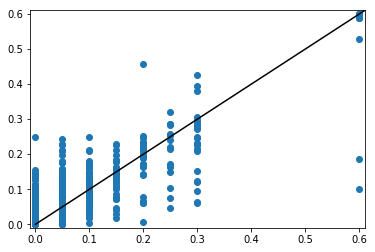

In [12]:
#create mock analysis plots in this cell

#mask = (fits_params_with_mock_photoz['best.universe.redshift_1']>0.1) & (fits_params_with_mock_photoz['best.universe.redshift_1']<0.2)

temp = fits_params_with_mock_photoz
x = temp['best.agn.fracAGN_1']
y = temp['bayes.agn.fracAGN_2']
plt.plot([0,1],[0,1],c='black')
plt.scatter(x,y)
plt.xlim(-0.01,max(x)+0.01)
plt.ylim(-0.01,max(y)+0.01)
plt.show()

In [13]:
colnames = fits_params_with_mock_photoz.colnames
for name in colnames:
    if '_err' in name:
        continue
    if ('bayes' in name) & ('_2' in name):
        y = fits_params_with_mock_chi2_photoz[name]
        xname = name.replace('bayes','best').replace('_2','_1')
        x = fits_params_with_mock_chi2_photoz[xname]
        plt.plot([min(x)/10,max(y)*10],[min(x)/10,max(y)*10],c='black')
        plt.scatter(x,y)
        plt.xlim(min(x)/2,max(x)+max(x)/10)
        plt.ylim(min(y)/2,max(y)+max(y)/10)
        plt.xlabel(xname)
        plt.ylabel(name)
        plt.show()

NameError: name 'fits_params_with_mock_chi2_photoz' is not defined

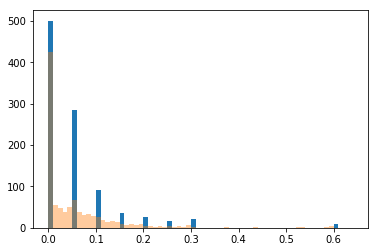

In [14]:
bins=np.arange(0,0.65,0.01)
y = fits_params_photoz['best.agn.fracAGN']
plt.hist(y,bins=bins)

y = fits_params_photoz['bayes.agn.fracAGN']
plt.hist(y,alpha=0.4,bins=bins)
plt.show()

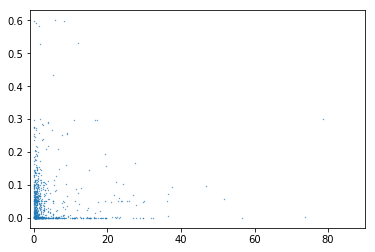

In [15]:
x = fits_params_photoz['ir_reduced_chi2']
y = fits_params_photoz['bayes.agn.fracAGN']
plt.scatter(x,y,s=0.1)
plt.xlim(-1,90)
plt.show()

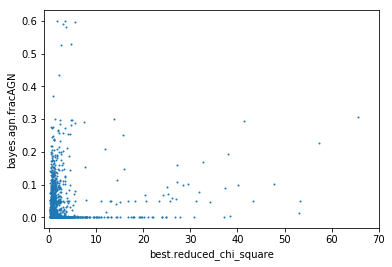

In [16]:
xname = 'best.reduced_chi_square'
yname = 'bayes.agn.fracAGN'
x = fits_params_photoz[xname]
y = fits_params_photoz[yname]
plt.scatter(x,y,s=1)
plt.xlabel(xname)
plt.ylabel(yname)
plt.xlim(-1,70)
plt.show()

In [17]:
xname = 'ir_reduced_chi2'
yname = 'opt_reduced_chi2'
x = fits_params_photoz[xname]
y = fits_params_chi2_photoz[yname]
plt.scatter(x,y,s=1)
plt.xlabel(xname)
plt.ylabel(yname)
plt.xlim(-1,70)
plt.show()

NameError: name 'fits_params_chi2_photoz' is not defined

In [18]:
mask = (fits_params_photoz['ir_reduced_chi2']>40) & (fits_params_photoz['bayes.agn.fracAGN']>0.0) & (fits_params_photoz['ir_reduced_chi2']<100)
print('number of sources that fit the criteria is: {}'.format(np.sum(mask)))
for id in fits_params_with_mock_chi2_photoz['id'][mask]:
    print(id)
    for folder in folder_list:
        if '_z_' not in folder:
            continue
        file = folder+'/out/{}_best_model.fits'.format(id)
        try:
            display_sed(file[:-16],_)
        except:()

number of sources that fit the criteria is: 5


NameError: name 'fits_params_with_mock_chi2_photoz' is not defined

In [19]:
bagpipes_fits = Table.read('data/bagpipes/matched_z1_bagpipes_magphys_chisq.fits')
bagpipes_fits.rename_column('lr_index_i','id')

In [20]:
cigale_bagpipes = join(fits_params_photoz,bagpipes_fits,join_type='inner',keys='id')

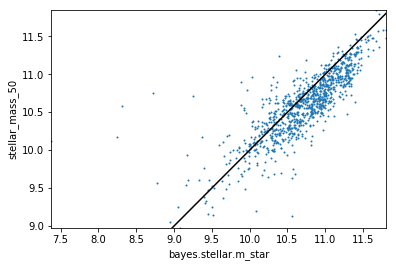

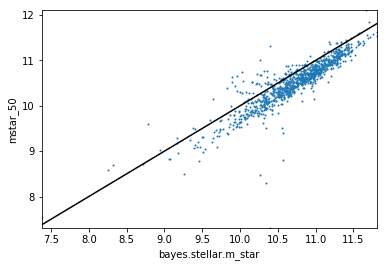

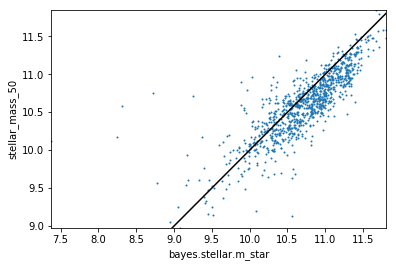

In [21]:
xname = 'bayes.stellar.m_star'
yname = 'stellar_mass_50'
x = np.log10(cigale_bagpipes[xname])
y = cigale_bagpipes[yname]
plt.scatter(x,y,s=1)
plt.xlabel(xname)
plt.ylabel(yname)
plt.xlim(np.min(x),np.max(x))
plt.ylim(np.min(y),np.max(y))
plt.plot([0,20],[0,20],c='black')
plt.show()

xname = 'bayes.stellar.m_star'
yname = 'mstar_50'
x = np.log10(cigale_bagpipes[xname])
y = cigale_bagpipes[yname]
plt.scatter(x,y,s=1)
plt.xlabel(xname)
plt.ylabel(yname)
plt.xlim(np.min(x),np.max(x))
plt.ylim(np.min(y),np.max(y))
plt.plot([0,20],[0,20],c='black')
plt.show()

xname = 'bayes.stellar.m_star'
yname = 'stellar_mass_50'
x = np.log10(cigale_bagpipes[xname])
y = cigale_bagpipes[yname]
plt.scatter(x,y,s=1)
plt.xlabel(xname)
plt.ylabel(yname)
plt.xlim(np.min(x),np.max(x))
plt.ylim(np.min(y),np.max(y))
plt.plot([0,20],[0,20],c='black')
plt.show()

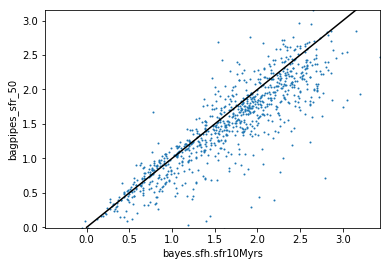

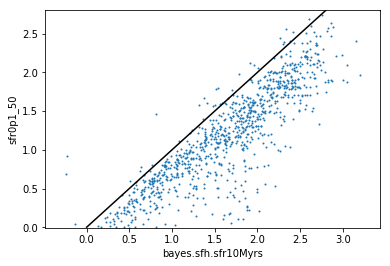

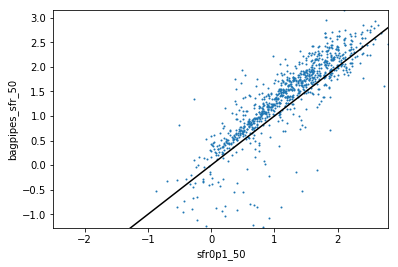

In [22]:
xname = 'bayes.sfh.sfr10Myrs'
yname = 'bagpipes_sfr_50'
x = np.log10(cigale_bagpipes[xname])
y = np.log10(cigale_bagpipes[yname])
plt.scatter(x,y,s=1)
plt.xlabel(xname)
plt.ylabel(yname)
plt.xlim(np.min(x),np.max(x))
plt.ylim(np.percentile(x,1),np.max(y))
plt.plot([0,20],[0,20],c='black')
plt.show()

xname = 'bayes.sfh.sfr10Myrs'
yname = 'sfr0p1_50'
x = np.log10(cigale_bagpipes[xname])
y = cigale_bagpipes[yname]
plt.scatter(x,y,s=1)
plt.xlabel(xname)
plt.ylabel(yname)
plt.xlim(np.min(x),np.max(x))
plt.ylim(np.percentile(x,1),np.max(y))
plt.plot([0,20],[0,20],c='black')
plt.show()

xname = 'sfr0p1_50'
yname = 'bagpipes_sfr_50'
x = cigale_bagpipes[xname]
y = np.log10(cigale_bagpipes[yname])
plt.scatter(x,y,s=1)
plt.xlabel(xname)
plt.ylabel(yname)
plt.xlim(np.min(x),np.max(x))
plt.ylim(np.percentile(x,1),np.max(y))
plt.plot([-20,20],[-20,20],c='black')
plt.show()

In [23]:
mask = (cigale_bagpipes['best.reduced_chi_square']>40) 
ids = cigale_bagpipes['id'][mask]
mask = np.in1d(cigale_bagpipes['id'],ids)
cigale_bagpipes[mask]

id,bayes.stellar.m_star,bayes.stellar.m_star_err,bayes.sfh.sfr10Myrs,bayes.sfh.sfr10Myrs_err,bayes.dust.luminosity,bayes.dust.luminosity_err,bayes.dust.mass,bayes.dust.mass_err,bayes.dust.qpah,bayes.dust.qpah_err,bayes.dust.umin,bayes.dust.umin_err,bayes.agn.fracAGN,bayes.agn.fracAGN_err,bayes.attenuation.Av_BC,bayes.attenuation.Av_BC_err,bayes.attenuation.bessell_b,bayes.attenuation.bessell_b_err,bayes.attenuation.galex_fuv,bayes.attenuation.galex_fuv_err,bayes.attenuation.slope_BC,bayes.attenuation.slope_BC_err,bayes.attenuation.BC_to_ISM_factor,bayes.attenuation.BC_to_ISM_factor_err,bayes.attenuation.slope_ISM,bayes.attenuation.slope_ISM_err,bayes.sfh.tau_main,bayes.sfh.tau_main_err,bayes.sfh.age,bayes.sfh.age_err,bayes.sfh.burst_age,bayes.sfh.burst_age_err,bayes.sfh.f_burst,bayes.sfh.f_burst_err,best.chi_square,best.reduced_chi_square,best.agn.agn_luminosity,best.agn.beta,best.agn.fracAGN,best.agn.gamma,best.agn.luminosity,best.agn.opening_angle,best.agn.psy,best.agn.r_ratio,best.agn.scatt_luminosity,best.agn.tau,best.agn.therm_luminosity,best.attenuation.Av_BC,best.attenuation.BC_to_ISM_factor,best.attenuation.bessell_b,best.attenuation.galex_fuv,best.attenuation.slope_BC,best.attenuation.slope_ISM,best.attenuation.stellar.old,best.attenuation.stellar.young,best.dust.alpha,best.dust.gamma,best.dust.luminosity,best.dust.mass,best.dust.qpah,best.dust.umin,best.lyc_absorption_f_dust,best.lyc_absorption_f_esc,best.sfh.age,best.sfh.burst_age,best.sfh.f_burst,best.sfh.integrated,best.sfh.sfr,best.sfh.sfr100Myrs,best.sfh.sfr10Myrs,best.sfh.tau_burst,best.sfh.tau_main,best.stellar.age_m_star,best.stellar.imf,best.stellar.lum_ly,best.stellar.lum_ly_old,best.stellar.lum_ly_young,best.stellar.m_gas,best.stellar.m_gas_old,best.stellar.m_gas_young,best.stellar.m_star,best.stellar.m_star_old,best.stellar.m_star_young,best.stellar.metallicity,best.stellar.n_ly,best.stellar.n_ly_old,best.stellar.n_ly_young,best.stellar.old_young_separation_age,best.universe.age,best.universe.luminosity_distance,best.universe.redshift,best.u,best.y,best.I,best.K,best.z,best.Bw,best.H,best.Ks,best.R,best.J,best.F250,best.F350,best.F500,best.z_Subaru,best.ch1,best.ch2,best.ch3,best.ch4,best.F24,opt_reduced_chi2,ir_reduced_chi2,ALPHA_J2000,DELTA_J2000,FLAG_DEEP,CLASS_STAR,FLAG_OPT_CONTAM,FLAG_MIPS_CONTAM_2,NUV_mag_2,NUV_magerr_2,NUV_flux_2,NUV_fluxerr_2,u_mag_2,u_magerr_2,u_flux_2,u_fluxerr_2,Bw_mag_2,Bw_magerr_2,Bw_flux_2,Bw_fluxerr_2,R_mag_2,R_magerr_2,R_flux_2,R_fluxerr_2,I_mag_2,I_magerr_2,I_flux_2,I_fluxerr_2,z_mag_2,z_magerr_2,z_flux_2,z_fluxerr_2,z_Subaru_mag_2,z_Subaru_magerr_2,z_Subaru_flux_2,z_Subaru_fluxerr_2,y_mag_2,y_magerr_2,y_flux_2,y_fluxerr_2,J_mag_2,J_magerr_2,J_flux_2,J_fluxerr_2,H_mag_2,H_magerr_2,H_flux_2,H_fluxerr_2,K_mag_2,K_magerr_2,K_flux_2,K_fluxerr_2,Ks_mag_2,Ks_magerr_2,Ks_flux_2,Ks_fluxerr_2,ch1_mag_2,ch1_magerr_2,ch1_flux_2,ch1_fluxerr_2,ch2_mag_2,ch2_magerr_2,ch2_flux_2,ch2_fluxerr_2,ch3_mag_2,ch3_magerr_2,ch3_flux_2,ch3_fluxerr_2,ch4_mag_2,ch4_magerr_2,ch4_flux_2,ch4_fluxerr_2,24_mag_2,24_magerr_2,24_flux_2,24_fluxerr_2,FLAG_MIPS_CONTAM_3,NUV_mag_3,NUV_magerr_3,NUV_flux_3,NUV_fluxerr_3,u_mag_3,u_magerr_3,u_flux_3,u_fluxerr_3,Bw_mag_3,Bw_magerr_3,Bw_flux_3,Bw_fluxerr_3,R_mag_3,R_magerr_3,R_flux_3,R_fluxerr_3,I_mag_3,I_magerr_3,I_flux_3,I_fluxerr_3,z_mag_3,z_magerr_3,z_flux_3,z_fluxerr_3,z_Subaru_mag_3,z_Subaru_magerr_3,z_Subaru_flux_3,z_Subaru_fluxerr_3,y_mag_3,y_magerr_3,y_flux_3,y_fluxerr_3,J_mag_3,J_magerr_3,J_flux_3,J_fluxerr_3,H_mag_3,H_magerr_3,H_flux_3,H_fluxerr_3,K_mag_3,K_magerr_3,K_flux_3,K_fluxerr_3,Ks_mag_3,Ks_magerr_3,Ks_flux_3,Ks_fluxerr_3,ch1_mag_3,ch1_magerr_3,ch1_flux_3,ch1_fluxerr_3,ch2_mag_3,ch2_magerr_3,ch2_flux_3,ch2_fluxerr_3,ch3_mag_3,ch3_magerr_3,ch3_flux_3,ch3_fluxerr_3,ch4_mag_3,ch4_magerr_3,ch4_flux_3,ch4_fluxerr_3,24_mag_3,24_magerr_3,24_flux_3,24_fluxerr_3,FLAG_MIPS_CONTAM_4,NUV_mag_4,NUV_magerr_4,NUV_flux_4,NUV_fluxerr_4,u_mag_4,u_magerr_4,u_flux_4,u_fluxerr_4,Bw_mag_4,Bw_magerr_4,Bw_flux_4,Bw_flux

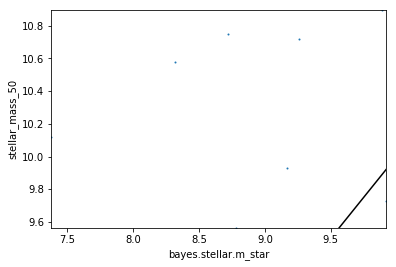

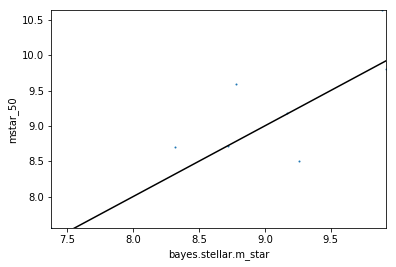

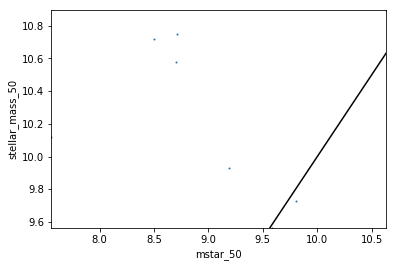

In [24]:
xname = 'bayes.stellar.m_star'
yname = 'stellar_mass_50'
x = np.log10(cigale_bagpipes[xname][mask])
y = cigale_bagpipes[yname][mask]
plt.scatter(x,y,s=1)
plt.xlabel(xname)
plt.ylabel(yname)
plt.xlim(np.min(x),np.max(x))
plt.ylim(np.min(y),np.max(y))
plt.plot([0,20],[0,20],c='black')
plt.show()

xname = 'bayes.stellar.m_star'
yname = 'mstar_50'
x = np.log10(cigale_bagpipes[xname][mask])
y = cigale_bagpipes[yname][mask]
plt.scatter(x,y,s=1)
plt.xlabel(xname)
plt.ylabel(yname)
plt.xlim(np.min(x),np.max(x))
plt.ylim(np.min(y),np.max(y))
plt.plot([0,20],[0,20],c='black')
plt.show()

xname = 'mstar_50'
yname = 'stellar_mass_50'
x = cigale_bagpipes[xname][mask]
y = cigale_bagpipes[yname][mask]
plt.scatter(x,y,s=1)
plt.xlabel(xname)
plt.ylabel(yname)
plt.xlim(np.min(x),np.max(x))
plt.ylim(np.min(y),np.max(y))
plt.plot([0,20],[0,20],c='black')
plt.show()



In [28]:
cigale_bagpipes[0]

id,bayes.stellar.m_star,bayes.stellar.m_star_err,bayes.sfh.sfr10Myrs,bayes.sfh.sfr10Myrs_err,bayes.dust.luminosity,bayes.dust.luminosity_err,bayes.dust.mass,bayes.dust.mass_err,bayes.dust.qpah,bayes.dust.qpah_err,bayes.dust.umin,bayes.dust.umin_err,bayes.agn.fracAGN,bayes.agn.fracAGN_err,bayes.attenuation.Av_BC,bayes.attenuation.Av_BC_err,bayes.attenuation.bessell_b,bayes.attenuation.bessell_b_err,bayes.attenuation.galex_fuv,bayes.attenuation.galex_fuv_err,bayes.attenuation.slope_BC,bayes.attenuation.slope_BC_err,bayes.attenuation.BC_to_ISM_factor,bayes.attenuation.BC_to_ISM_factor_err,bayes.attenuation.slope_ISM,bayes.attenuation.slope_ISM_err,bayes.sfh.tau_main,bayes.sfh.tau_main_err,bayes.sfh.age,bayes.sfh.age_err,bayes.sfh.burst_age,bayes.sfh.burst_age_err,bayes.sfh.f_burst,bayes.sfh.f_burst_err,best.chi_square,best.reduced_chi_square,best.agn.agn_luminosity,best.agn.beta,best.agn.fracAGN,best.agn.gamma,best.agn.luminosity,best.agn.opening_angle,best.agn.psy,best.agn.r_ratio,best.agn.scatt_luminosity,best.agn.tau,best.agn.therm_luminosity,best.attenuation.Av_BC,best.attenuation.BC_to_ISM_factor,best.attenuation.bessell_b,best.attenuation.galex_fuv,best.attenuation.slope_BC,best.attenuation.slope_ISM,best.attenuation.stellar.old,best.attenuation.stellar.young,best.dust.alpha,best.dust.gamma,best.dust.luminosity,best.dust.mass,best.dust.qpah,best.dust.umin,best.lyc_absorption_f_dust,best.lyc_absorption_f_esc,best.sfh.age,best.sfh.burst_age,best.sfh.f_burst,best.sfh.integrated,best.sfh.sfr,best.sfh.sfr100Myrs,best.sfh.sfr10Myrs,best.sfh.tau_burst,best.sfh.tau_main,best.stellar.age_m_star,best.stellar.imf,best.stellar.lum_ly,best.stellar.lum_ly_old,best.stellar.lum_ly_young,best.stellar.m_gas,best.stellar.m_gas_old,best.stellar.m_gas_young,best.stellar.m_star,best.stellar.m_star_old,best.stellar.m_star_young,best.stellar.metallicity,best.stellar.n_ly,best.stellar.n_ly_old,best.stellar.n_ly_young,best.stellar.old_young_separation_age,best.universe.age,best.universe.luminosity_distance,best.universe.redshift,best.u,best.y,best.I,best.K,best.z,best.Bw,best.H,best.Ks,best.R,best.J,best.F250,best.F350,best.F500,best.z_Subaru,best.ch1,best.ch2,best.ch3,best.ch4,best.F24,opt_reduced_chi2,ir_reduced_chi2,ALPHA_J2000,DELTA_J2000,FLAG_DEEP,CLASS_STAR,FLAG_OPT_CONTAM,FLAG_MIPS_CONTAM_2,NUV_mag_2,NUV_magerr_2,NUV_flux_2,NUV_fluxerr_2,u_mag_2,u_magerr_2,u_flux_2,u_fluxerr_2,Bw_mag_2,Bw_magerr_2,Bw_flux_2,Bw_fluxerr_2,R_mag_2,R_magerr_2,R_flux_2,R_fluxerr_2,I_mag_2,I_magerr_2,I_flux_2,I_fluxerr_2,z_mag_2,z_magerr_2,z_flux_2,z_fluxerr_2,z_Subaru_mag_2,z_Subaru_magerr_2,z_Subaru_flux_2,z_Subaru_fluxerr_2,y_mag_2,y_magerr_2,y_flux_2,y_fluxerr_2,J_mag_2,J_magerr_2,J_flux_2,J_fluxerr_2,H_mag_2,H_magerr_2,H_flux_2,H_fluxerr_2,K_mag_2,K_magerr_2,K_flux_2,K_fluxerr_2,Ks_mag_2,Ks_magerr_2,Ks_flux_2,Ks_fluxerr_2,ch1_mag_2,ch1_magerr_2,ch1_flux_2,ch1_fluxerr_2,ch2_mag_2,ch2_magerr_2,ch2_flux_2,ch2_fluxerr_2,ch3_mag_2,ch3_magerr_2,ch3_flux_2,ch3_fluxerr_2,ch4_mag_2,ch4_magerr_2,ch4_flux_2,ch4_fluxerr_2,24_mag_2,24_magerr_2,24_flux_2,24_fluxerr_2,FLAG_MIPS_CONTAM_3,NUV_mag_3,NUV_magerr_3,NUV_flux_3,NUV_fluxerr_3,u_mag_3,u_magerr_3,u_flux_3,u_fluxerr_3,Bw_mag_3,Bw_magerr_3,Bw_flux_3,Bw_fluxerr_3,R_mag_3,R_magerr_3,R_flux_3,R_fluxerr_3,I_mag_3,I_magerr_3,I_flux_3,I_fluxerr_3,z_mag_3,z_magerr_3,z_flux_3,z_fluxerr_3,z_Subaru_mag_3,z_Subaru_magerr_3,z_Subaru_flux_3,z_Subaru_fluxerr_3,y_mag_3,y_magerr_3,y_flux_3,y_fluxerr_3,J_mag_3,J_magerr_3,J_flux_3,J_fluxerr_3,H_mag_3,H_magerr_3,H_flux_3,H_fluxerr_3,K_mag_3,K_magerr_3,K_flux_3,K_fluxerr_3,Ks_mag_3,Ks_magerr_3,Ks_flux_3,Ks_fluxerr_3,ch1_mag_3,ch1_magerr_3,ch1_flux_3,ch1_fluxerr_3,ch2_mag_3,ch2_magerr_3,ch2_flux_3,ch2_fluxerr_3,ch3_mag_3,ch3_magerr_3,ch3_flux_3,ch3_fluxerr_3,ch4_mag_3,ch4_magerr_3,ch4_flux_3,ch4_fluxerr_3,24_mag_3,24_magerr_3,24_flux_3,24_fluxerr_3,FLAG_MIPS_CONTAM_4,NUV_mag_4,NUV_magerr_4,NUV_flux_4,NUV_fluxerr_4,u_mag_4,u_magerr_4,u_flux_4,u_fluxerr_4,Bw_mag_4,Bw_magerr_4,Bw_flux_4,Bw_flux

cigale agn fraction is: 0.0


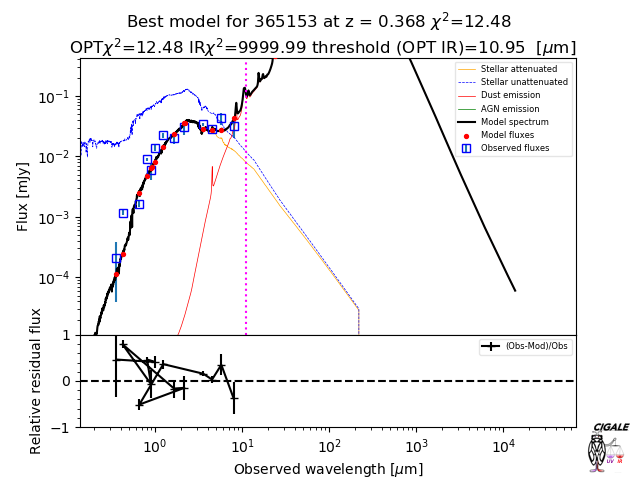

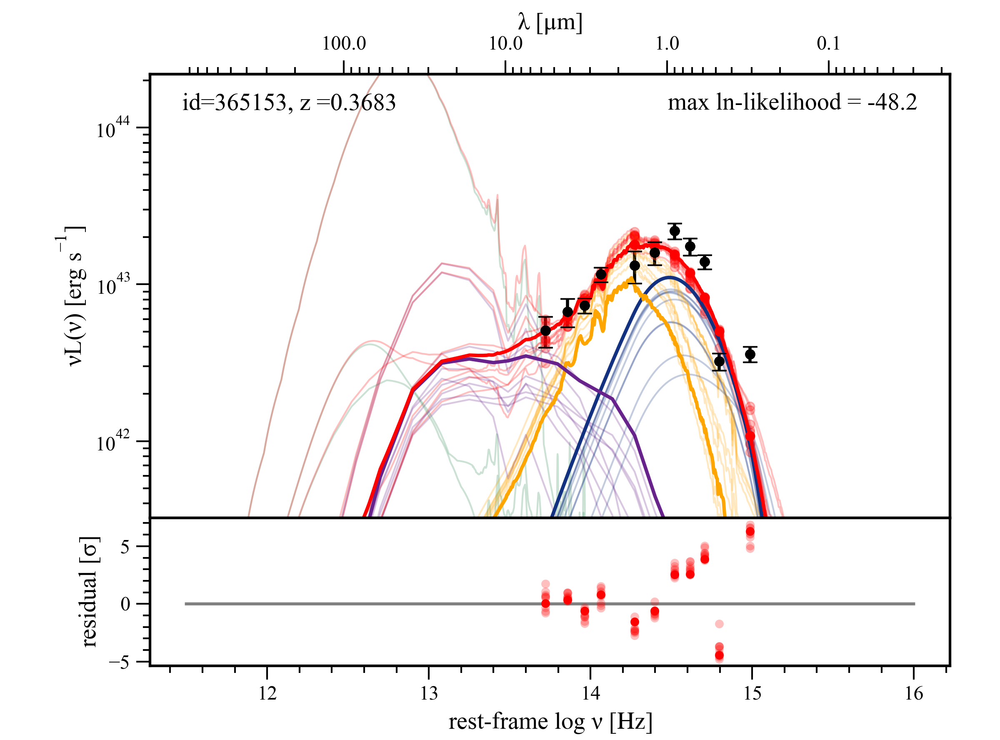

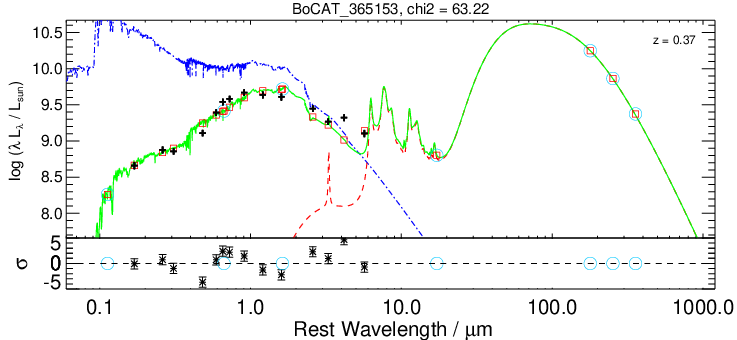

38
bigpipes reduced chi squared is: 23.579332638253554


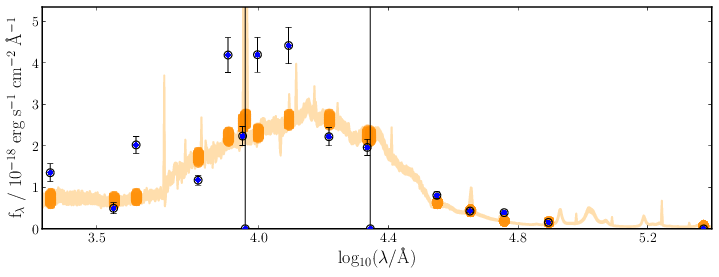

objects id is: 365153
column ALPHA_J2000 has a value of: 218.4126204 deg
column DELTA_J2000 has a value of: 33.1080323 deg
column CLASS_STAR has a value of: 1.0
column NUV has a value of: 0.00023245167732238768 uJy
column NUV_err has a value of: 3.723741322755814e-05 uJy
column u has a value of: 0.00020935185253620147 uJy
column u_err has a value of: 5.668014660477638e-05 uJy
column Bw has a value of: 0.0011787229776382446 uJy
column Bw_err has a value of: 3.351207077503204e-05 uJy
column R has a value of: 0.0016490631103515624 uJy
column R_err has a value of: 6.893566250801087e-05 uJy
column I has a value of: 0.009018853187561035 uJy
column I_err has a value of: 0.00018160071969032288 uJy
column z has a value of: 0.0059215822219848635 uJy
column z_err has a value of: 0.0006048058867454529 uJy
column z_Subaru has a value of: -0.099 uJy
column z_Subaru_err has a value of: -0.099 uJy
column y has a value of: 0.01373505973815918 uJy
column y_err has a value of: 0.0005608466267585754 uJy
c

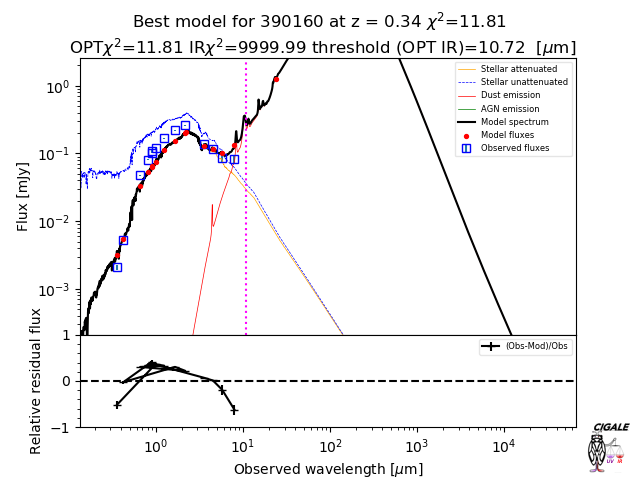

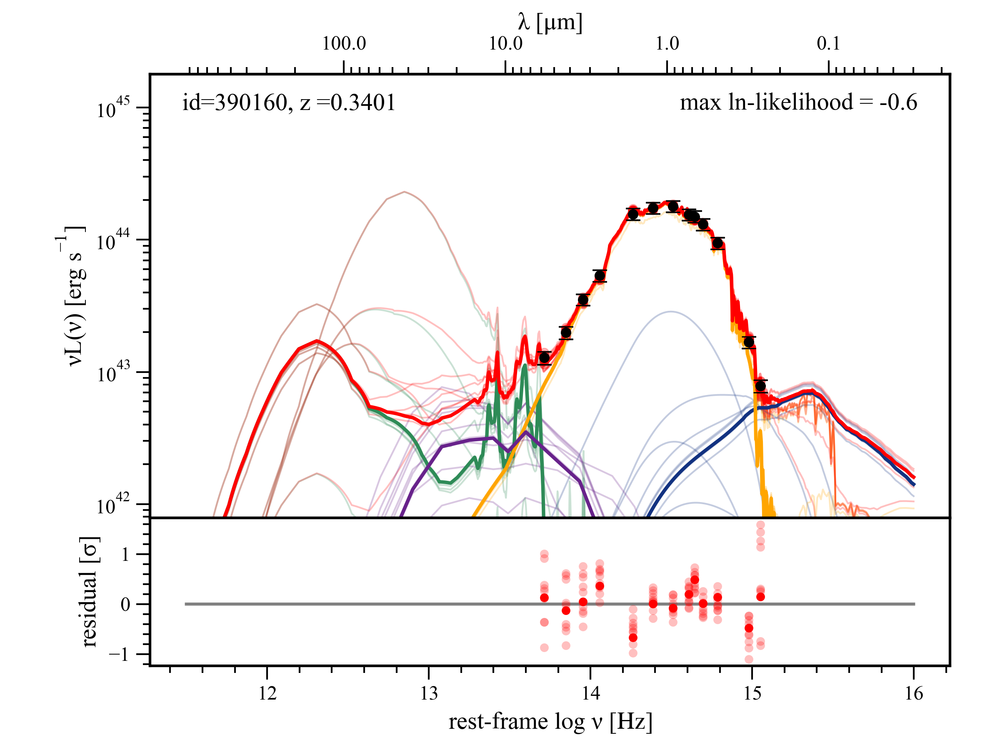

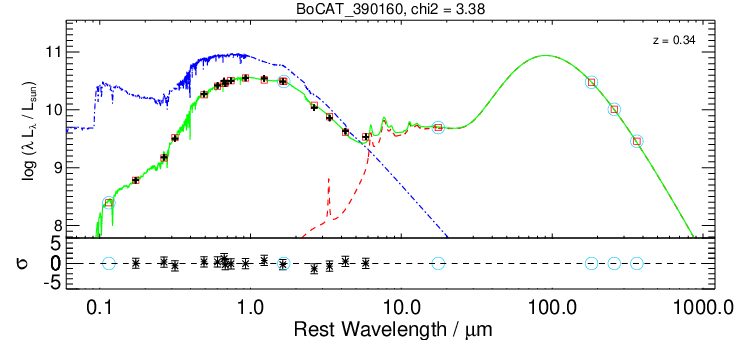

58
bigpipes reduced chi squared is: 0.7916648623271537


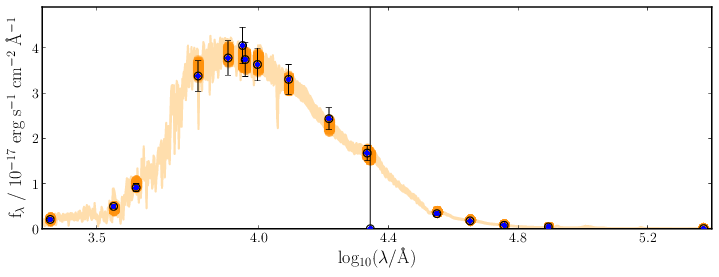

objects id is: 390160
column ALPHA_J2000 has a value of: 217.0943019 deg
column DELTA_J2000 has a value of: 33.1666204 deg
column CLASS_STAR has a value of: 0.029999999329447746
column NUV has a value of: 0.00035433369874954225 uJy
column NUV_err has a value of: 4.116993024945259e-05 uJy
column u has a value of: 0.0020954506397247315 uJy
column u_err has a value of: 6.098028272390366e-05 uJy
column Bw has a value of: 0.005302145957946778 uJy
column Bw_err has a value of: 5.738946422934532e-05 uJy
column R has a value of: 0.04753324127197266 uJy
column R_err has a value of: 0.00013329260051250457 uJy
column I has a value of: 0.0813188705444336 uJy
column I_err has a value of: 0.0002393258661031723 uJy
column z has a value of: 0.10733889770507812 uJy
column z_err has a value of: 0.0011305317878723144 uJy
column z_Subaru has a value of: 0.10282731628417968 uJy
column z_Subaru_err has a value of: 0.0002726887464523315 uJy
column y has a value of: 0.11888051605224609 uJy
column y_err has a 

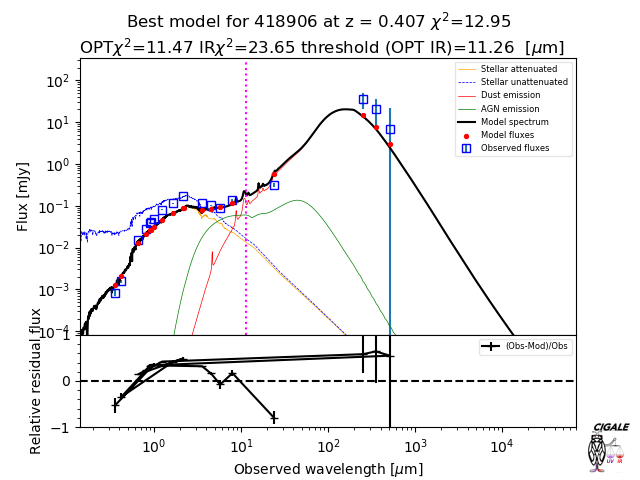

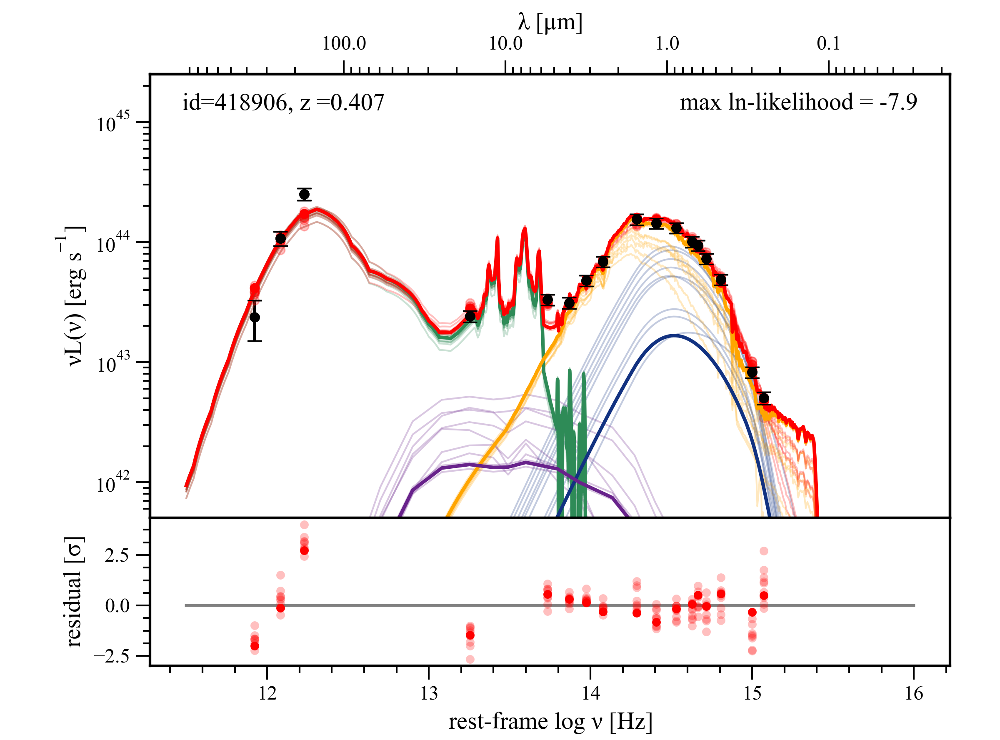

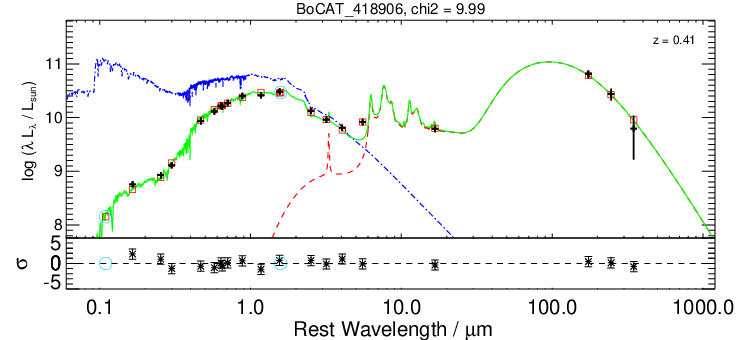

77
bigpipes reduced chi squared is: 1.3162587629345763


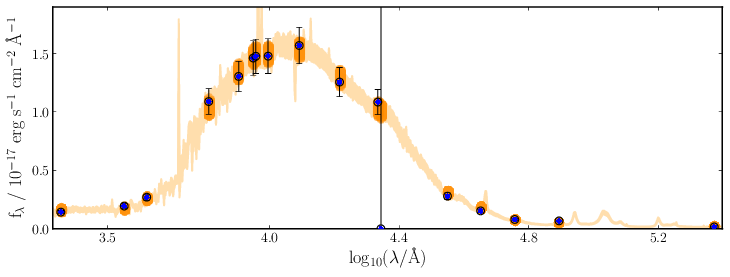

objects id is: 418906
column ALPHA_J2000 has a value of: 217.6662316 deg
column DELTA_J2000 has a value of: 33.2370852 deg
column CLASS_STAR has a value of: 0.029999999329447746
column NUV has a value of: 0.0002456137835979462 uJy
column NUV_err has a value of: 2.4052681401371955e-05 uJy
column u has a value of: 0.0008239808678627014 uJy
column u_err has a value of: 4.407047107815742e-05 uJy
column Bw has a value of: 0.0015775059461593628 uJy
column Bw_err has a value of: 3.780461847782135e-05 uJy
column R has a value of: 0.015330528259277344 uJy
column R_err has a value of: 8.285028487443925e-05 uJy
column I has a value of: 0.028087421417236327 uJy
column I_err has a value of: 0.00015404976904392242 uJy
column z has a value of: 0.03872551727294922 uJy
column z_err has a value of: 0.0004866942763328552 uJy
column z_Subaru has a value of: 0.040594642639160156 uJy
column z_Subaru_err has a value of: 0.0001473120003938675 uJy
column y has a value of: 0.04836716079711914 uJy
column y_err h

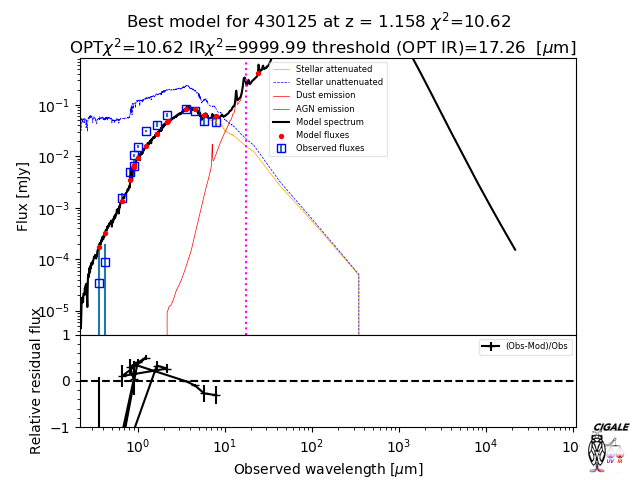

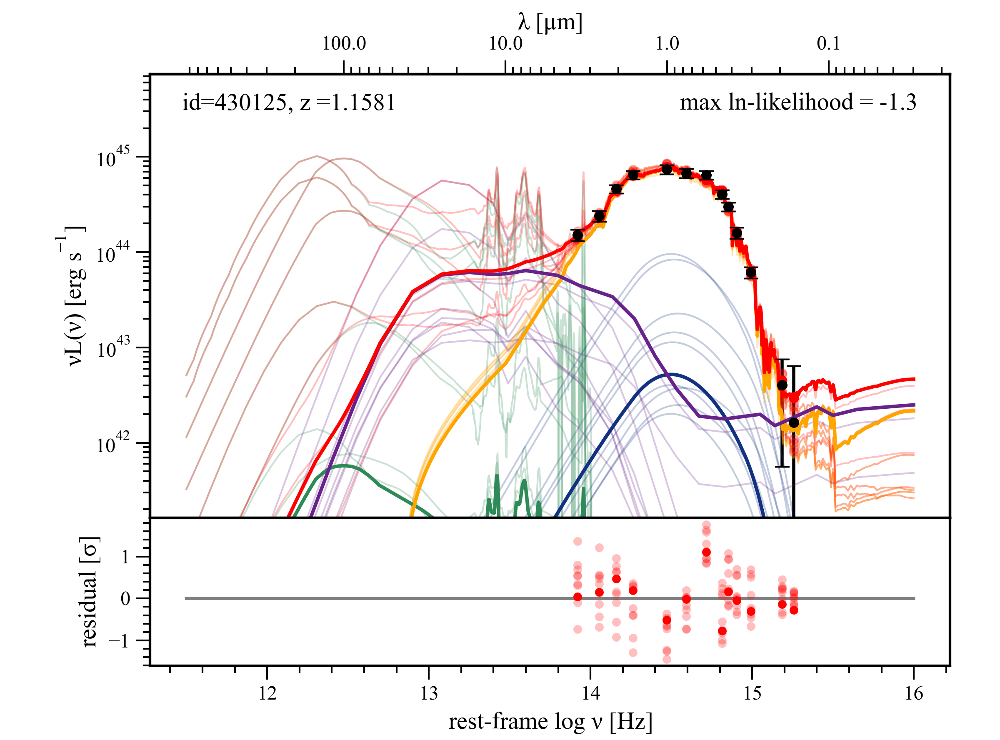

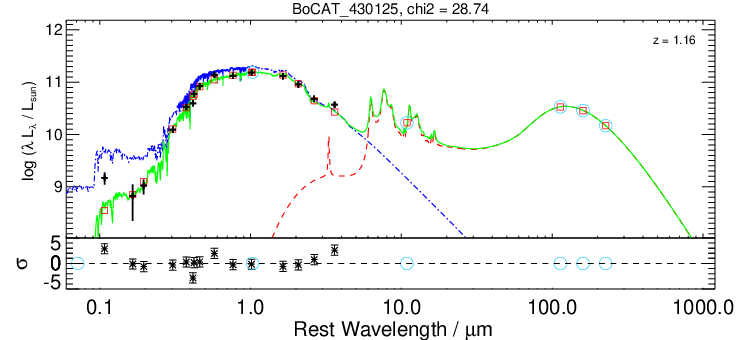

88
bigpipes reduced chi squared is: 2.5813423744074466


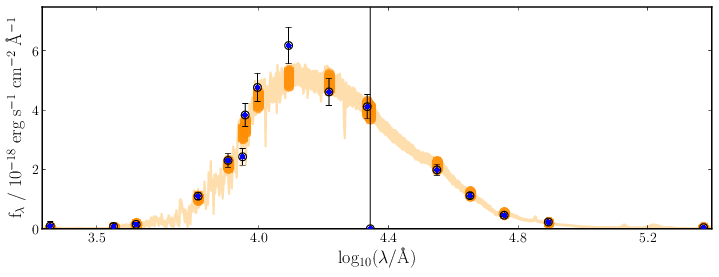

objects id is: 430125
column ALPHA_J2000 has a value of: 218.2428501 deg
column DELTA_J2000 has a value of: 33.2636442 deg
column CLASS_STAR has a value of: 0.03999999910593033
column NUV has a value of: 1.650943048298359e-05 uJy
column NUV_err has a value of: 2.6203477755188942e-05 uJy
column u has a value of: 3.39498408138752e-05 uJy
column u_err has a value of: 4.669688642024994e-05 uJy
column Bw has a value of: 8.671433478593827e-05 uJy
column Bw_err has a value of: 3.715916350483894e-05 uJy
column R has a value of: 0.001543110966682434 uJy
column R_err has a value of: 0.0001241883561015129 uJy
column I has a value of: 0.004955311775207519 uJy
column I_err has a value of: 0.00027017641067504883 uJy
column z has a value of: 0.006426246643066407 uJy
column z_err has a value of: 0.0007340864539146423 uJy
column z_Subaru has a value of: 0.010536808013916016 uJy
column z_Subaru_err has a value of: 0.0002381378561258316 uJy
column y has a value of: 0.01558082675933838 uJy
column y_err ha

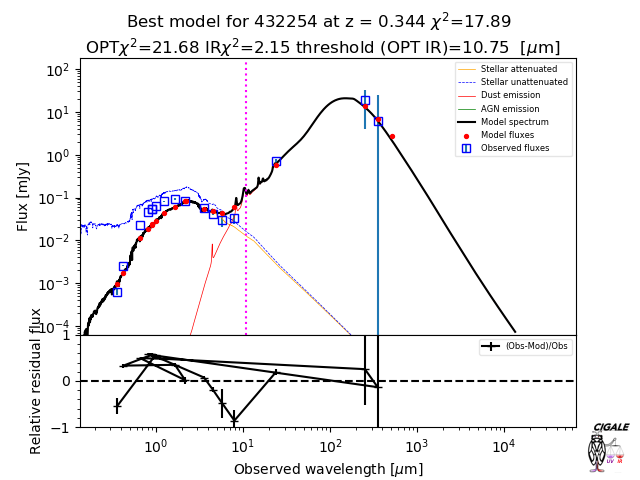

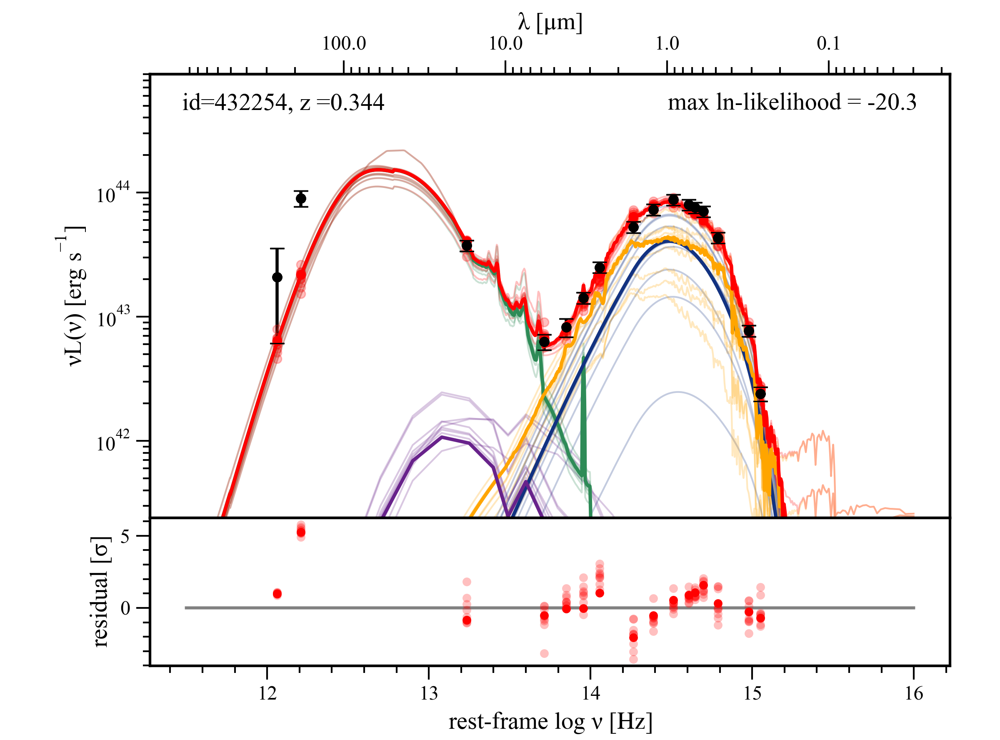

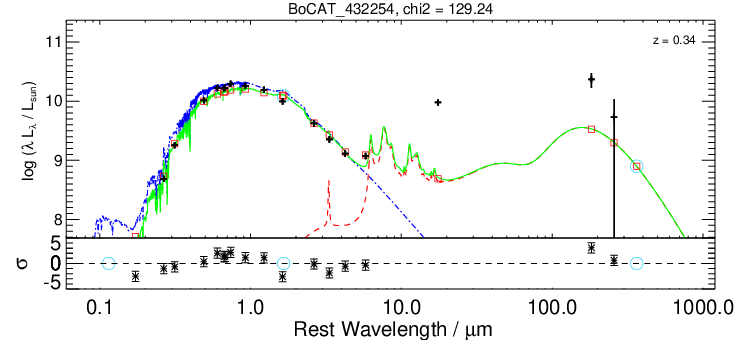

92
bigpipes reduced chi squared is: 7.554845081126996


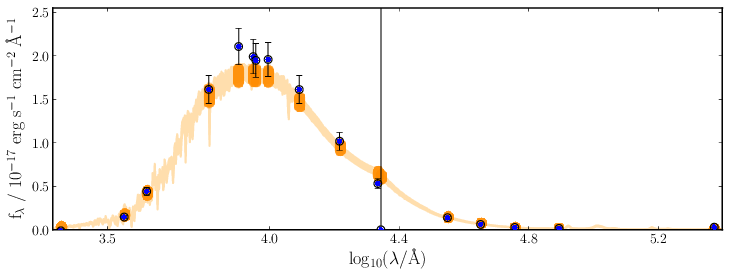

objects id is: 432254
column ALPHA_J2000 has a value of: 218.0922383 deg
column DELTA_J2000 has a value of: 33.2688007 deg
column CLASS_STAR has a value of: 0.8899999856948853
column NUV has a value of: -1.977391541004181e-05 uJy
column NUV_err has a value of: 3.701901063323021e-05 uJy
column u has a value of: 0.0006208077073097229 uJy
column u_err has a value of: 3.5249024629592895e-05 uJy
column Bw has a value of: 0.002573544263839722 uJy
column Bw_err has a value of: 3.681785985827446e-05 uJy
column R has a value of: 0.022702672958374023 uJy
column R_err has a value of: 7.733503729104996e-05 uJy
column I has a value of: 0.045364055633544925 uJy
column I_err has a value of: 0.00013362167775630952 uJy
column z has a value of: 0.052732353210449216 uJy
column z_err has a value of: 0.0006597082614898681 uJy
column z_Subaru has a value of: 0.053538829803466796 uJy
column z_Subaru_err has a value of: 0.0002849215269088745 uJy
column y has a value of: 0.06407231903076172 uJy
column y_err ha

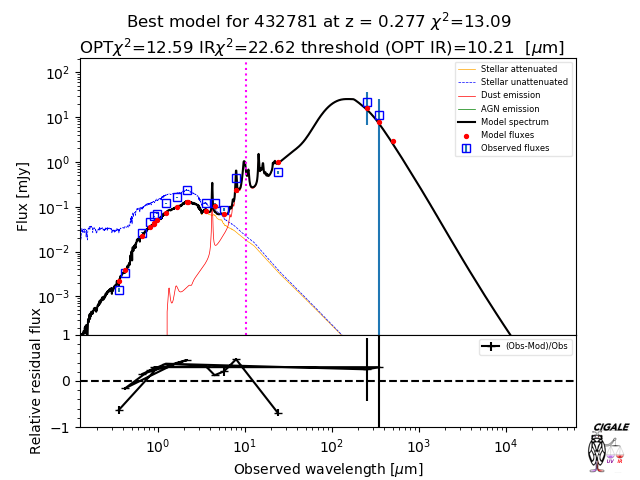

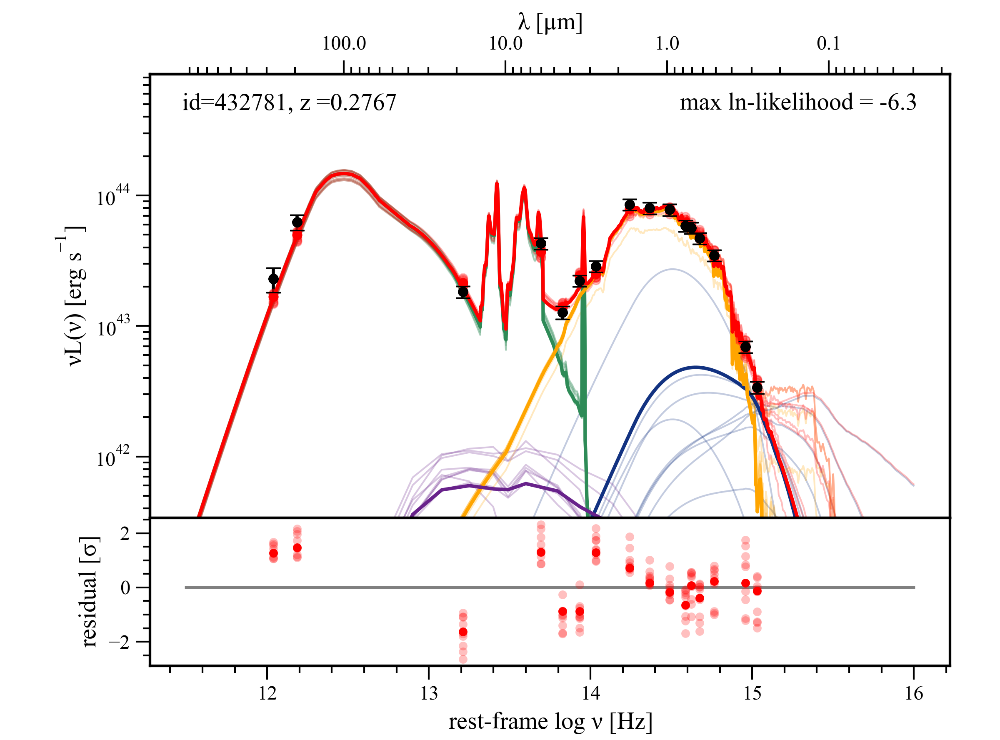

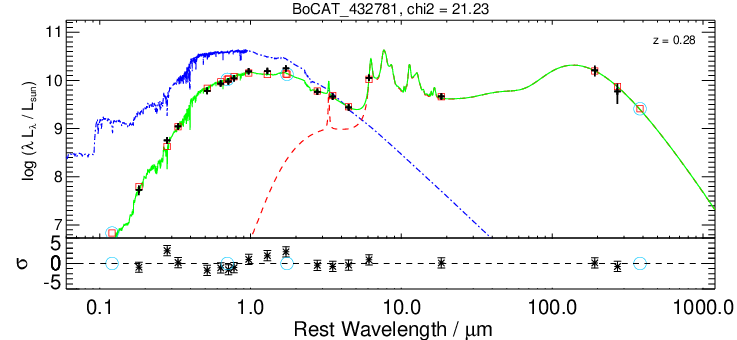

94
bigpipes reduced chi squared is: 5.324338147835021


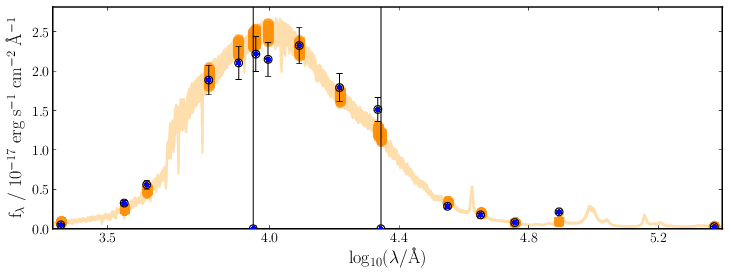

objects id is: 432781
column ALPHA_J2000 has a value of: 217.8020842 deg
column DELTA_J2000 has a value of: 33.2701359 deg
column CLASS_STAR has a value of: 0.029999999329447746
column NUV has a value of: 8.506149053573609e-05 uJy
column NUV_err has a value of: 3.0260032042860984e-05 uJy
column u has a value of: 0.0013817766904830934 uJy
column u_err has a value of: 3.923765942454338e-05 uJy
column Bw has a value of: 0.0032665636539459227 uJy
column Bw_err has a value of: 4.066546633839607e-05 uJy
column R has a value of: 0.026550750732421875 uJy
column R_err has a value of: 8.176714926958085e-05 uJy
column I has a value of: 0.045313922882080075 uJy
column I_err has a value of: 0.00012673088908195495 uJy
column z has a value of: -0.099 uJy
column z_err has a value of: -0.099 uJy
column z_Subaru has a value of: 0.06091843795776367 uJy
column z_Subaru_err has a value of: 0.00020308591425418853 uJy
column y has a value of: 0.07035756683349609 uJy
column y_err has a value of: 0.00039920476

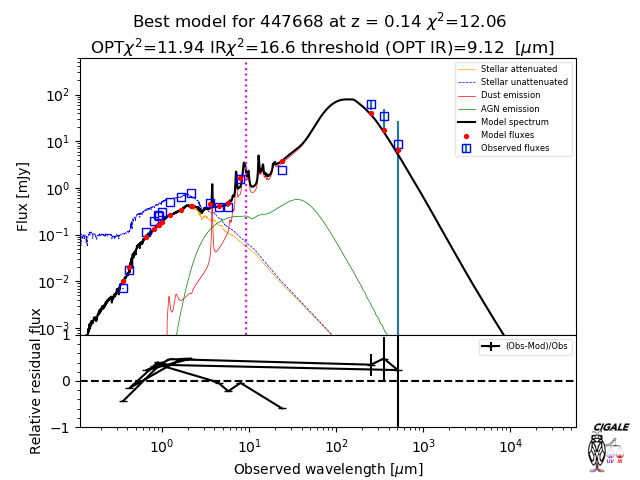

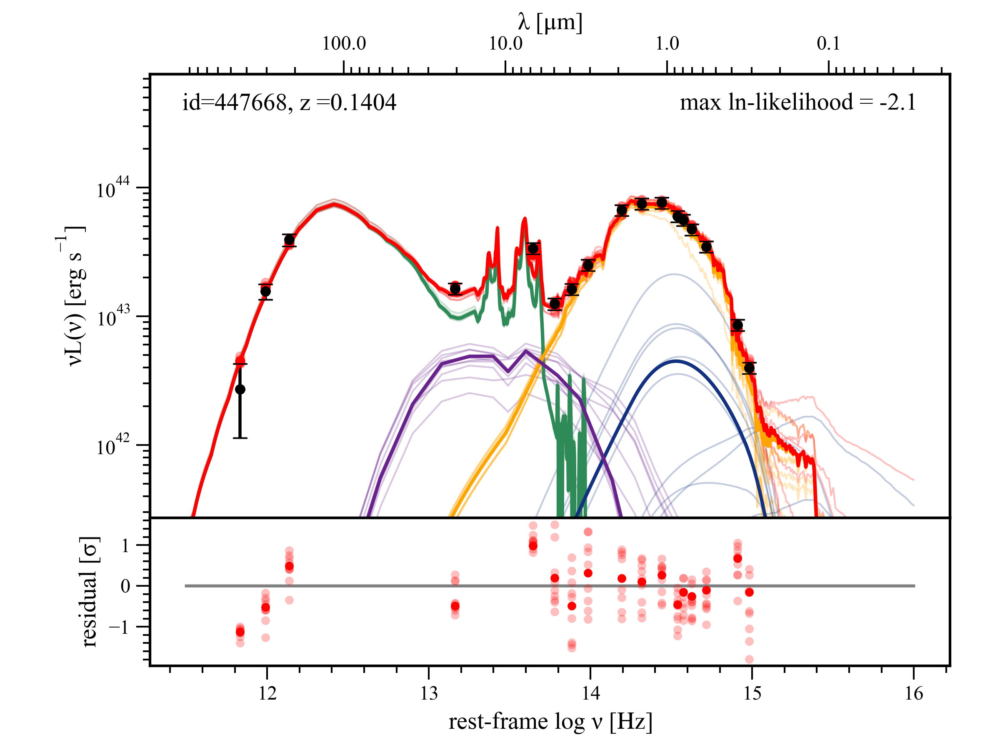

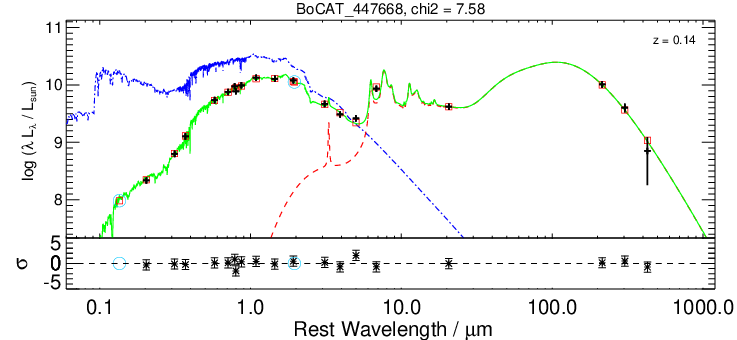

114
bigpipes reduced chi squared is: 1.5372912502993294


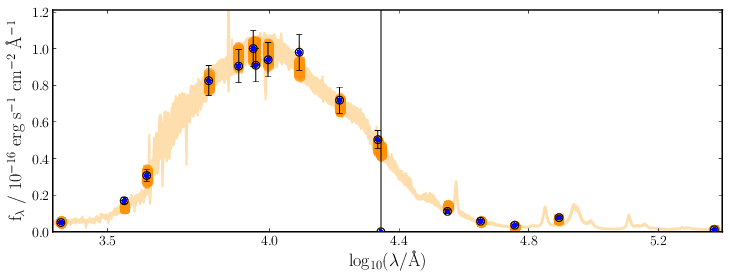

objects id is: 447668
column ALPHA_J2000 has a value of: 217.1834123 deg
column DELTA_J2000 has a value of: 33.3043208 deg
column CLASS_STAR has a value of: 0.029999999329447746
column NUV has a value of: 0.0008709889650344849 uJy
column NUV_err has a value of: 3.450066596269607e-05 uJy
column u has a value of: 0.0071759047508239745 uJy
column u_err has a value of: 6.723508983850479e-05 uJy
column Bw has a value of: 0.017921396255493164 uJy
column Bw_err has a value of: 5.2402425557374954e-05 uJy
column R has a value of: 0.11611204528808594 uJy
column R_err has a value of: 0.00014138147234916688 uJy
column I has a value of: 0.19476544189453124 uJy
column I_err has a value of: 0.00016901269555091858 uJy
column z has a value of: 0.26514132690429687 uJy
column z_err has a value of: 0.0006679799556732177 uJy
column z_Subaru has a value of: 0.24991319274902343 uJy
column z_Subaru_err has a value of: 0.0002387831211090088 uJy
column y has a value of: 0.3074328918457031 uJy
column y_err has a

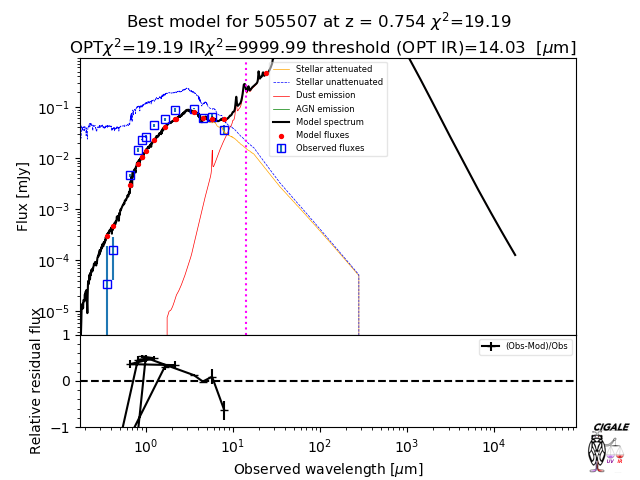

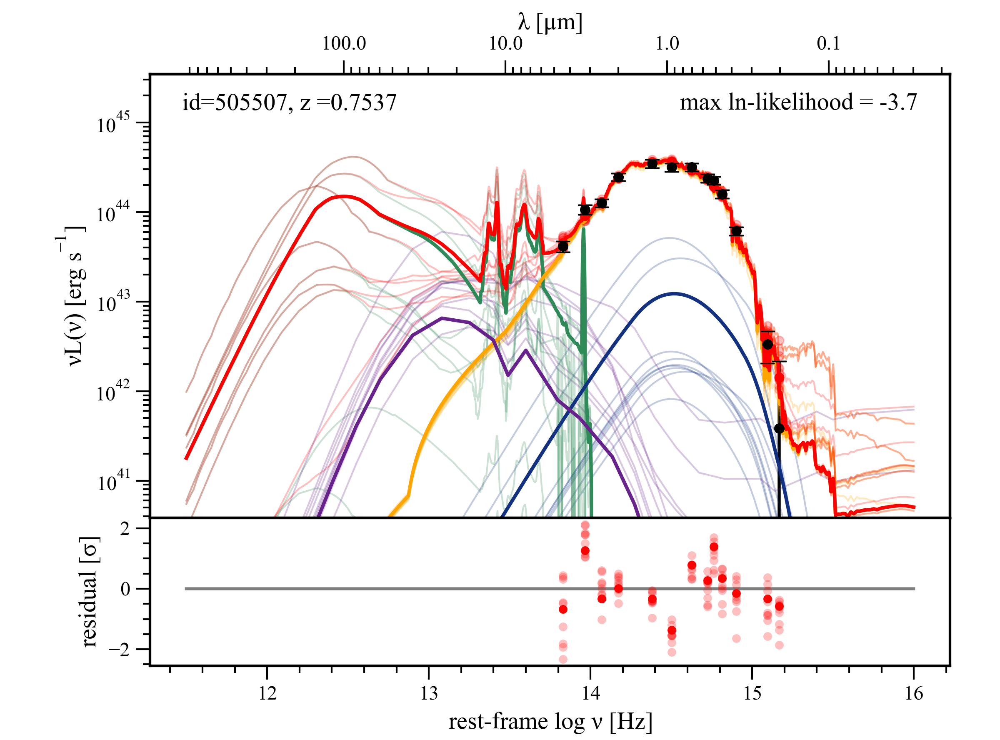

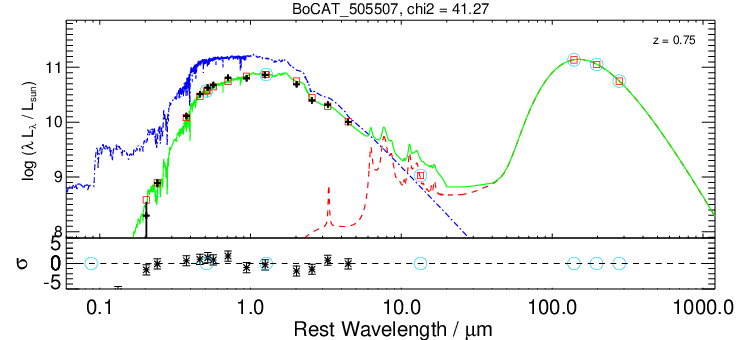

178
bigpipes reduced chi squared is: 2.3706485969901934


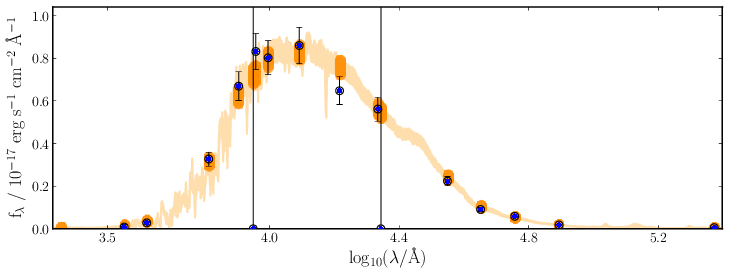

objects id is: 505507
column ALPHA_J2000 has a value of: 218.6700319 deg
column DELTA_J2000 has a value of: 33.4440115 deg
column CLASS_STAR has a value of: 0.029999999329447746
column NUV has a value of: -4.129839316010475e-05 uJy
column NUV_err has a value of: 2.3137452080845834e-05 uJy
column u has a value of: 3.453005477786064e-05 uJy
column u_err has a value of: 5.153629928827286e-05 uJy
column Bw has a value of: 0.00016187170147895813 uJy
column Bw_err has a value of: 4.059725254774094e-05 uJy
column R has a value of: 0.00460804557800293 uJy
column R_err has a value of: 0.00012483571469783784 uJy
column I has a value of: 0.014418214797973632 uJy
column I_err has a value of: 0.0004008381962776184 uJy
column z has a value of: -0.099 uJy
column z_err has a value of: -0.099 uJy
column z_Subaru has a value of: 0.022880664825439455 uJy
column z_Subaru_err has a value of: 0.00019693994522094725 uJy
column y has a value of: 0.02627790641784668 uJy
column y_err has a value of: 0.000652153

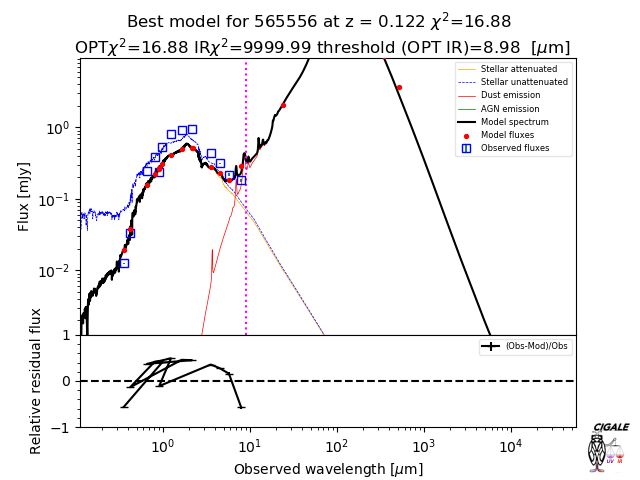

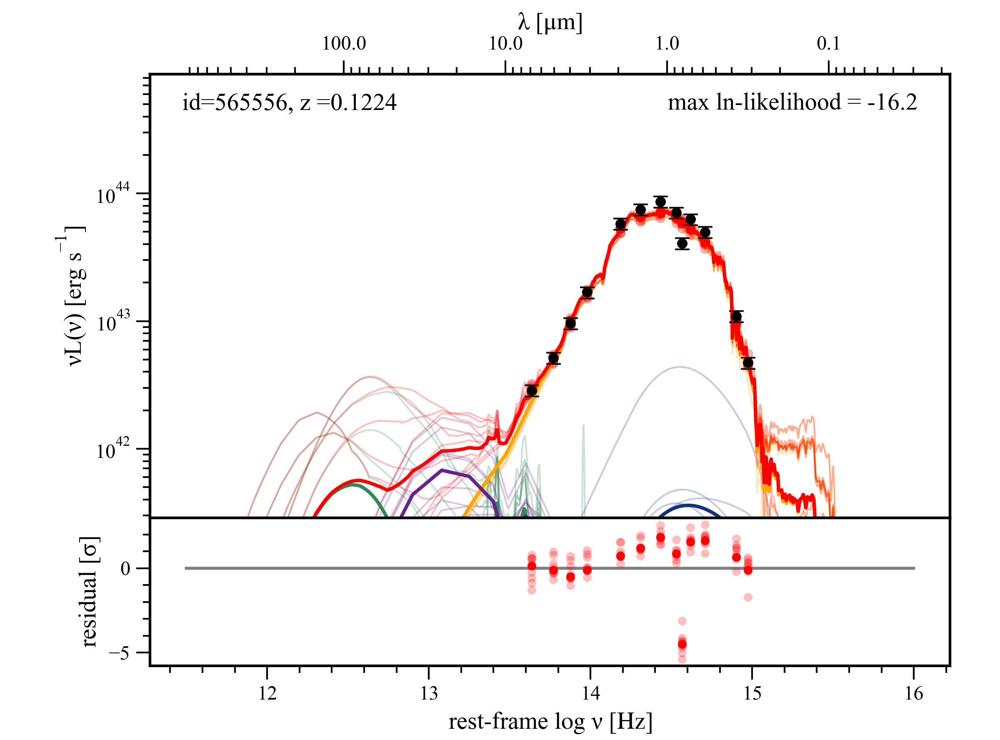

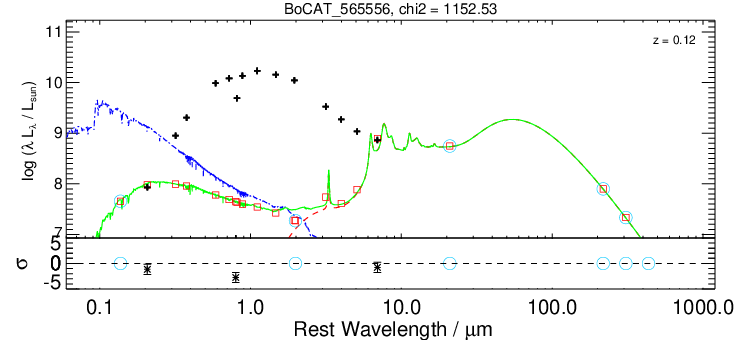

200
bigpipes reduced chi squared is: 132.05120821247877


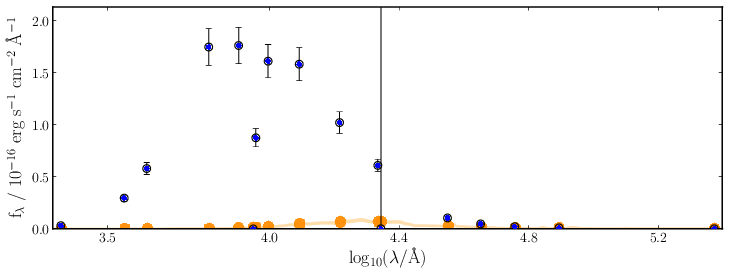

objects id is: 565556
column ALPHA_J2000 has a value of: 218.5335087 deg
column DELTA_J2000 has a value of: 33.5135055 deg
column CLASS_STAR has a value of: 0.029999999329447746
column NUV has a value of: 0.0005164322257041931 uJy
column NUV_err has a value of: 2.7245590463280677e-05 uJy
column u has a value of: 0.012482943534851075 uJy
column u_err has a value of: 5.1763985306024554e-05 uJy
column Bw has a value of: 0.03373276519775391 uJy
column Bw_err has a value of: 5.566950142383575e-05 uJy
column R has a value of: 0.24562757873535157 uJy
column R_err has a value of: 8.531492948532104e-05 uJy
column I has a value of: 0.3789588317871094 uJy
column I_err has a value of: 0.00017944341897964478 uJy
column z has a value of: -0.00039069479703903197 uJy
column z_err has a value of: 0.0007010719776153564 uJy
column z_Subaru has a value of: 0.24018679809570312 uJy
column z_Subaru_err has a value of: 0.00020436866581439973 uJy
column y has a value of: 0.5267327880859375 uJy
column y_err has

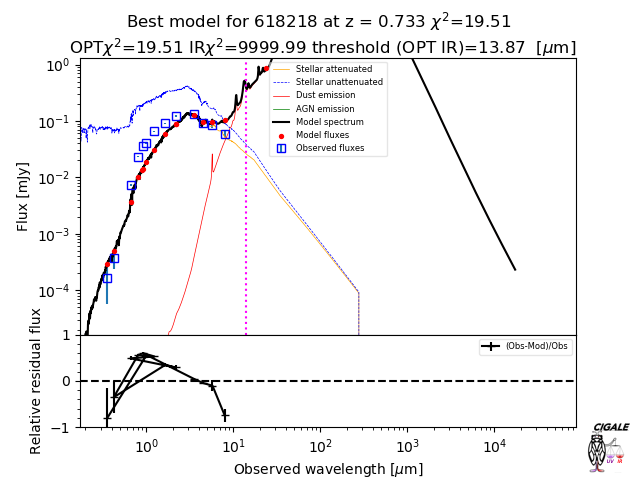

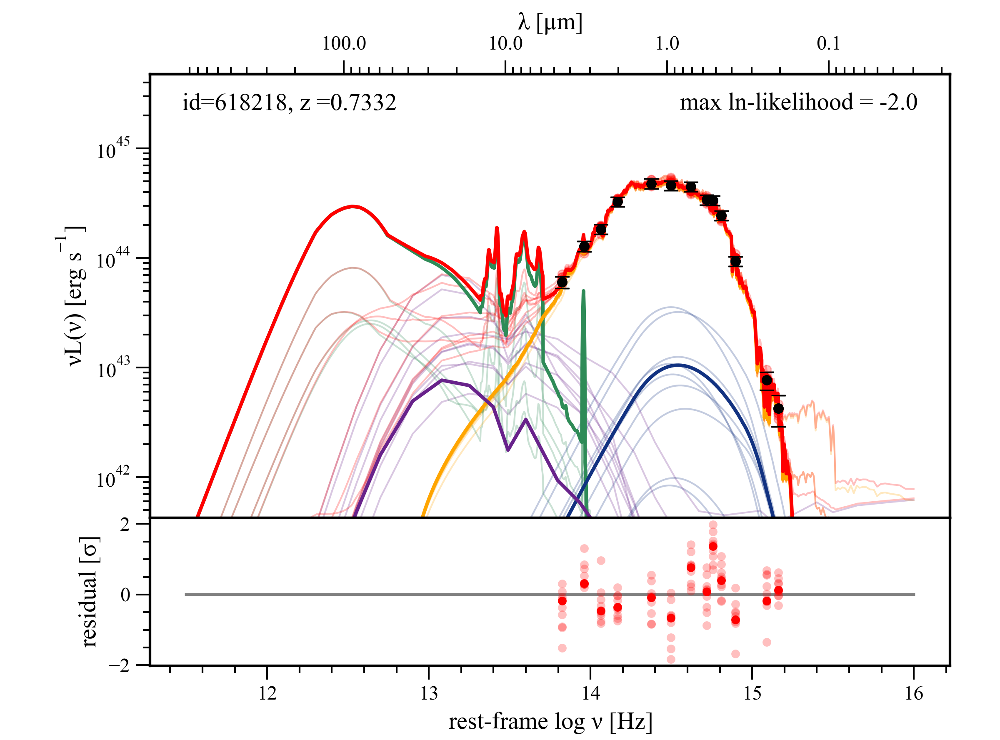

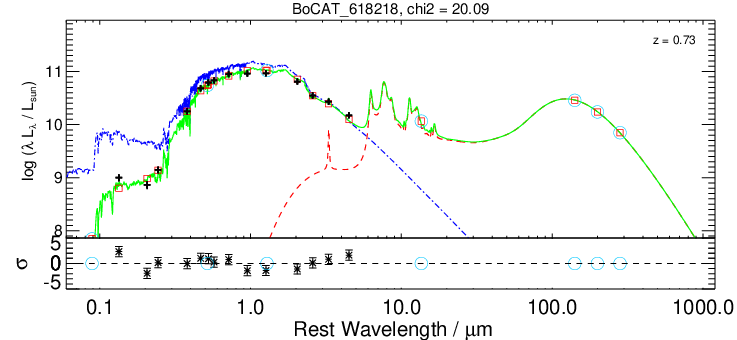

232
bigpipes reduced chi squared is: 2.4264997835431026


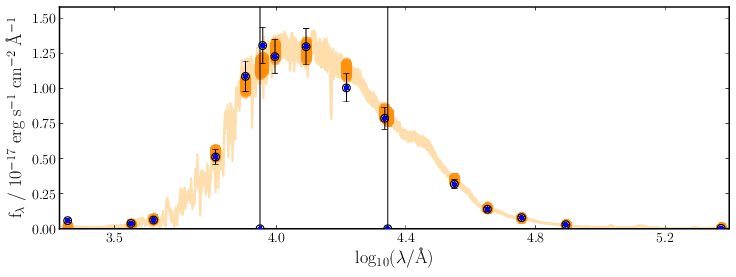

objects id is: 618218
column ALPHA_J2000 has a value of: 217.7740264 deg
column DELTA_J2000 has a value of: 33.5906562 deg
column CLASS_STAR has a value of: 0.029999999329447746
column NUV has a value of: 9.972690790891648e-05 uJy
column NUV_err has a value of: 2.8494004160165788e-05 uJy
column u has a value of: 0.00016127142310142517 uJy
column u_err has a value of: 3.4984543919563296e-05 uJy
column Bw has a value of: 0.0003637236952781677 uJy
column Bw_err has a value of: 4.154517501592636e-05 uJy
column R has a value of: 0.007193118095397949 uJy
column R_err has a value of: 9.878934919834136e-05 uJy
column I has a value of: 0.023359947204589844 uJy
column I_err has a value of: 0.00018089799582958222 uJy
column z has a value of: -0.099 uJy
column z_err has a value of: -0.099 uJy
column z_Subaru has a value of: 0.035851669311523435 uJy
column z_Subaru_err has a value of: 0.00016271981596946715 uJy
column y has a value of: 0.040107933044433594 uJy
column y_err has a value of: 0.0004123

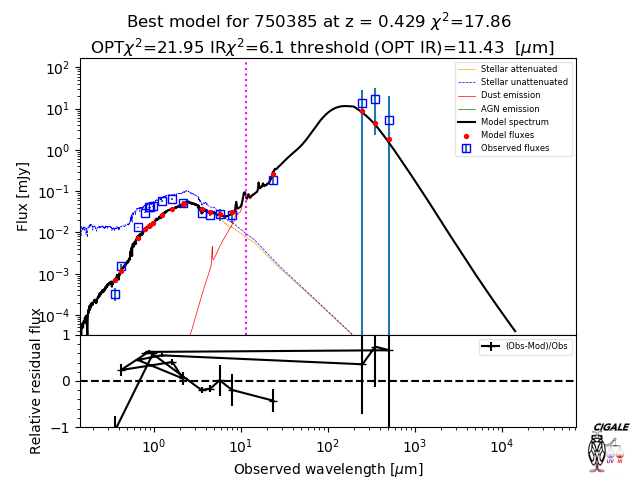

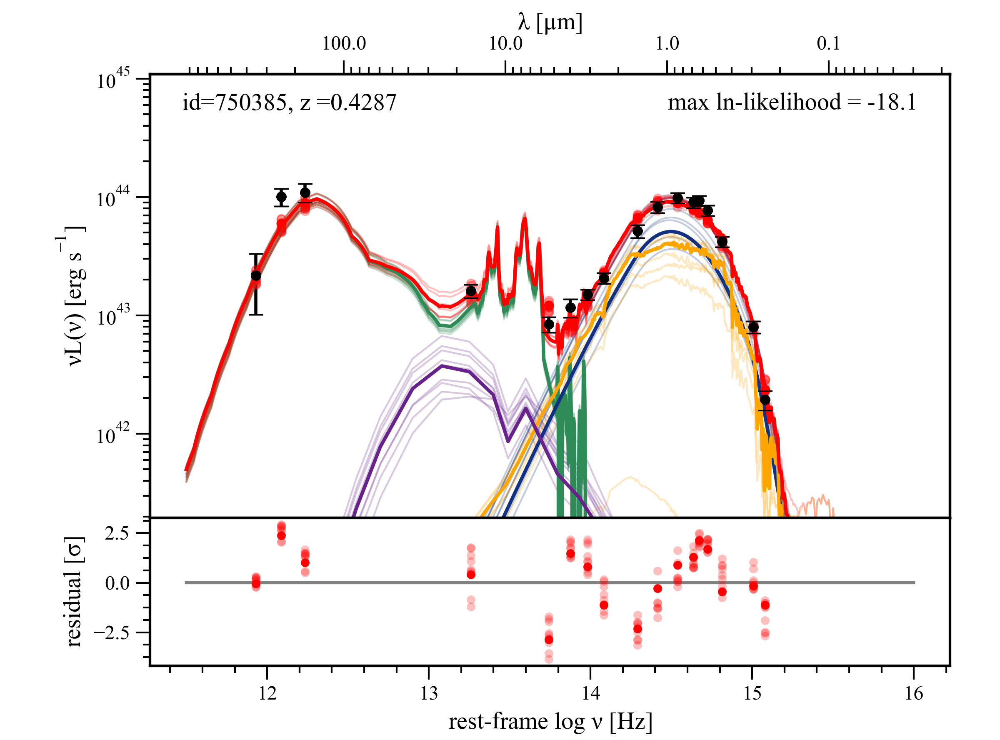

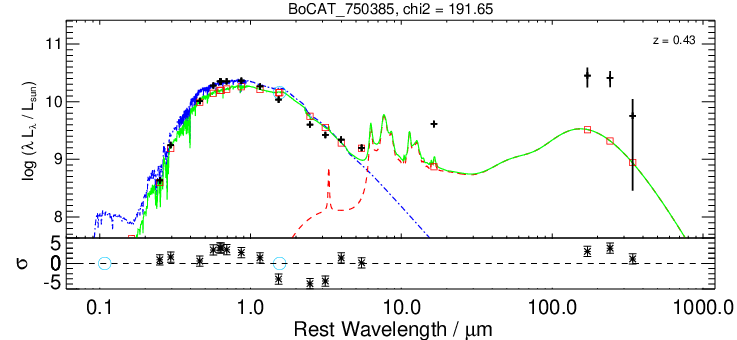

330
bigpipes reduced chi squared is: 10.081133923840591


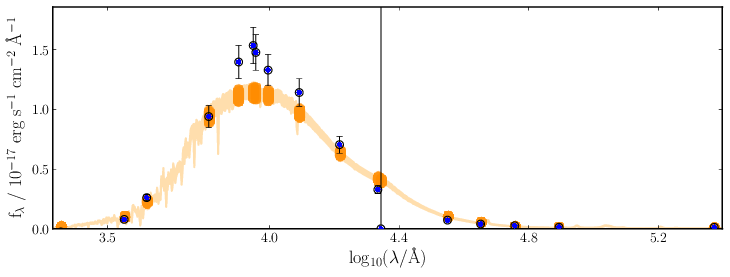

objects id is: 750385
column ALPHA_J2000 has a value of: 217.8549581 deg
column DELTA_J2000 has a value of: 33.7921783 deg
column CLASS_STAR has a value of: 0.9300000071525574
column NUV has a value of: -4.591691493988037e-05 uJy
column NUV_err has a value of: 2.3045625537633896e-05 uJy
column u has a value of: 0.0003318621516227722 uJy
column u_err has a value of: 3.6667879670858386e-05 uJy
column Bw has a value of: 0.0015205868482589722 uJy
column Bw_err has a value of: 6.534574925899506e-05 uJy
column R has a value of: 0.01322506332397461 uJy
column R_err has a value of: 0.00011172910779714584 uJy
column I has a value of: 0.030065744400024415 uJy
column I_err has a value of: 0.00030721190571784973 uJy
column z has a value of: 0.04065156173706055 uJy
column z_err has a value of: 0.0004751390814781189 uJy
column z_Subaru has a value of: 0.04058345794677734 uJy
column z_Subaru_err has a value of: 0.0002142561674118042 uJy
column y has a value of: 0.04347806549072265 uJy
column y_err ha

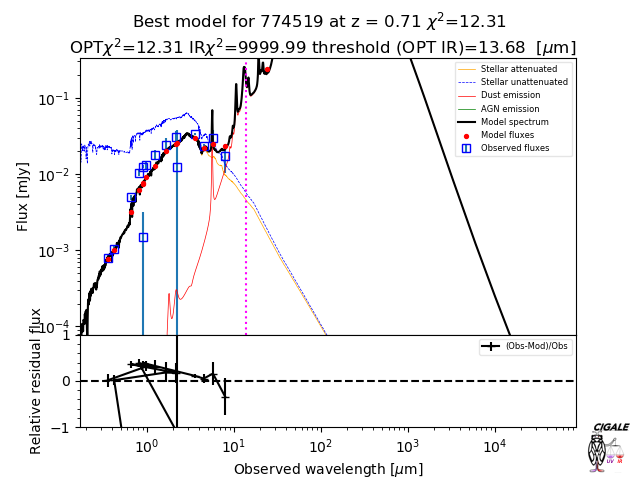

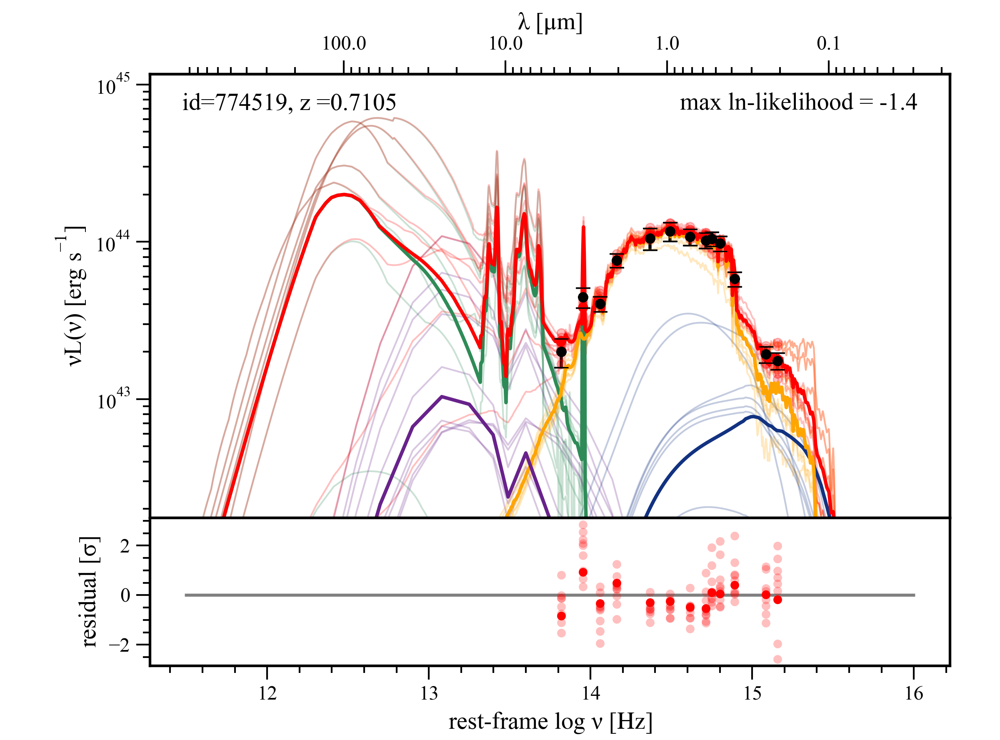

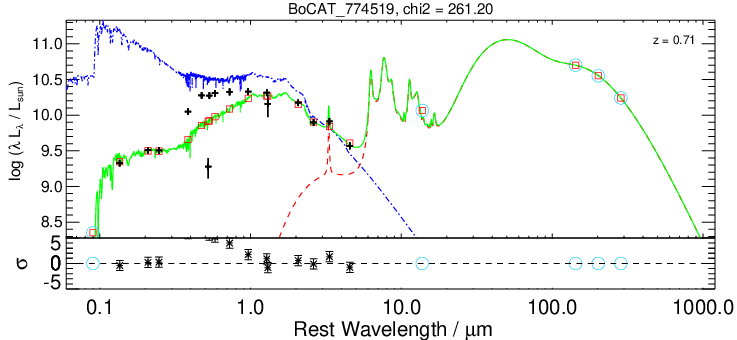

349
bigpipes reduced chi squared is: 18.585104369376655


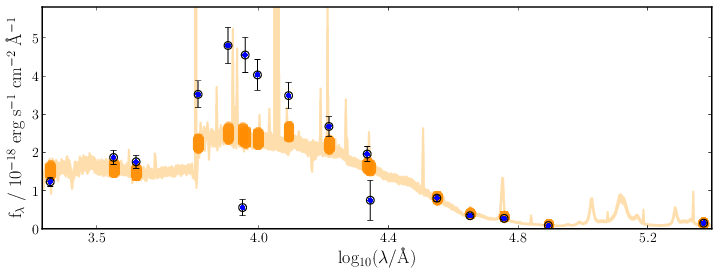

objects id is: 774519
column ALPHA_J2000 has a value of: 217.587768 deg
column DELTA_J2000 has a value of: 33.8288544 deg
column CLASS_STAR has a value of: 0.029999999329447746
column NUV has a value of: 0.00021135514974594116 uJy
column NUV_err has a value of: 2.040758542716503e-05 uJy
column u has a value of: 0.0007910373210906983 uJy
column u_err has a value of: 3.6663465201854704e-05 uJy
column Bw has a value of: 0.001022755742073059 uJy
column Bw_err has a value of: 3.7992689758539197e-05 uJy
column R has a value of: 0.0049558343887329106 uJy
column R_err has a value of: 0.0001276252418756485 uJy
column I has a value of: 0.010337884902954102 uJy
column I_err has a value of: 0.0003059526979923248 uJy
column z has a value of: 0.0014725744724273682 uJy
column z_err has a value of: 0.0005722279548645019 uJy
column z_Subaru has a value of: 0.012513777732849122 uJy
column z_Subaru_err has a value of: 0.00019208446145057678 uJy
column y has a value of: 0.01319321346282959 uJy
column y_er

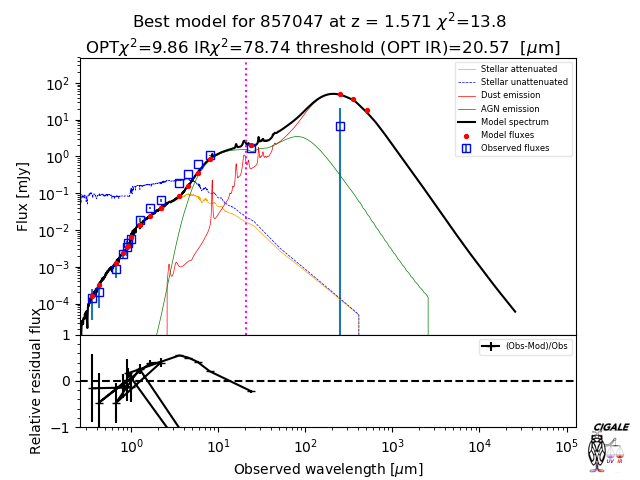

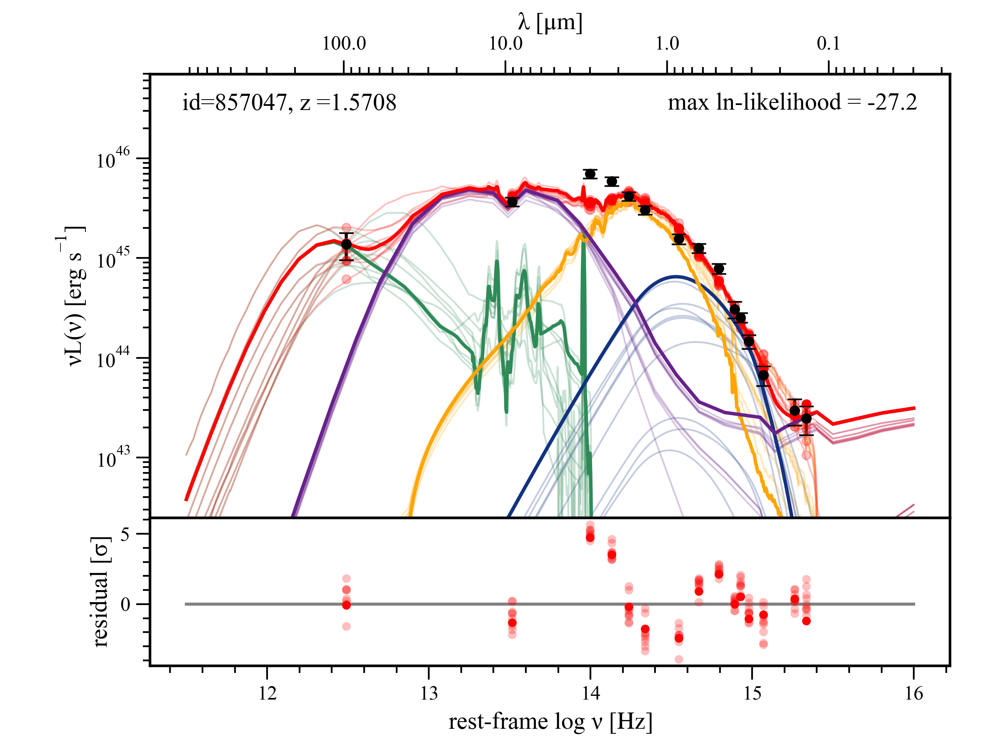

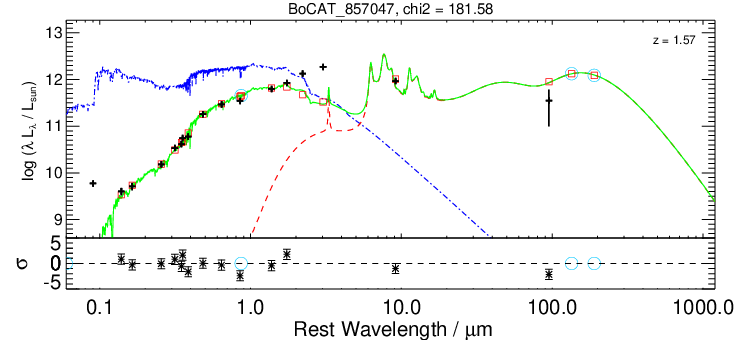

423
bigpipes reduced chi squared is: 7.982686125885769


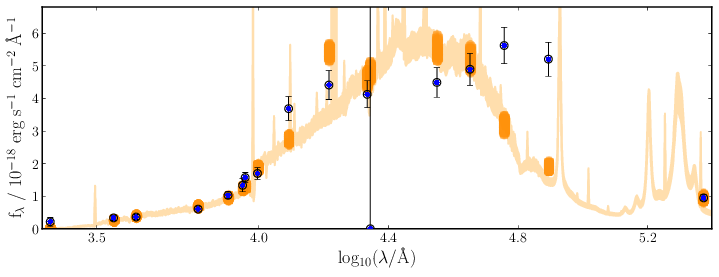

objects id is: 857047
column ALPHA_J2000 has a value of: 218.5014469 deg
column DELTA_J2000 has a value of: 33.9538825 deg
column CLASS_STAR has a value of: 0.18000000715255737
column NUV has a value of: 3.699073940515518e-05 uJy
column NUV_err has a value of: 2.292194217443466e-05 uJy
column u has a value of: 0.00014125293493270875 uJy
column u_err has a value of: 3.484320640563965e-05 uJy
column Bw has a value of: 0.00021079105138778687 uJy
column Bw_err has a value of: 4.58124428987503e-05 uJy
column R has a value of: 0.0008512895107269287 uJy
column R_err has a value of: 0.00012274909019470214 uJy
column I has a value of: 0.0022112197875976563 uJy
column I_err has a value of: 0.00019479522109031678 uJy
column z has a value of: 0.0035334384441375734 uJy
column z_err has a value of: 0.0005320825576782226 uJy
column z_Subaru has a value of: 0.004323835849761963 uJy
column z_Subaru_err has a value of: 0.00015461231768131256 uJy
column y has a value of: 0.005557890892028809 uJy
column y

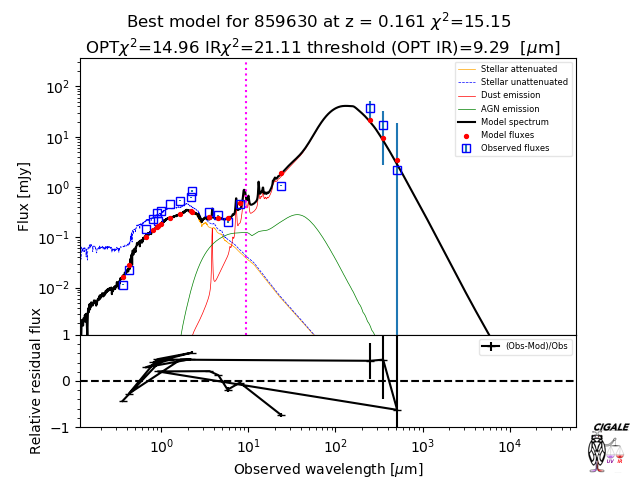

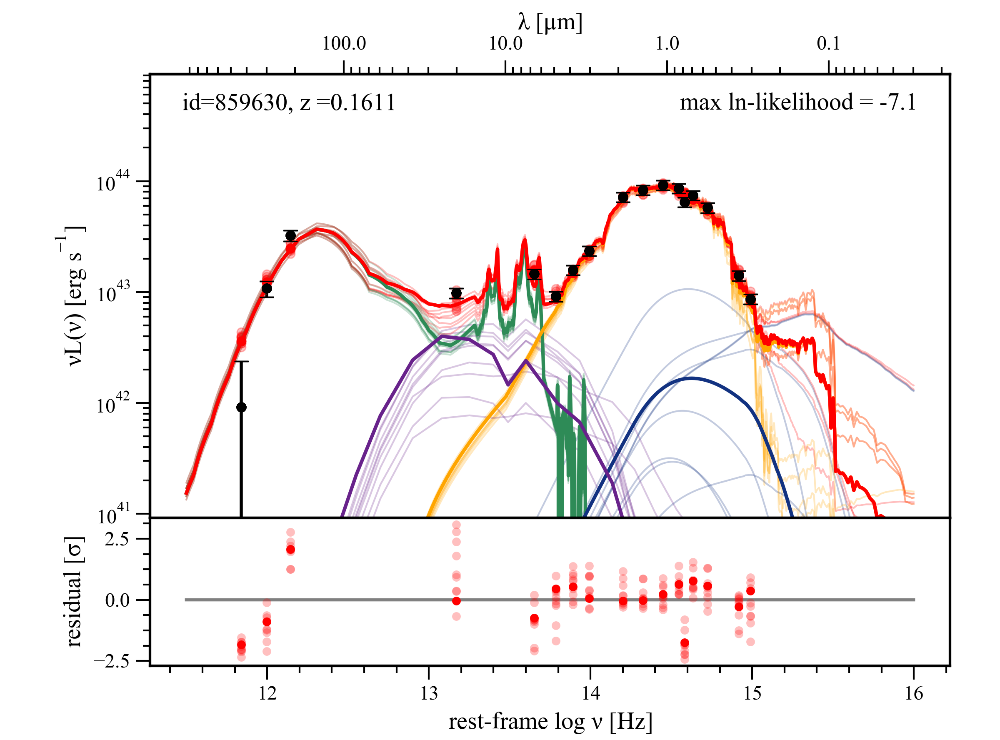

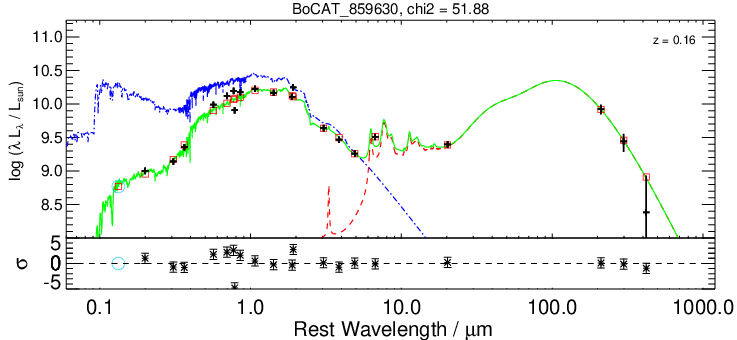

425
bigpipes reduced chi squared is: 2.4462205025512


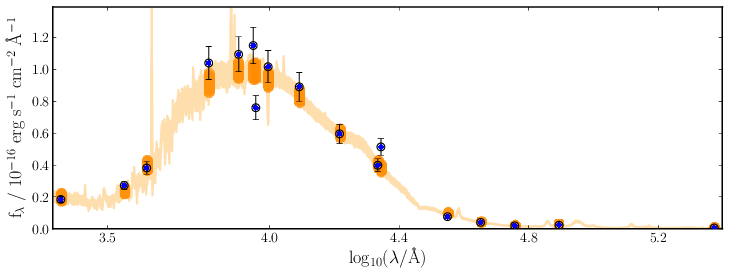

objects id is: 859630
column ALPHA_J2000 has a value of: 217.1268107 deg
column DELTA_J2000 has a value of: 33.9575164 deg
column CLASS_STAR has a value of: 0.029999999329447746
column NUV has a value of: 0.003166743516921997 uJy
column NUV_err has a value of: 3.002696670591831e-05 uJy
column u has a value of: 0.011513226509094239 uJy
column u_err has a value of: 6.579990684986114e-05 uJy
column Bw has a value of: 0.02224597930908203 uJy
column Bw_err has a value of: 4.712503775954247e-05 uJy
column R has a value of: 0.14631109619140625 uJy
column R_err has a value of: 0.00010765479505062104 uJy
column I has a value of: 0.2355654296875 uJy
column I_err has a value of: 0.0004000515937805176 uJy
column z has a value of: 0.3045352478027344 uJy
column z_err has a value of: 0.0005032865405082702 uJy
column z_Subaru has a value of: 0.2086931915283203 uJy
column z_Subaru_err has a value of: 0.000268900603055954 uJy
column y has a value of: 0.3327133483886719 uJy
column y_err has a value of: 0

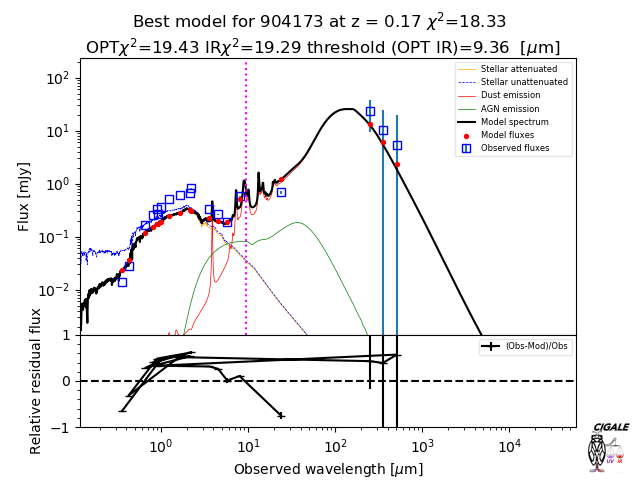

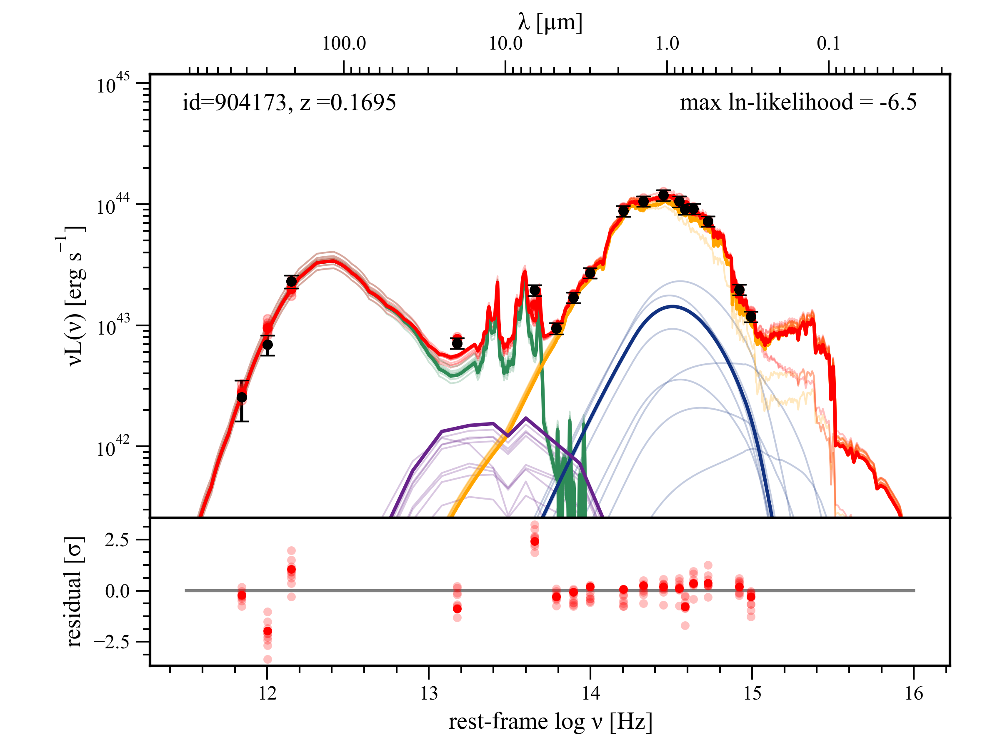

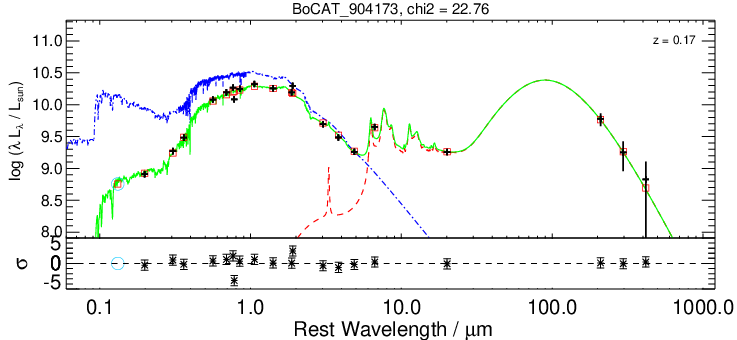

473
bigpipes reduced chi squared is: 1.7228961924331396


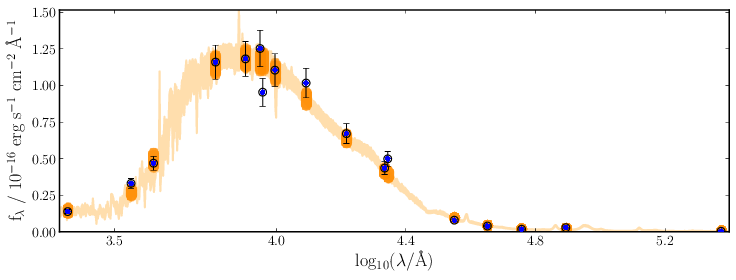

objects id is: 904173
column ALPHA_J2000 has a value of: 218.2361636 deg
column DELTA_J2000 has a value of: 34.0237443 deg
column CLASS_STAR has a value of: 0.029999999329447746
column NUV has a value of: 0.0023773472309112547 uJy
column NUV_err has a value of: 2.9528109356760978e-05 uJy
column u has a value of: 0.01400610065460205 uJy
column u_err has a value of: 4.544257372617721e-05 uJy
column Bw has a value of: 0.02732572555541992 uJy
column Bw_err has a value of: 4.167813435196876e-05 uJy
column R has a value of: 0.1631989440917969 uJy
column R_err has a value of: 0.0001240425631403923 uJy
column I has a value of: 0.2544437255859375 uJy
column I_err has a value of: 0.0002668989896774292 uJy
column z has a value of: 0.33180056762695315 uJy
column z_err has a value of: 0.000374946802854538 uJy
column z_Subaru has a value of: 0.26224609375 uJy
column z_Subaru_err has a value of: 0.00019191670417785644 uJy
column y has a value of: 0.36153512573242186 uJy
column y_err has a value of: 0

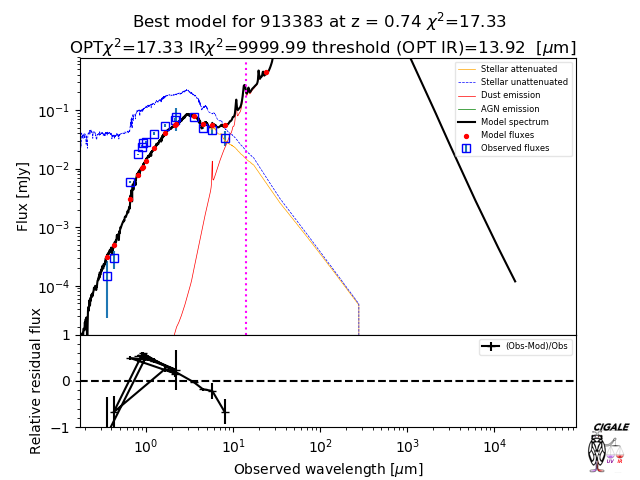

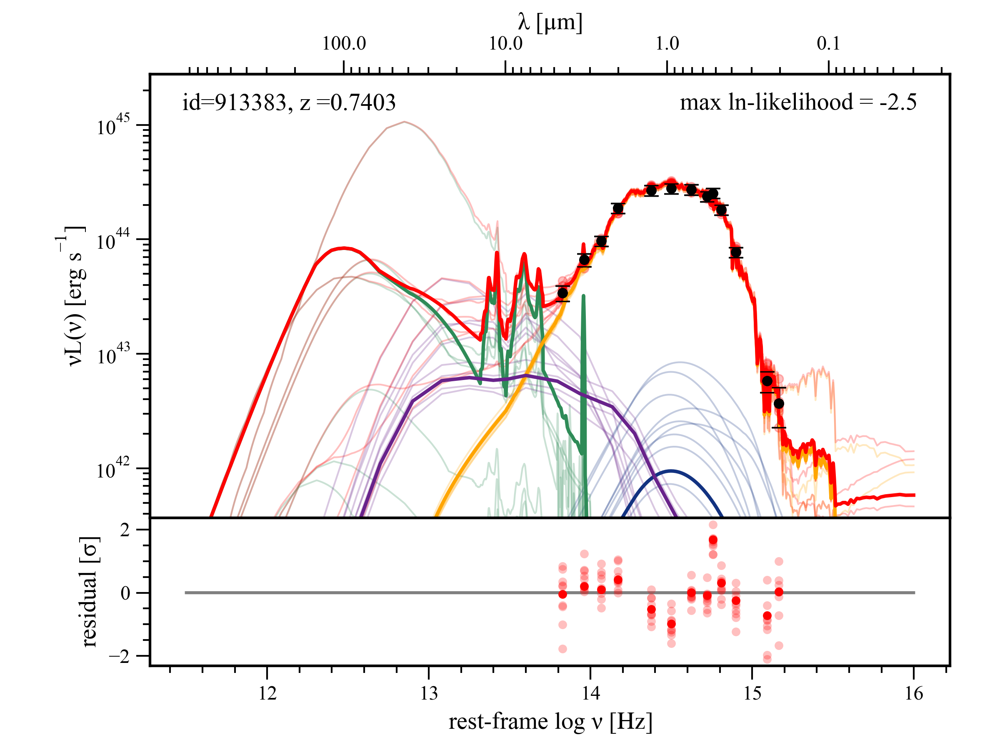

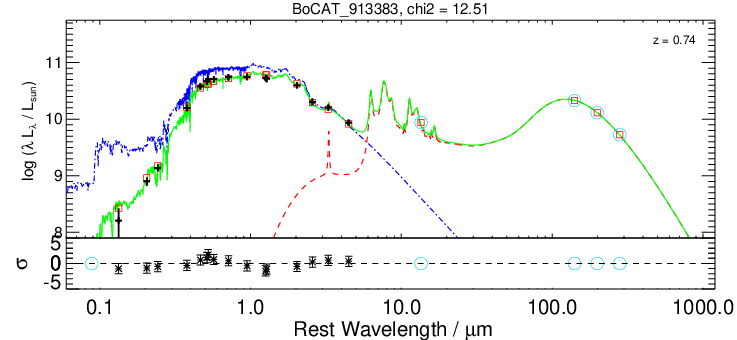

480
bigpipes reduced chi squared is: 1.880889104918061


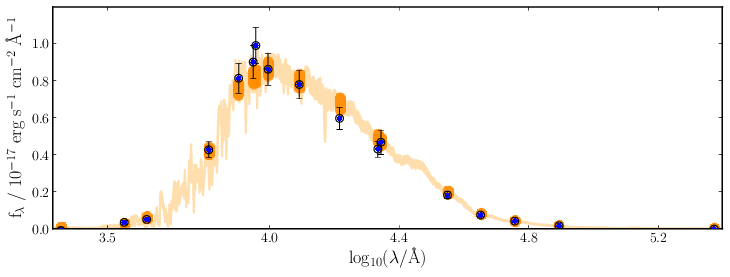

objects id is: 913383
column ALPHA_J2000 has a value of: 217.1210017 deg
column DELTA_J2000 has a value of: 34.0372203 deg
column CLASS_STAR has a value of: 0.029999999329447746
column NUV has a value of: -1.4465463347733021e-05 uJy
column NUV_err has a value of: 2.3674821481108666e-05 uJy
column u has a value of: 0.00014557208120822906 uJy
column u_err has a value of: 3.8967568427324295e-05 uJy
column Bw has a value of: 0.0002937998175621033 uJy
column Bw_err has a value of: 3.405094891786575e-05 uJy
column R has a value of: 0.00599677324295044 uJy
column R_err has a value of: 8.343695849180221e-05 uJy
column I has a value of: 0.017496536254882813 uJy
column I_err has a value of: 0.00011739549785852433 uJy
column z has a value of: 0.023834007263183594 uJy
column z_err has a value of: 0.0004539763629436493 uJy
column z_Subaru has a value of: 0.027191200256347657 uJy
column z_Subaru_err has a value of: 0.0002241251915693283 uJy
column y has a value of: 0.028172853469848633 uJy
column y_

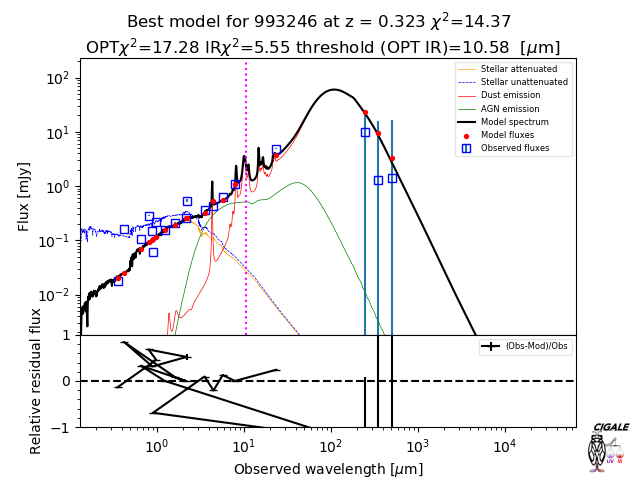

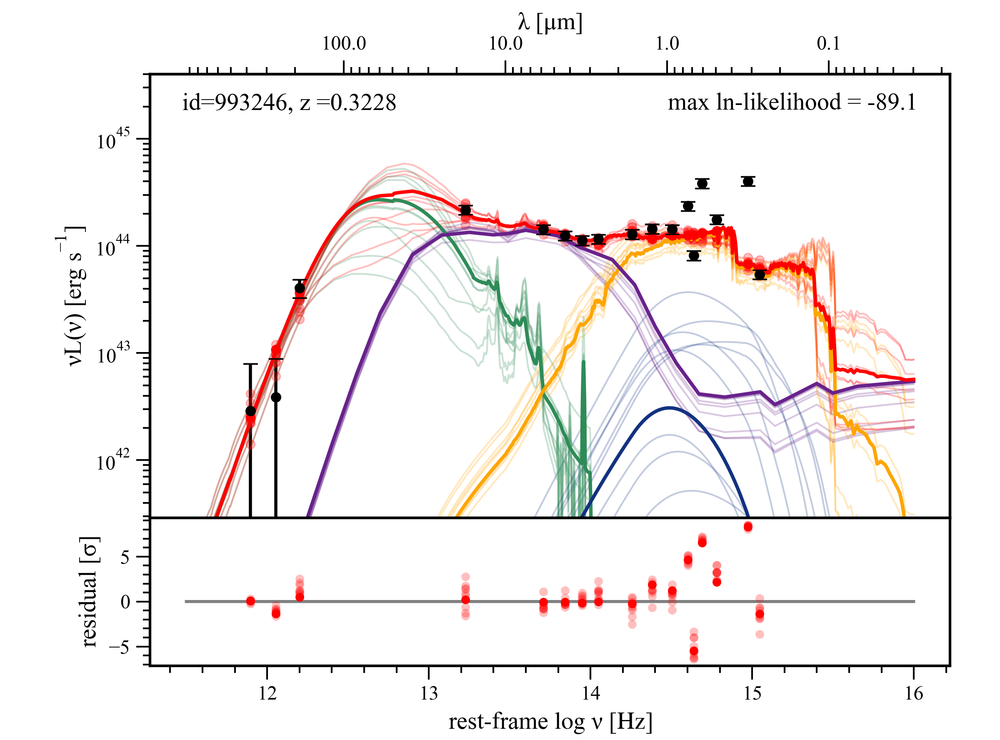

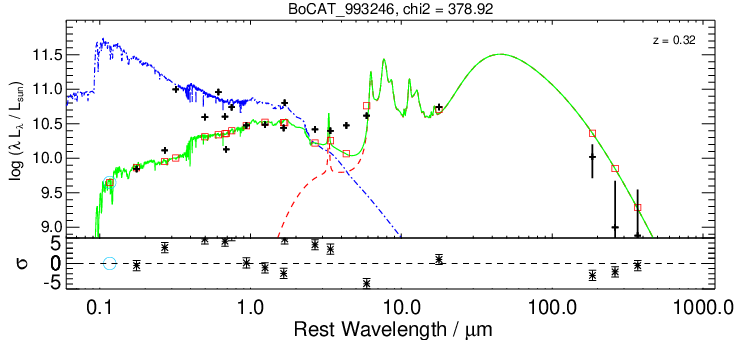

509
bigpipes reduced chi squared is: 25.859034411879854


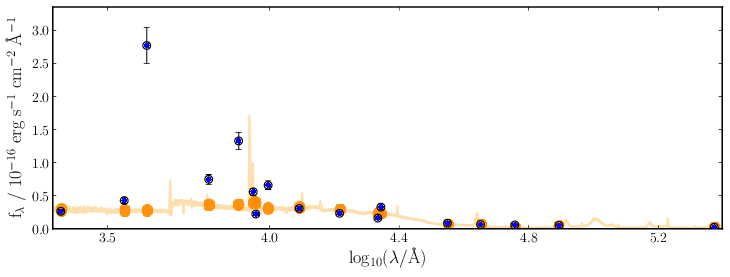

objects id is: 993246
column ALPHA_J2000 has a value of: 218.2106546 deg
column DELTA_J2000 has a value of: 34.122231 deg
column CLASS_STAR has a value of: 0.4000000059604645
column NUV has a value of: 0.004547499656677246 uJy
column NUV_err has a value of: 3.0231893062591552e-05 uJy
column u has a value of: 0.018074945449829103 uJy
column u_err has a value of: 4.3744511902332304e-05 uJy
column Bw has a value of: 0.16163372802734374 uJy
column Bw_err has a value of: 5.195819586515427e-05 uJy
column R has a value of: 0.10525373840332031 uJy
column R_err has a value of: 0.00018475019931793213 uJy
column I has a value of: 0.28606930541992187 uJy
column I_err has a value of: 0.0003072648048400879 uJy
column z has a value of: 0.14814173889160157 uJy
column z_err has a value of: 0.0006390423774719239 uJy
column z_Subaru has a value of: 0.06131810760498047 uJy
column z_Subaru_err has a value of: 0.00018749815225601197 uJy
column y has a value of: 0.21553146362304687 uJy
column y_err has a val

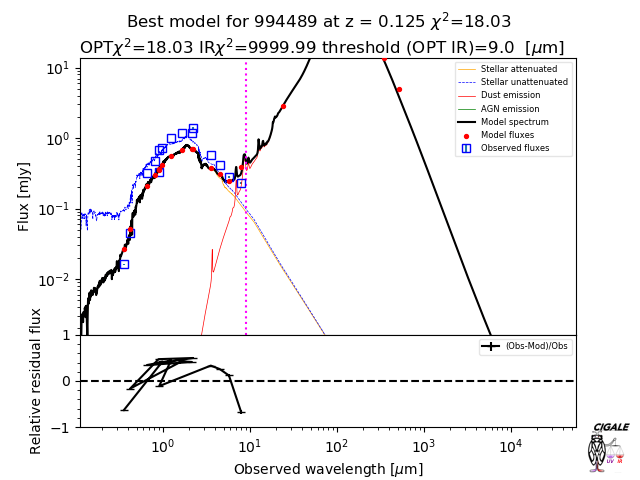

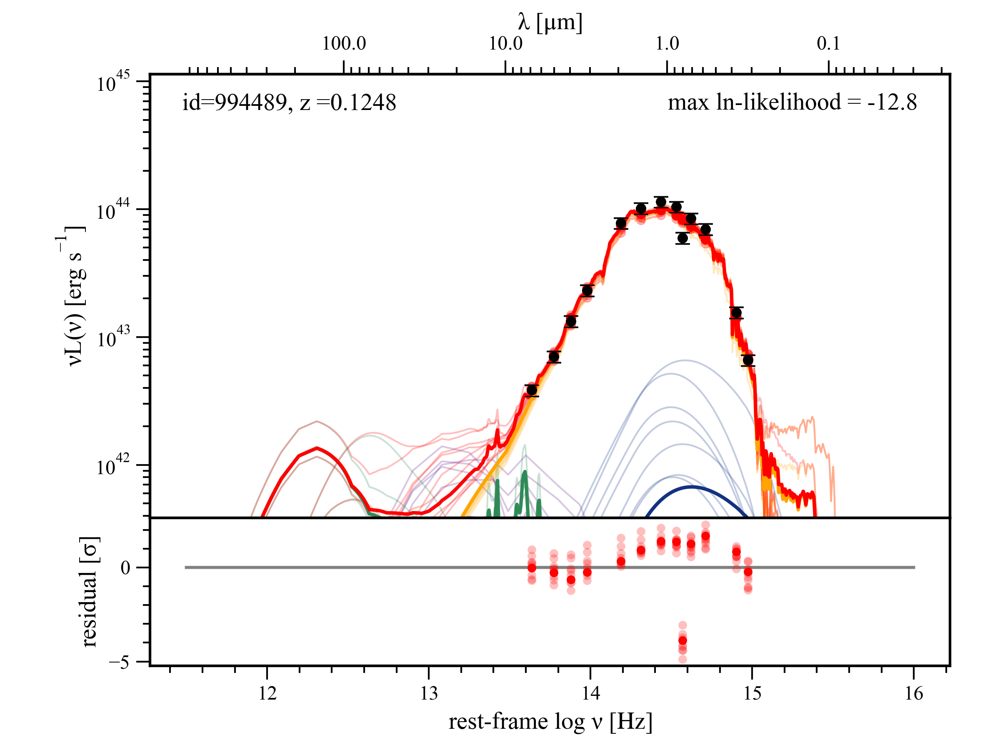

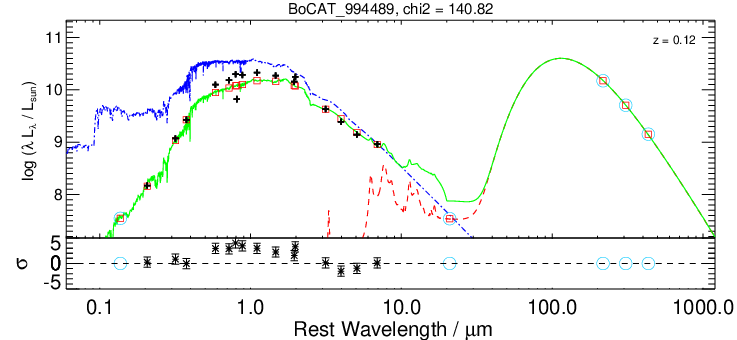

510
bigpipes reduced chi squared is: 7.077713251017597


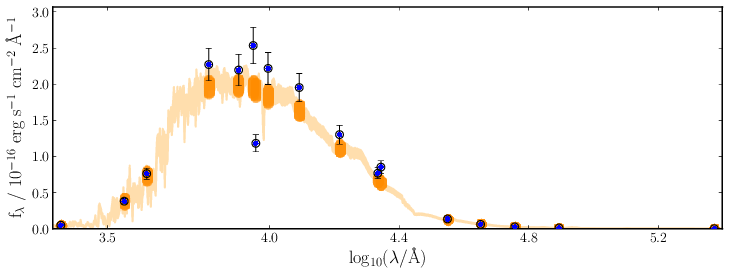

objects id is: 994489
column ALPHA_J2000 has a value of: 218.2140044 deg
column DELTA_J2000 has a value of: 34.1240593 deg
column CLASS_STAR has a value of: 0.029999999329447746
column NUV has a value of: 0.0008487359881401062 uJy
column NUV_err has a value of: 3.1055523082613946e-05 uJy
column u has a value of: 0.01615092468261719 uJy
column u_err has a value of: 4.3583549559116367e-05 uJy
column Bw has a value of: 0.04450946807861328 uJy
column Bw_err has a value of: 5.098696798086166e-05 uJy
column R has a value of: 0.319710693359375 uJy
column R_err has a value of: 0.00018461145460605622 uJy
column I has a value of: 0.4728370056152344 uJy
column I_err has a value of: 0.00030905044078826906 uJy
column z has a value of: 0.6716727905273437 uJy
column z_err has a value of: 0.0006311389803886413 uJy
column z_Subaru has a value of: 0.3249590148925781 uJy
column z_Subaru_err has a value of: 0.0002046756148338318 uJy
column y has a value of: 0.7260236206054688 uJy
column y_err has a value 

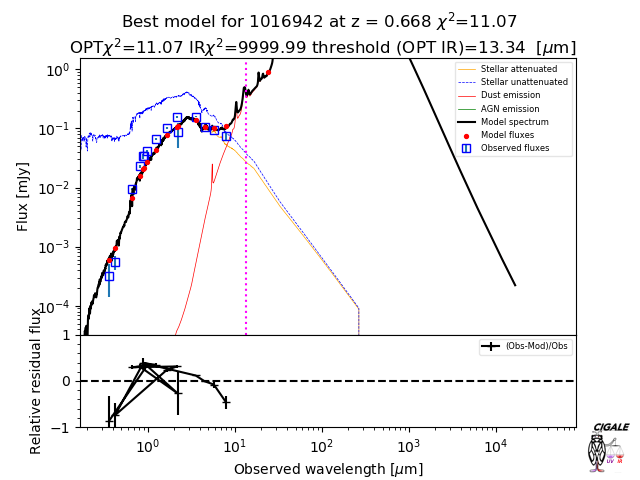

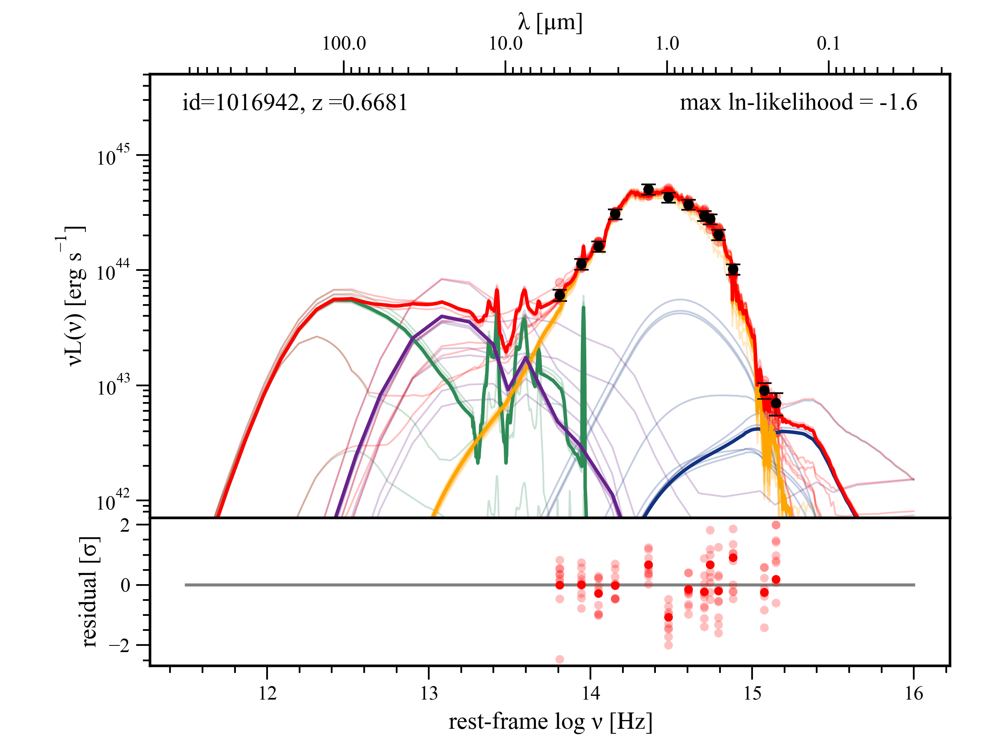

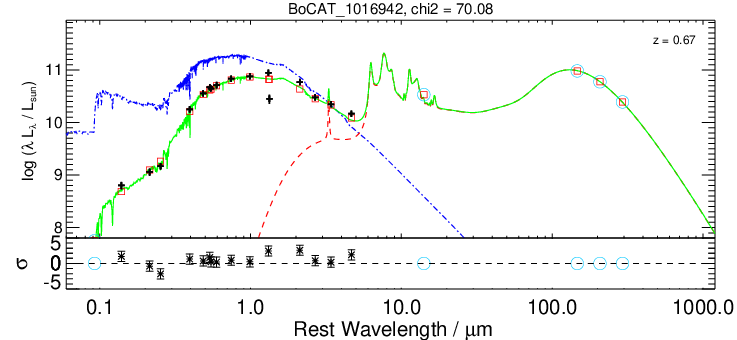

532
bigpipes reduced chi squared is: 3.0317144796536555


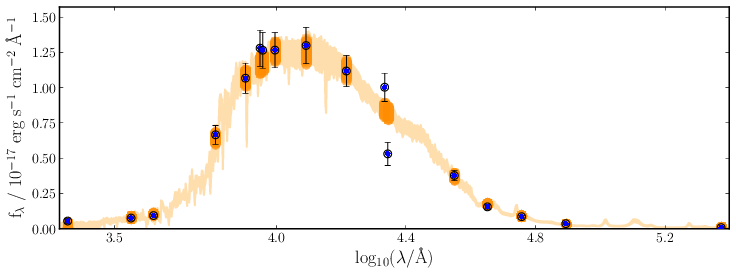

objects id is: 1016942
column ALPHA_J2000 has a value of: 217.9382305 deg
column DELTA_J2000 has a value of: 34.1574526 deg
column CLASS_STAR has a value of: 0.029999999329447746
column NUV has a value of: 9.470489621162414e-05 uJy
column NUV_err has a value of: 2.7608484029769896e-05 uJy
column u has a value of: 0.00032275837659835816 uJy
column u_err has a value of: 6.0053825378417965e-05 uJy
column Bw has a value of: 0.0005458730459213257 uJy
column Bw_err has a value of: 4.999488964676857e-05 uJy
column R has a value of: 0.009372098922729492 uJy
column R_err has a value of: 0.0001478276699781418 uJy
column I has a value of: 0.022980091094970703 uJy
column I_err has a value of: 0.000429272323846817 uJy
column z has a value of: 0.03390916442871094 uJy
column z_err has a value of: 0.0011324644088745116 uJy
column z_Subaru has a value of: 0.034784736633300783 uJy
column z_Subaru_err has a value of: 0.00017237037420272827 uJy
column y has a value of: 0.041444847106933594 uJy
column y_er

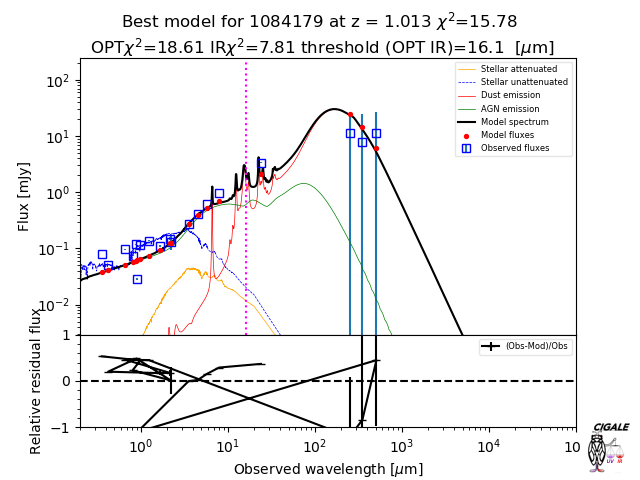

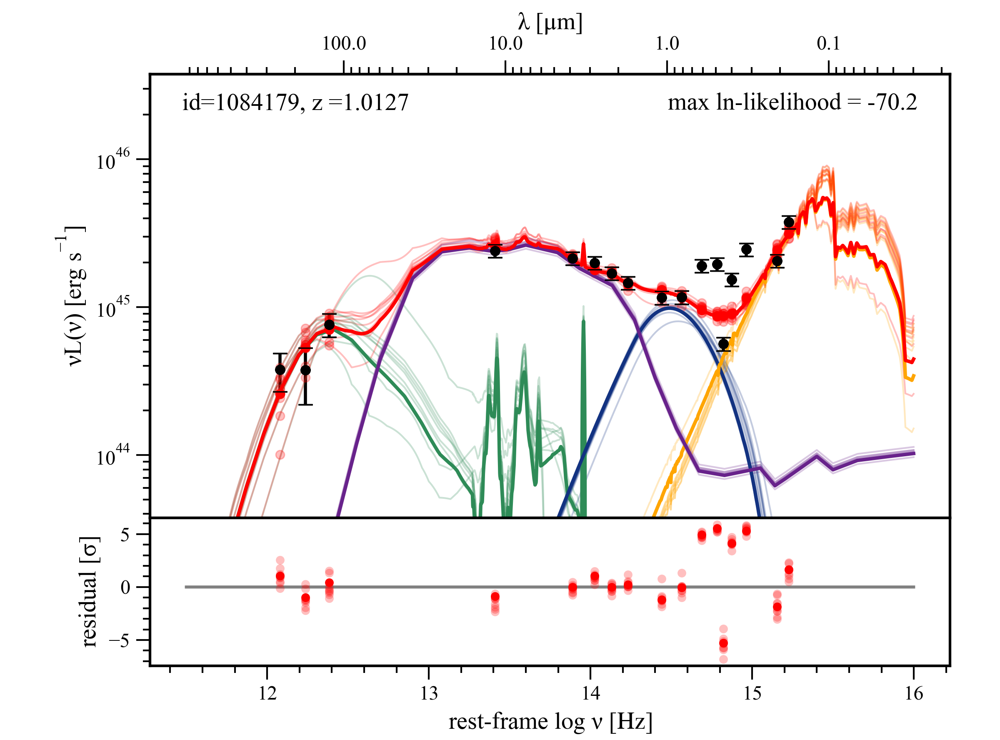

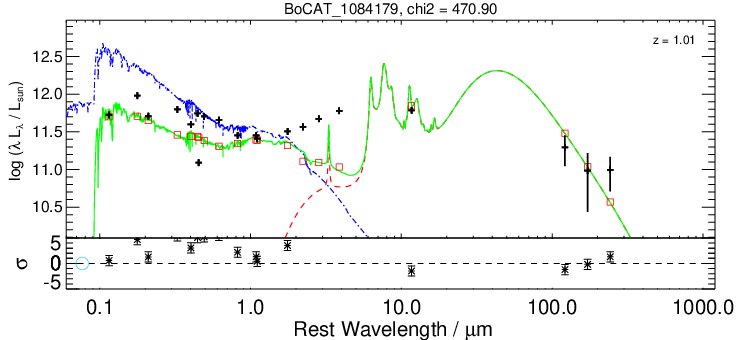

594
bigpipes reduced chi squared is: 31.175496373528237


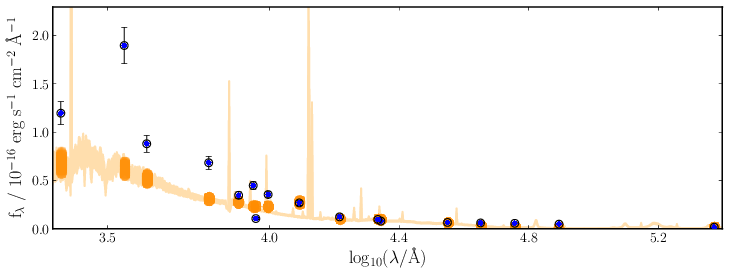

objects id is: 1084179
column ALPHA_J2000 has a value of: 218.3824623 deg
column DELTA_J2000 has a value of: 34.2591083 deg
column CLASS_STAR has a value of: 0.9800000190734863
column NUV has a value of: 0.02057279014587402 uJy
column NUV_err has a value of: 2.298351749777794e-05 uJy
column u has a value of: 0.08026337432861329 uJy
column u_err has a value of: 3.54524590075016e-05 uJy
column Bw has a value of: 0.051282779693603515 uJy
column Bw_err has a value of: 2.923618257045746e-05 uJy
column R has a value of: 0.09610740661621094 uJy
column R_err has a value of: 9.624582529067994e-05 uJy
column I has a value of: 0.07462281799316406 uJy
column I_err has a value of: 0.0001374097913503647 uJy
column z has a value of: 0.11861974334716797 uJy
column z_err has a value of: 0.00040470686554908755 uJy
column z_Subaru has a value of: 0.029082250595092774 uJy
column z_Subaru_err has a value of: 0.0003974489867687225 uJy
column y has a value of: 0.1160460433959961 uJy
column y_err has a value 

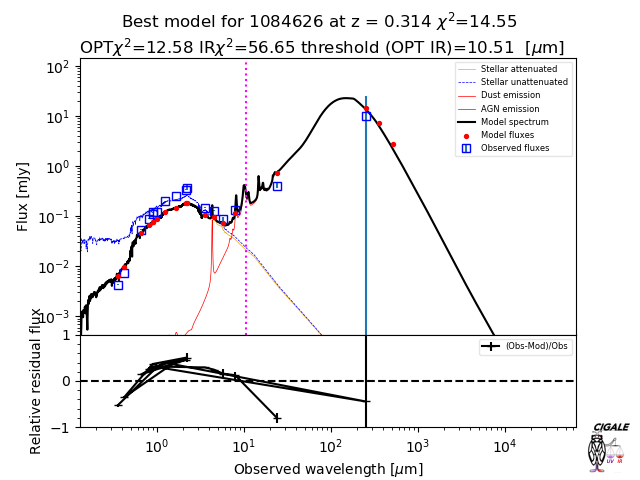

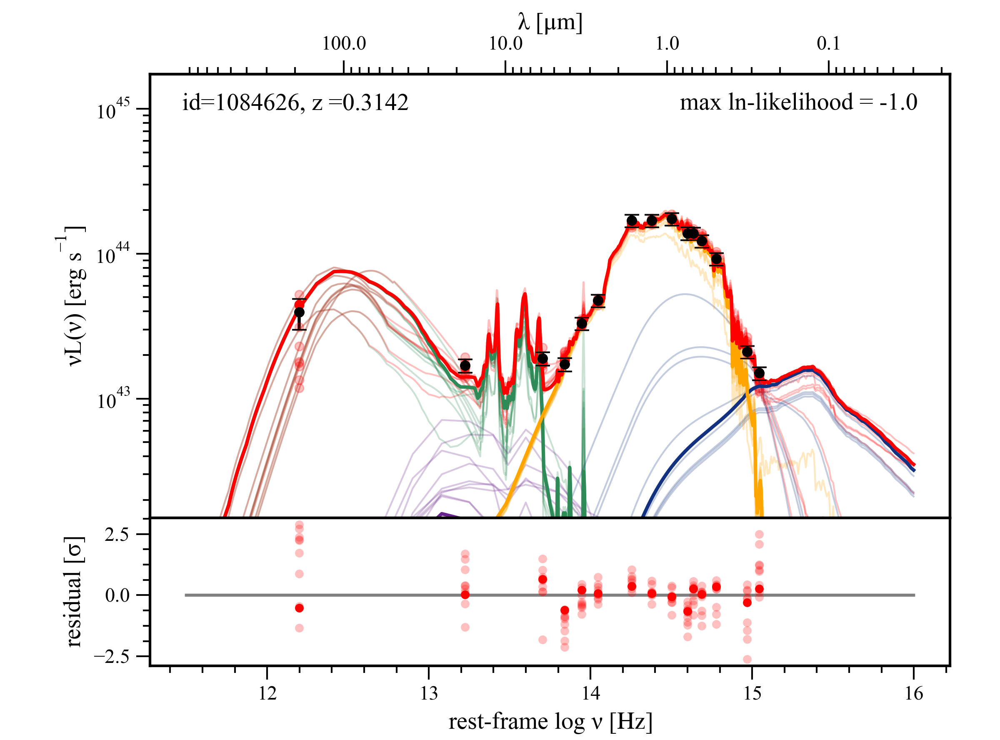

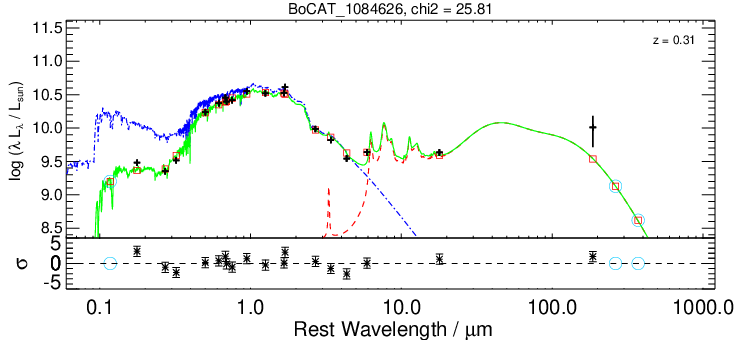

596
bigpipes reduced chi squared is: 1.5716246717696338


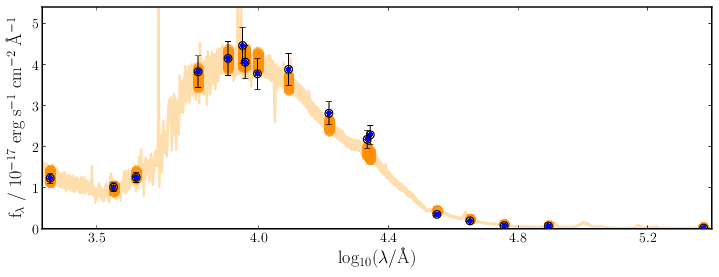

objects id is: 1084626
column ALPHA_J2000 has a value of: 217.0571989 deg
column DELTA_J2000 has a value of: 34.2597765 deg
column CLASS_STAR has a value of: 0.029999999329447746
column NUV has a value of: 0.002121940851211548 uJy
column NUV_err has a value of: 2.4674423038959502e-05 uJy
column u has a value of: 0.004295733451843262 uJy
column u_err has a value of: 4.89598773419857e-05 uJy
column Bw has a value of: 0.007308902263641358 uJy
column Bw_err has a value of: 3.418317809700966e-05 uJy
column R has a value of: 0.053846446990966794 uJy
column R_err has a value of: 0.00010564610362052917 uJy
column I has a value of: 0.08934535217285157 uJy
column I_err has a value of: 0.0002587662935256958 uJy
column z has a value of: 0.11825979614257813 uJy
column z_err has a value of: 0.00048296526074409485 uJy
column z_Subaru has a value of: 0.11158067321777344 uJy
column z_Subaru_err has a value of: 0.00026134949922561643 uJy
column y has a value of: 0.12356932067871093 uJy
column y_err has 

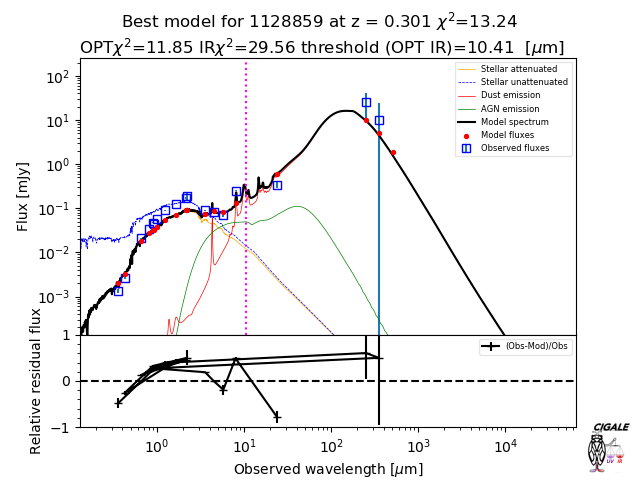

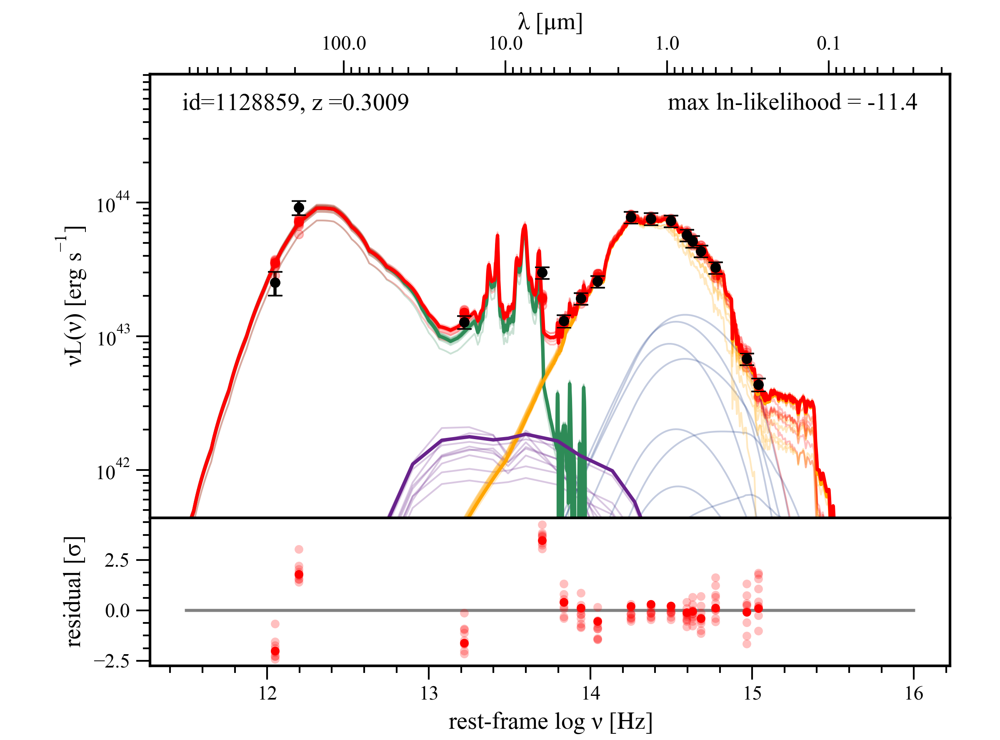

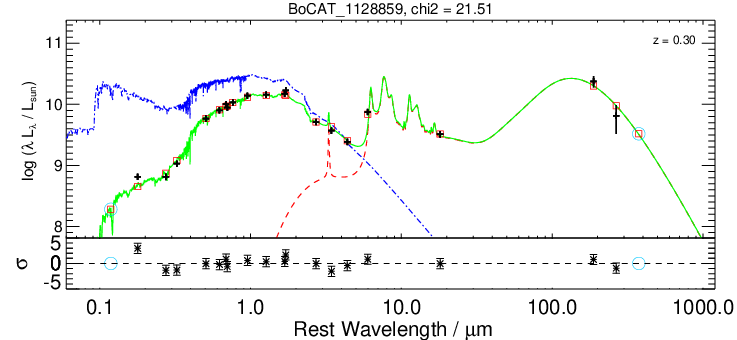

636
bigpipes reduced chi squared is: 3.356948576209496


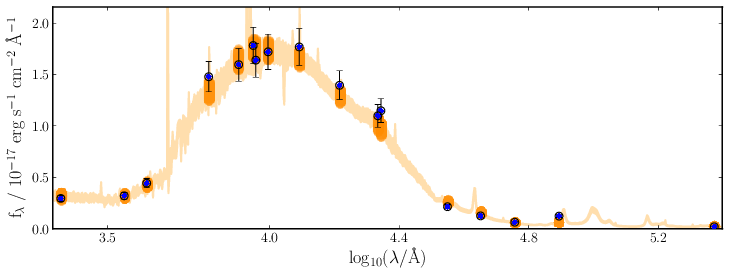

objects id is: 1128859
column ALPHA_J2000 has a value of: 218.7796362 deg
column DELTA_J2000 has a value of: 34.3330164 deg
column CLASS_STAR has a value of: 0.029999999329447746
column NUV has a value of: 0.0005075661540031433 uJy
column NUV_err has a value of: 2.8694277629256248e-05 uJy
column u has a value of: 0.0013584301471710205 uJy
column u_err has a value of: 5.001296475529671e-05 uJy
column Bw has a value of: 0.0025856609344482424 uJy
column Bw_err has a value of: 3.989007696509361e-05 uJy
column R has a value of: 0.02079877281188965 uJy
column R_err has a value of: 8.347525447607041e-05 uJy
column I has a value of: 0.03435828399658203 uJy
column I_err has a value of: 0.00014123505353927612 uJy
column z has a value of: 0.04719734191894531 uJy
column z_err has a value of: 0.0004504583775997162 uJy
column z_Subaru has a value of: 0.04505143737792969 uJy
column z_Subaru_err has a value of: 0.00017332080006599425 uJy
column y has a value of: 0.05630552673339844 uJy
column y_err ha

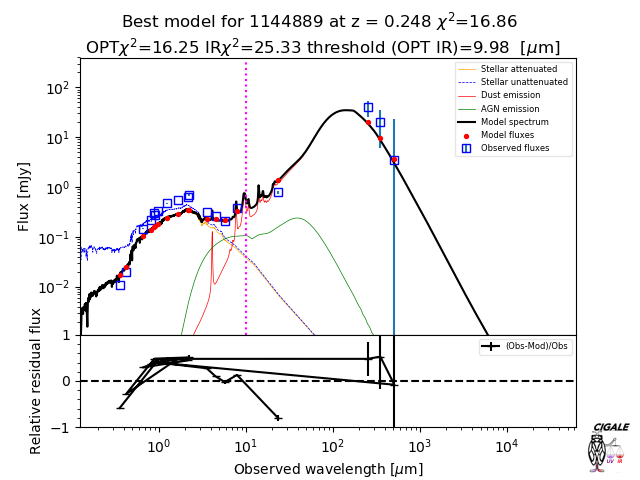

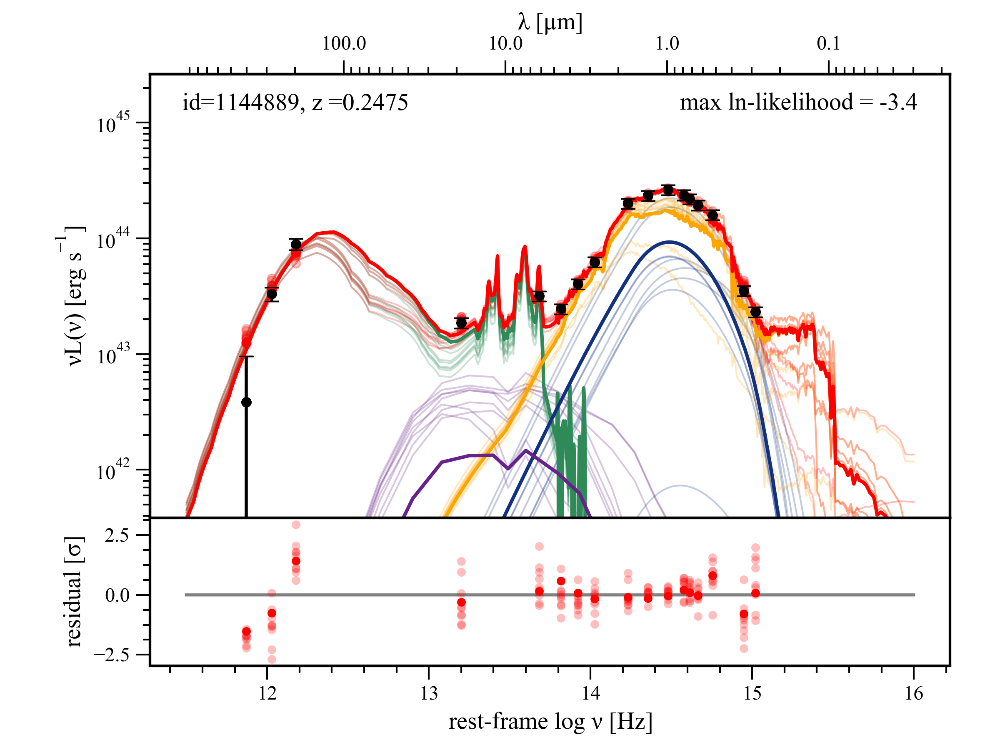

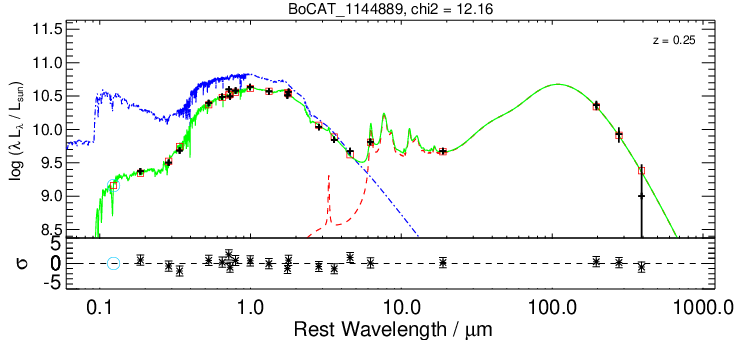

657
bigpipes reduced chi squared is: 1.1781852381811022


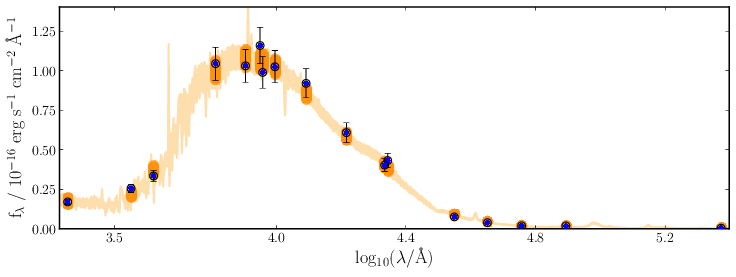

objects id is: 1144889
column ALPHA_J2000 has a value of: 218.7711952 deg
column DELTA_J2000 has a value of: 34.3607885 deg
column CLASS_STAR has a value of: 0.029999999329447746
column NUV has a value of: 0.002926126003265381 uJy
column NUV_err has a value of: 2.5590712204575538e-05 uJy
column u has a value of: 0.010830218315124512 uJy
column u_err has a value of: 5.29845803976059e-05 uJy
column Bw has a value of: 0.01948819923400879 uJy
column Bw_err has a value of: 3.3427659422159194e-05 uJy
column R has a value of: 0.14698654174804687 uJy
column R_err has a value of: 7.169244438409806e-05 uJy
column I has a value of: 0.2219994354248047 uJy
column I_err has a value of: 0.0001481146365404129 uJy
column z has a value of: 0.30712652587890626 uJy
column z_err has a value of: 0.0004999476075172424 uJy
column z_Subaru has a value of: 0.27191201782226565 uJy
column z_Subaru_err has a value of: 0.00011958438158035278 uJy
column y has a value of: 0.33542132568359373 uJy
column y_err has a va

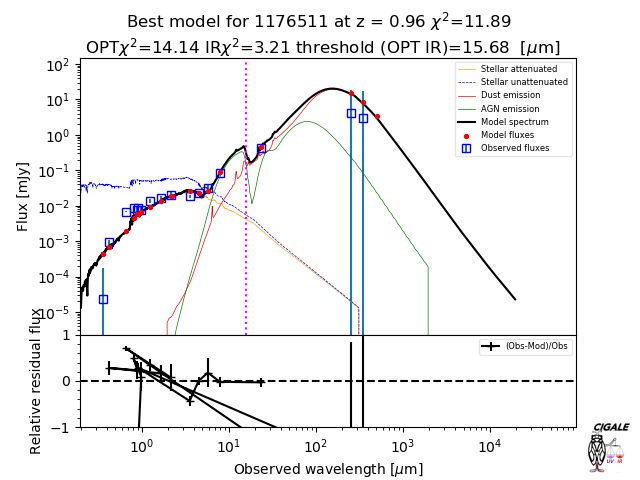

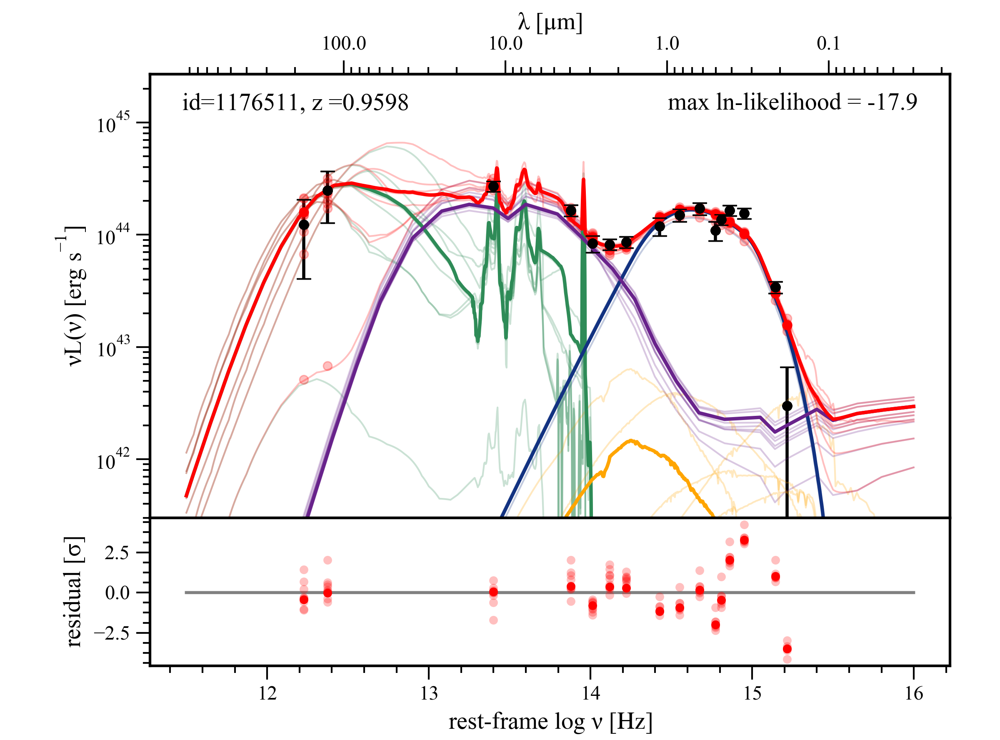

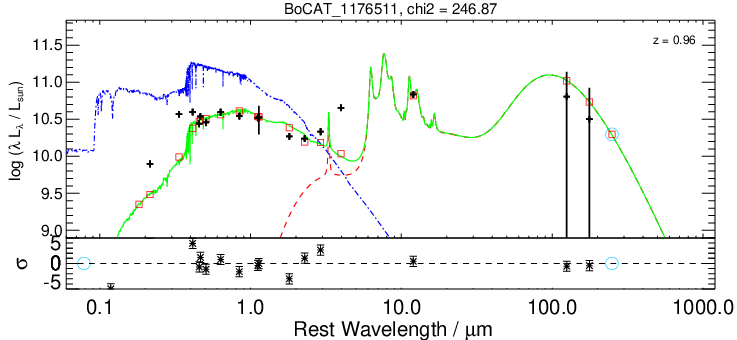

680
bigpipes reduced chi squared is: 20.286867978009468


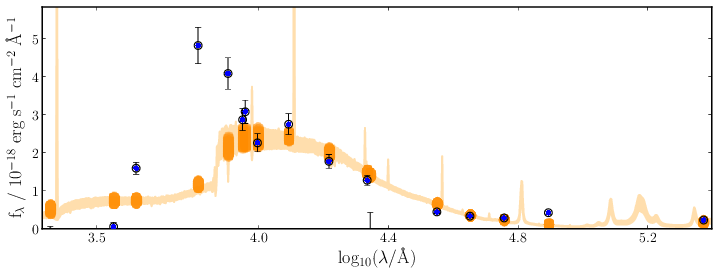

objects id is: 1176511
column ALPHA_J2000 has a value of: 217.2389275 deg
column DELTA_J2000 has a value of: 34.4177062 deg
column CLASS_STAR has a value of: 0.8100000023841858
column NUV has a value of: -1.5031871385872364e-05 uJy
column NUV_err has a value of: 2.4543527513742447e-05 uJy
column u has a value of: 2.2652573883533477e-05 uJy
column u_err has a value of: 5.1400095224380494e-05 uJy
column Bw has a value of: 0.0009283913373947144 uJy
column Bw_err has a value of: 4.489564523100853e-05 uJy
column R has a value of: 0.006782609939575196 uJy
column R_err has a value of: 0.00011517750471830368 uJy
column I has a value of: 0.008792484283447265 uJy
column I_err has a value of: 0.0001917981207370758 uJy
column z has a value of: 0.007595524311065673 uJy
column z_err has a value of: 0.00048687246441841124 uJy
column z_Subaru has a value of: 0.008457231521606445 uJy
column z_Subaru_err has a value of: 0.00029155030846595765 uJy
column y has a value of: 0.007393848419189453 uJy
column 

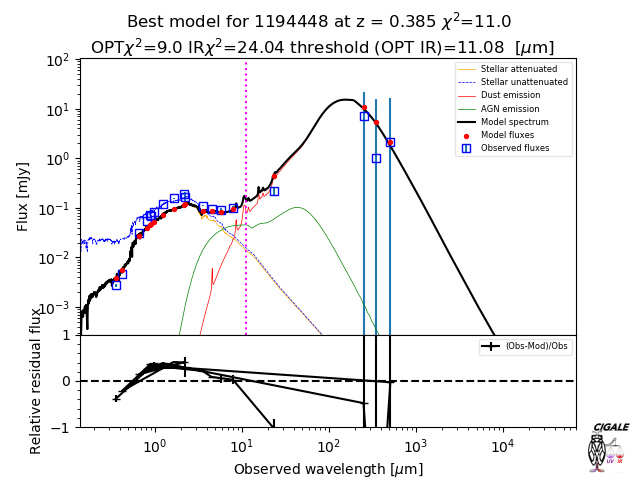

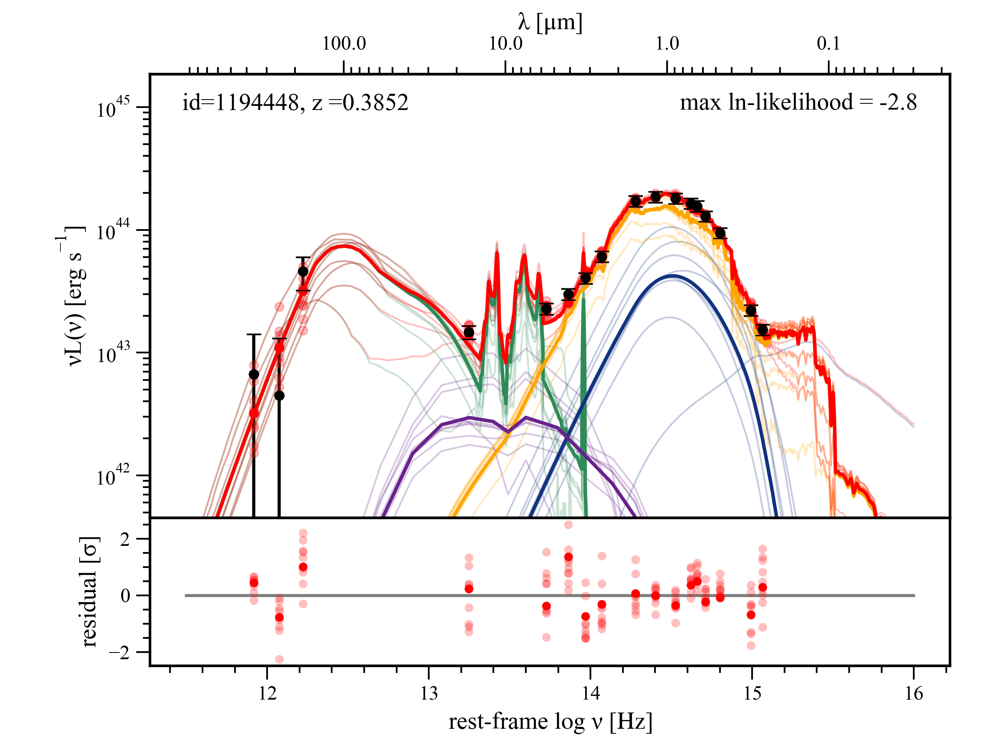

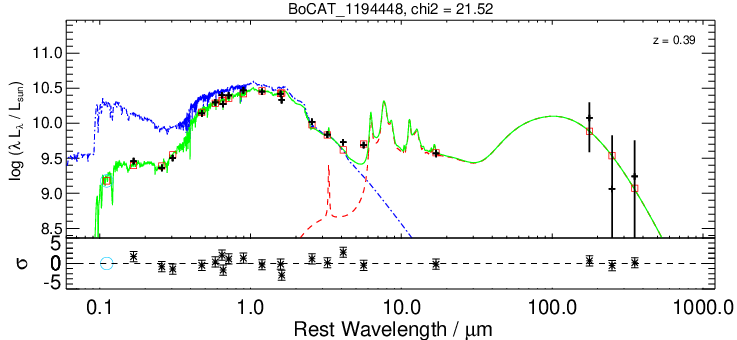

695
bigpipes reduced chi squared is: 1.1523091690453773


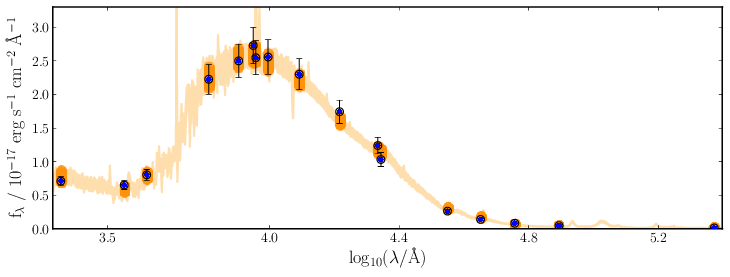

objects id is: 1194448
column ALPHA_J2000 has a value of: 218.4103496 deg
column DELTA_J2000 has a value of: 34.4488525 deg
column CLASS_STAR has a value of: 0.029999999329447746
column NUV has a value of: 0.001220262050628662 uJy
column NUV_err has a value of: 2.3989086970686912e-05 uJy
column u has a value of: 0.0027562453746795656 uJy
column u_err has a value of: 6.770250201225281e-05 uJy
column Bw has a value of: 0.004681787490844727 uJy
column Bw_err has a value of: 3.9179198443889615e-05 uJy
column R has a value of: 0.03131821060180664 uJy
column R_err has a value of: 0.00011017753928899765 uJy
column I has a value of: 0.053820968627929684 uJy
column I_err has a value of: 0.00017000682651996613 uJy
column z has a value of: 0.07226324462890625 uJy
column z_err has a value of: 0.00044207394123077395 uJy
column z_Subaru has a value of: 0.069982421875 uJy
column z_Subaru_err has a value of: 0.00022150731086730956 uJy
column y has a value of: 0.08368171691894531 uJy
column y_err has a

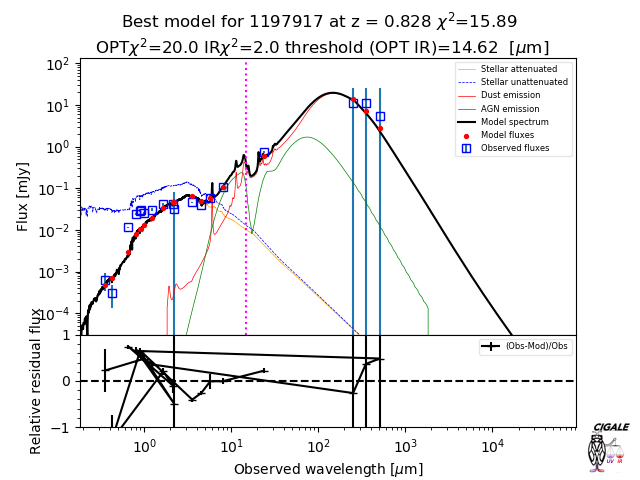

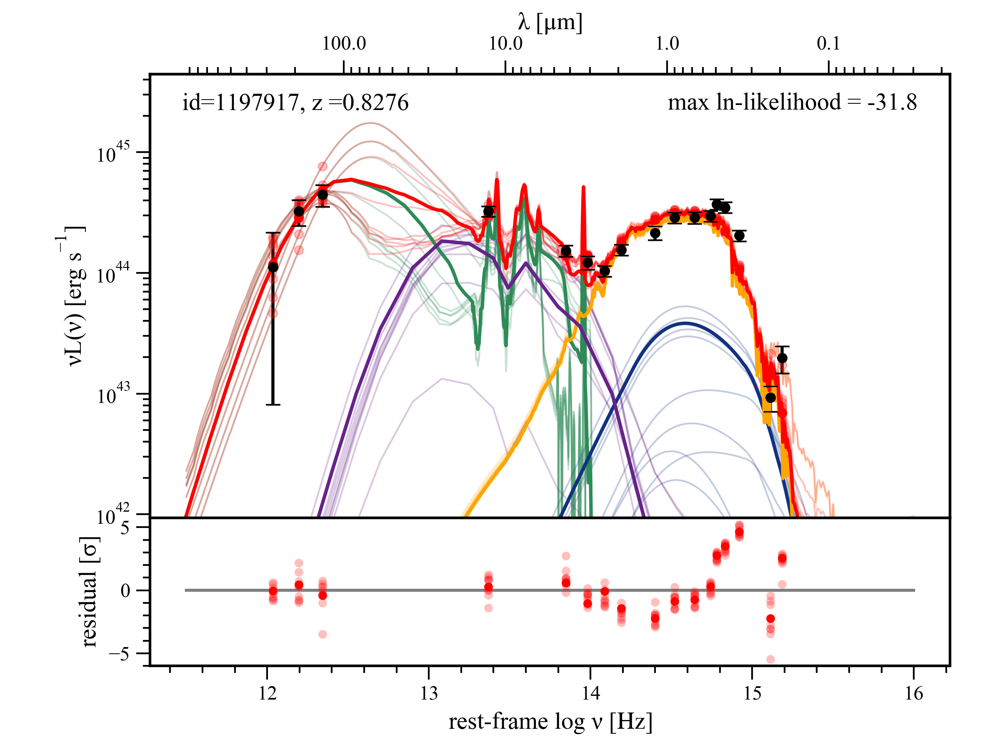

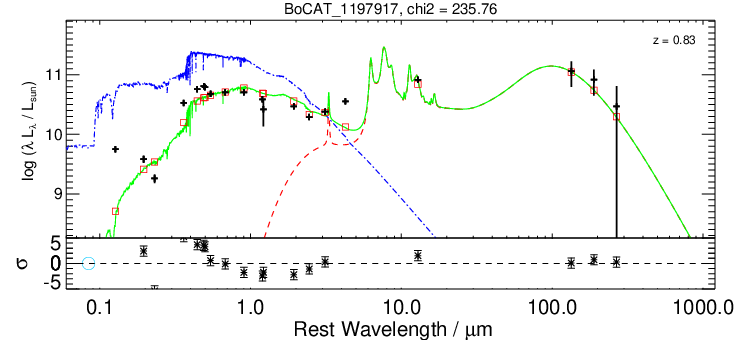

700
bigpipes reduced chi squared is: 22.04102689369251


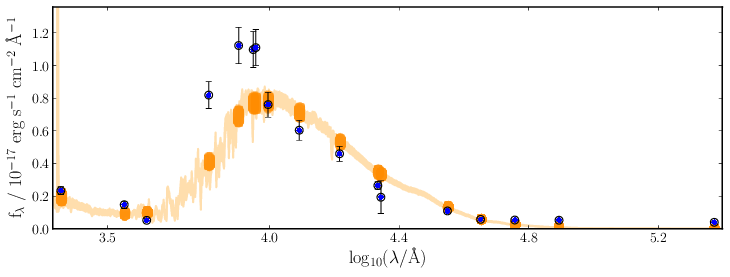

objects id is: 1197917
column ALPHA_J2000 has a value of: 217.7728347 deg
column DELTA_J2000 has a value of: 34.4549361 deg
column CLASS_STAR has a value of: 0.05999999865889549
column NUV has a value of: 0.000402024507522583 uJy
column NUV_err has a value of: 3.223549947142601e-05 uJy
column u has a value of: 0.0006248806715011597 uJy
column u_err has a value of: 9.56951230764389e-05 uJy
column Bw has a value of: 0.00030214250087738035 uJy
column Bw_err has a value of: 5.616787075996399e-05 uJy
column R has a value of: 0.011524888038635253 uJy
column R_err has a value of: 0.00016030855476856232 uJy
column I has a value of: 0.02417191505432129 uJy
column I_err has a value of: 0.00041862550377845764 uJy
column z has a value of: 0.029077558517456054 uJy
column z_err has a value of: 0.0007948819398880005 uJy
column z_Subaru has a value of: 0.03050348472595215 uJy
column z_Subaru_err has a value of: 0.00033918097615242003 uJy
column y has a value of: 0.024892656326293946 uJy
column y_err h

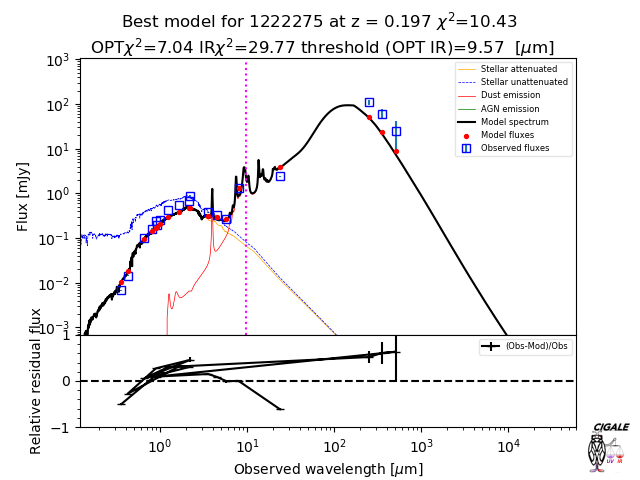

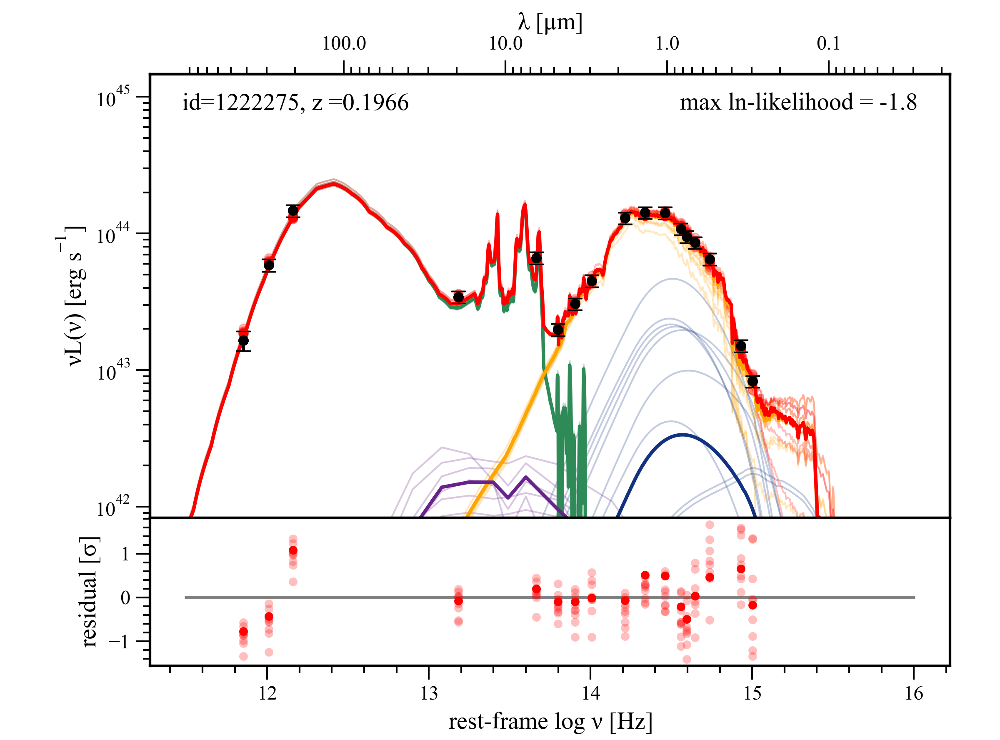

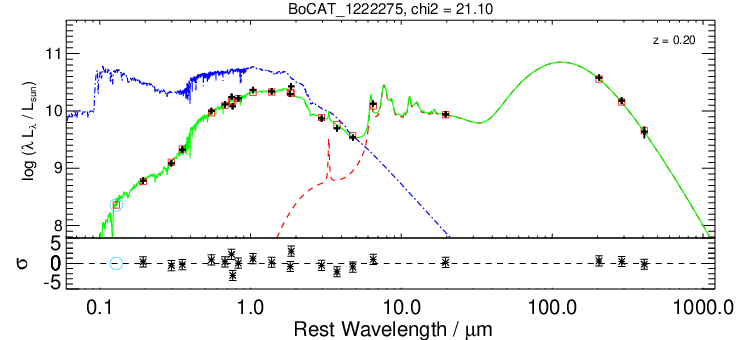

727
bigpipes reduced chi squared is: 2.054208935072516


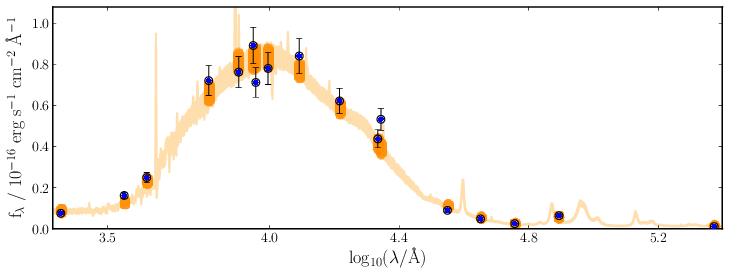

objects id is: 1222275
column ALPHA_J2000 has a value of: 217.8069622 deg
column DELTA_J2000 has a value of: 34.4968819 deg
column CLASS_STAR has a value of: 0.029999999329447746
column NUV has a value of: 0.0012954245805740356 uJy
column NUV_err has a value of: 2.4366095662117005e-05 uJy
column u has a value of: 0.006852327823638916 uJy
column u_err has a value of: 5.245453491806984e-05 uJy
column Bw has a value of: 0.014518830299377441 uJy
column Bw_err has a value of: 4.392746835947037e-05 uJy
column R has a value of: 0.10131575775146484 uJy
column R_err has a value of: 9.581898152828216e-05 uJy
column I has a value of: 0.16390464782714845 uJy
column I_err has a value of: 0.0002361832708120346 uJy
column z has a value of: 0.23593789672851562 uJy
column z_err has a value of: 0.0004734376668930054 uJy
column z_Subaru has a value of: 0.1954107971191406 uJy
column z_Subaru_err has a value of: 0.000309999942779541 uJy
column y has a value of: 0.2550764465332031 uJy
column y_err has a val

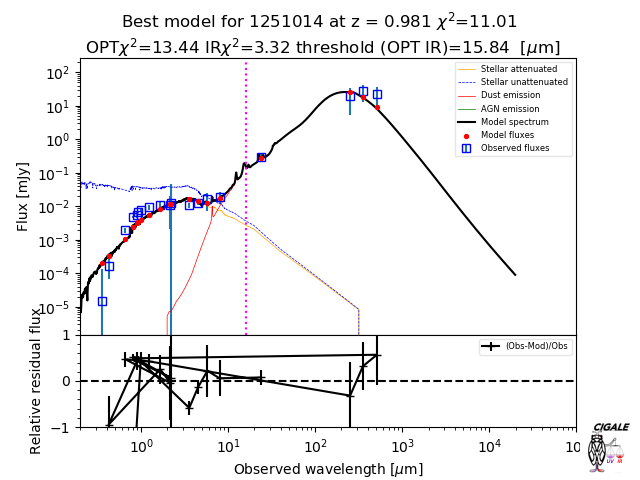

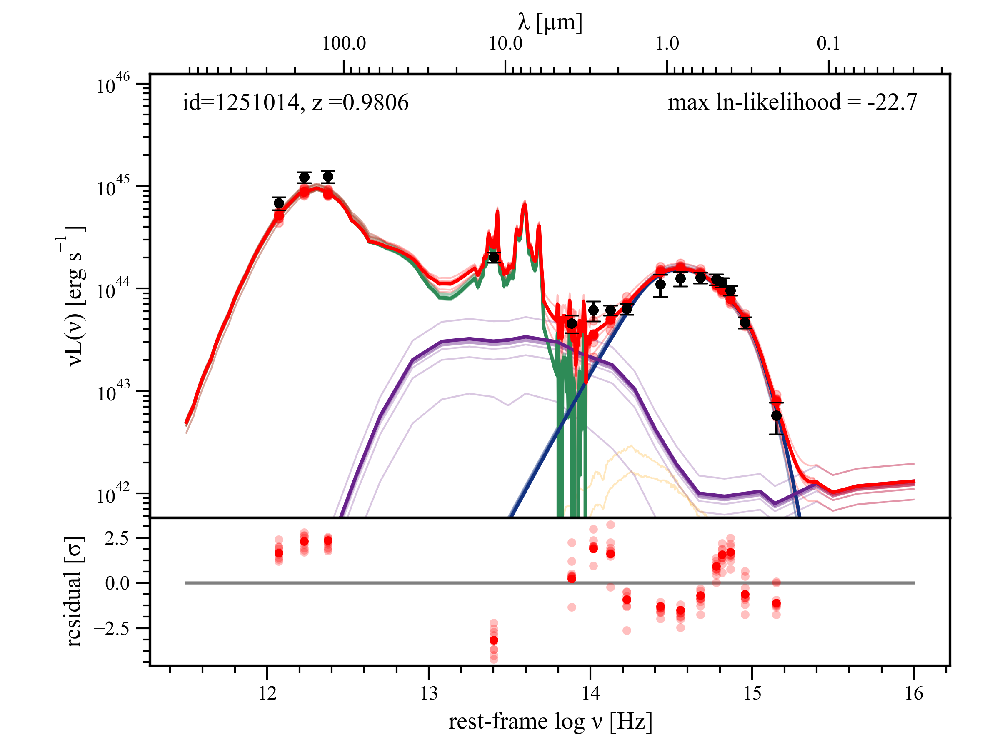

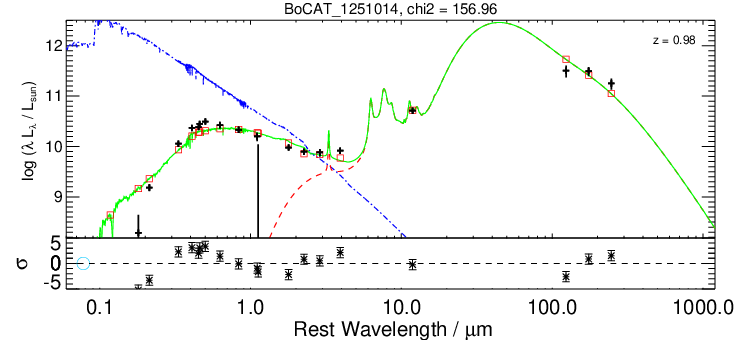

758
bigpipes reduced chi squared is: 10.603295778808985


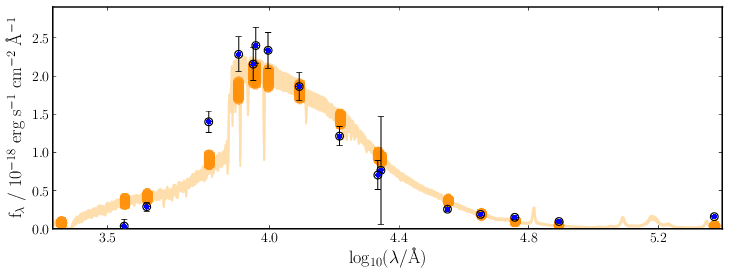

objects id is: 1251014
column ALPHA_J2000 has a value of: 218.7851554 deg
column DELTA_J2000 has a value of: 34.5472611 deg
column CLASS_STAR has a value of: 0.8999999761581421
column NUV has a value of: -2.972300723195076e-05 uJy
column NUV_err has a value of: 1.7919471487402915e-05 uJy
column u has a value of: 1.4710844494402408e-05 uJy
column u_err has a value of: 3.871839493513107e-05 uJy
column Bw has a value of: 0.00016872191429138185 uJy
column Bw_err has a value of: 3.4311916679143905e-05 uJy
column R has a value of: 0.0019711403846740722 uJy
column R_err has a value of: 0.00010435079038143158 uJy
column I has a value of: 0.0049189386367797855 uJy
column I_err has a value of: 0.00011834417283535004 uJy
column z has a value of: 0.0057126498222351075 uJy
column z_err has a value of: 0.00038363450765609744 uJy
column z_Subaru has a value of: 0.006596422672271728 uJy
column z_Subaru_err has a value of: 0.00013264335691928864 uJy
column y has a value of: 0.007648045539855957 uJy
col

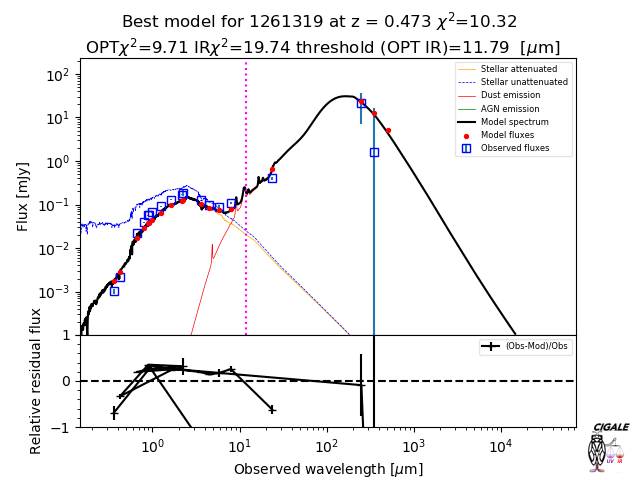

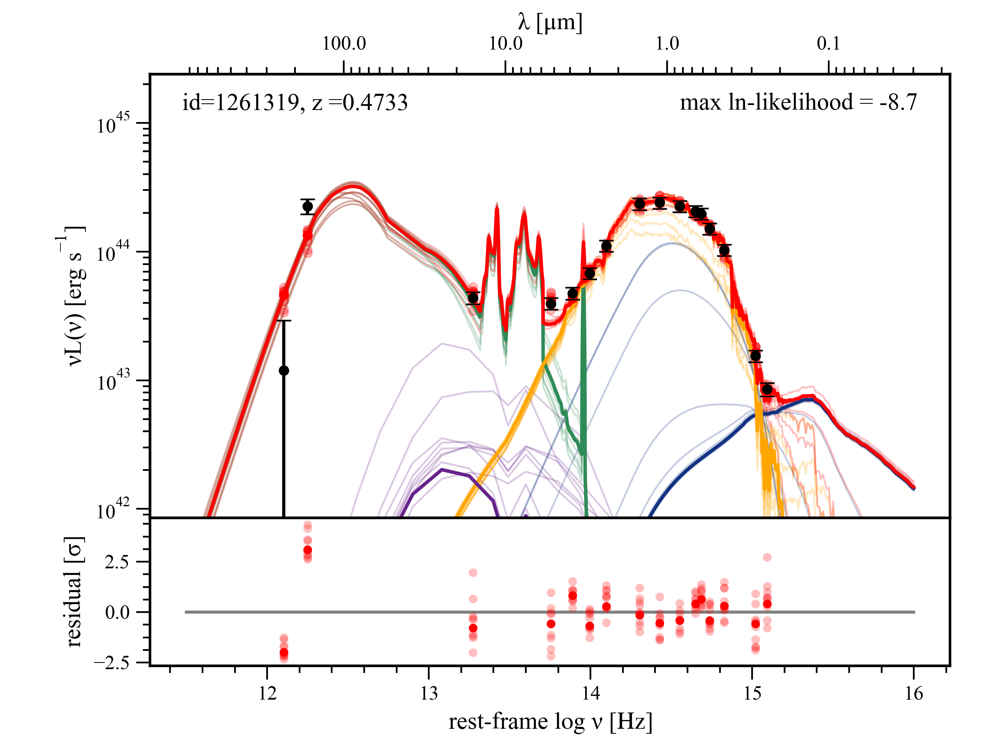

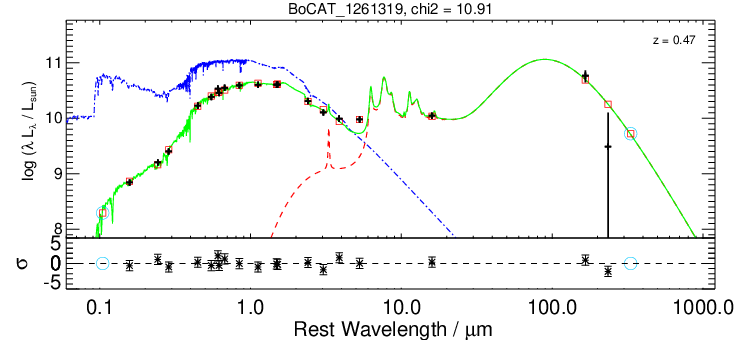

771
bigpipes reduced chi squared is: 1.1076805354467116


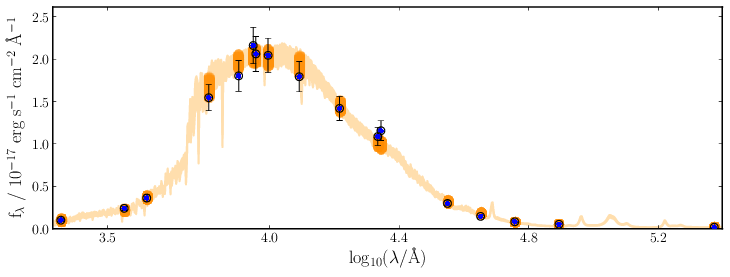

objects id is: 1261319
column ALPHA_J2000 has a value of: 218.0490345 deg
column DELTA_J2000 has a value of: 34.5652574 deg
column CLASS_STAR has a value of: 0.029999999329447746
column NUV has a value of: 0.0001746678501367569 uJy
column NUV_err has a value of: 2.3879887536168097e-05 uJy
column u has a value of: 0.0010205574035644532 uJy
column u_err has a value of: 5.308426916599274e-05 uJy
column Bw has a value of: 0.0021145169734954833 uJy
column Bw_err has a value of: 3.974011167883873e-05 uJy
column R has a value of: 0.021740882873535157 uJy
column R_err has a value of: 9.098716825246811e-05 uJy
column I has a value of: 0.03881427001953125 uJy
column I_err has a value of: 0.0002274976521730423 uJy
column z has a value of: 0.05723712158203125 uJy
column z_err has a value of: 0.0004270868599414825 uJy
column z_Subaru has a value of: 0.056669391632080075 uJy
column z_Subaru_err has a value of: 0.00014931988716125488 uJy
column y has a value of: 0.06691297149658203 uJy
column y_err h

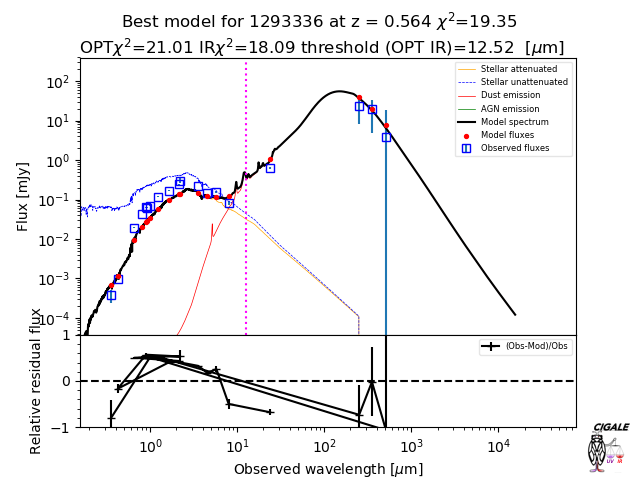

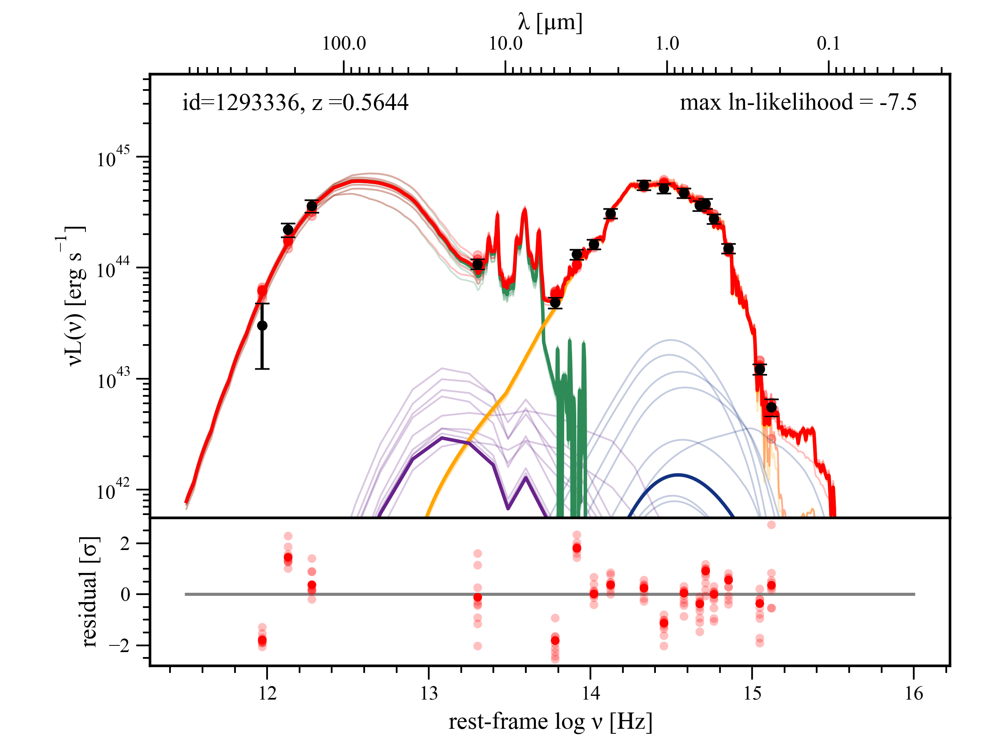

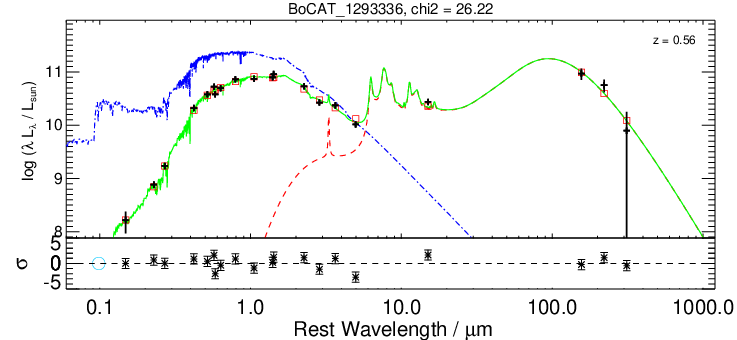

794
bigpipes reduced chi squared is: 1.6650790891795364


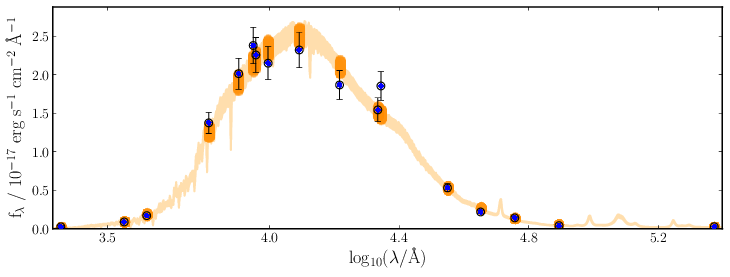

objects id is: 1293336
column ALPHA_J2000 has a value of: 217.8029699 deg
column DELTA_J2000 has a value of: 34.6139143 deg
column CLASS_STAR has a value of: 0.029999999329447746
column NUV has a value of: 4.4975176453590396e-05 uJy
column NUV_err has a value of: 3.562551736831665e-05 uJy
column u has a value of: 0.0003740397095680237 uJy
column u_err has a value of: 4.620261490345001e-05 uJy
column Bw has a value of: 0.0009939655065536498 uJy
column Bw_err has a value of: 3.366230055689812e-05 uJy
column R has a value of: 0.01933555793762207 uJy
column R_err has a value of: 0.00010133691877126693 uJy
column I has a value of: 0.043326282501220705 uJy
column I_err has a value of: 0.00016330280900001527 uJy
column z has a value of: 0.06299086380004883 uJy
column z_err has a value of: 0.0006946317553520202 uJy
column z_Subaru has a value of: 0.061982414245605466 uJy
column z_Subaru_err has a value of: 0.00027683907747268676 uJy
column y has a value of: 0.07029927062988281 uJy
column y_err

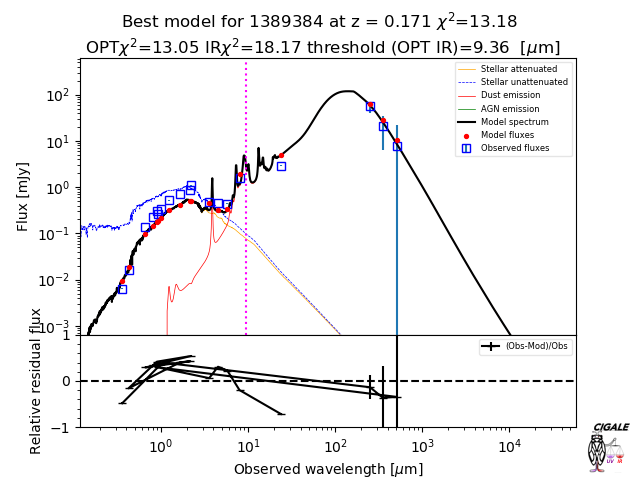

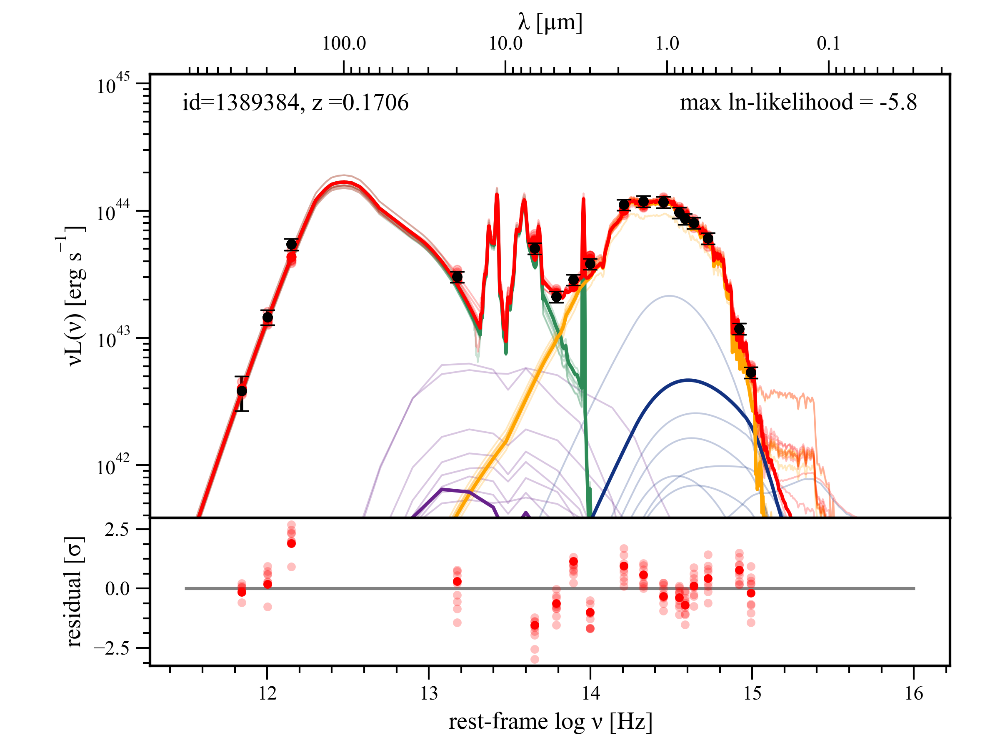

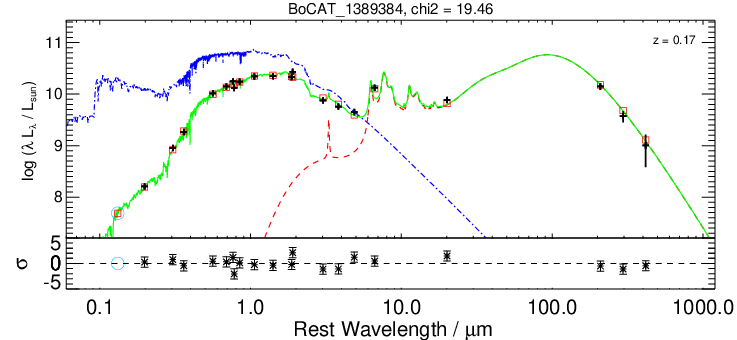

833
bigpipes reduced chi squared is: 2.9882561916883614


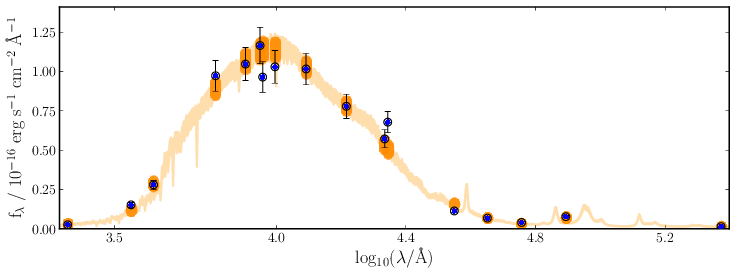

objects id is: 1389384
column ALPHA_J2000 has a value of: 217.1969834 deg
column DELTA_J2000 has a value of: 34.7216864 deg
column CLASS_STAR has a value of: 0.029999999329447746
column NUV has a value of: 0.0004413805902004242 uJy
column NUV_err has a value of: 2.1392274647951125e-05 uJy
column u has a value of: 0.006439878940582276 uJy
column u_err has a value of: 4.895235225558281e-05 uJy
column Bw has a value of: 0.01629487419128418 uJy
column Bw_err has a value of: 5.1492586731910704e-05 uJy
column R has a value of: 0.13683489990234374 uJy
column R_err has a value of: 0.00017146004736423492 uJy
column I has a value of: 0.22533628845214843 uJy
column I_err has a value of: 0.00026998427510261535 uJy
column z has a value of: 0.30848748779296875 uJy
column z_err has a value of: 0.00048521506786346436 uJy
column z_Subaru has a value of: 0.2649652099609375 uJy
column z_Subaru_err has a value of: 0.00027860188484191893 uJy
column y has a value of: 0.33681411743164064 uJy
column y_err has

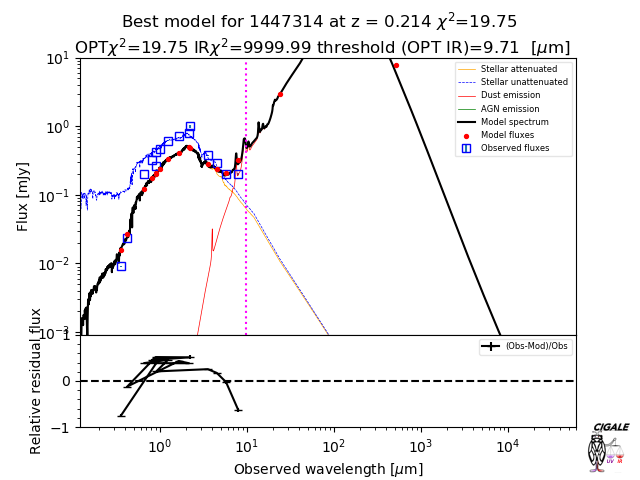

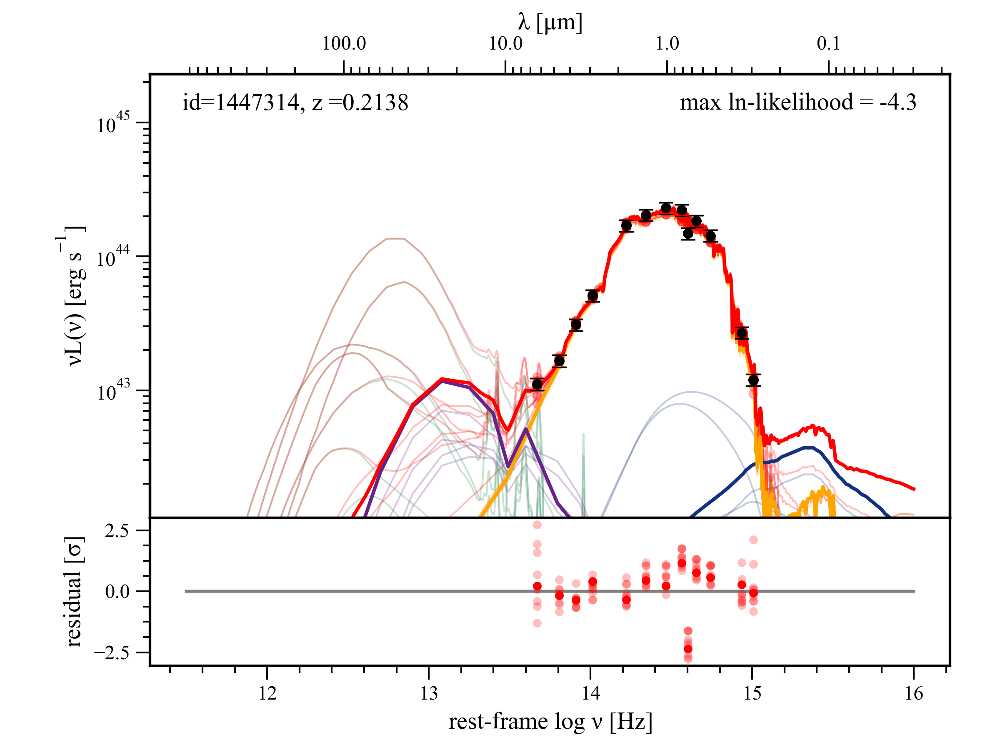

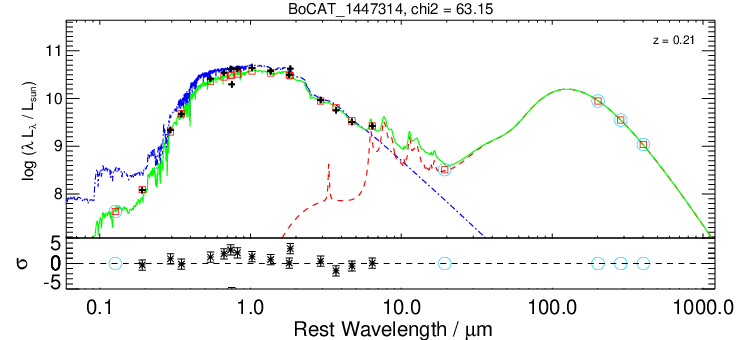

893
bigpipes reduced chi squared is: 3.3178553183178403


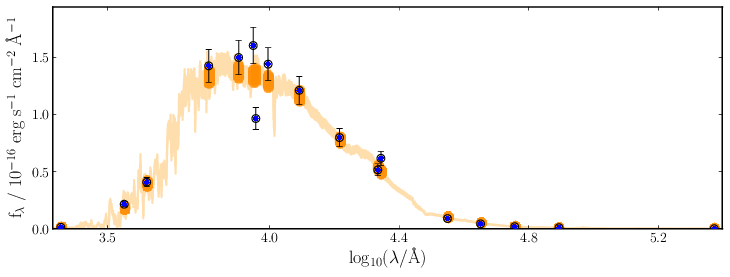

objects id is: 1447314
column ALPHA_J2000 has a value of: 217.5916497 deg
column DELTA_J2000 has a value of: 34.8267887 deg
column CLASS_STAR has a value of: 0.029999999329447746
column NUV has a value of: 0.0002287561297416687 uJy
column NUV_err has a value of: 2.892686612904072e-05 uJy
column u has a value of: 0.009092368125915528 uJy
column u_err has a value of: 7.301884889602662e-05 uJy
column Bw has a value of: 0.023762508392333983 uJy
column Bw_err has a value of: 4.496750235557556e-05 uJy
column R has a value of: 0.20051954650878906 uJy
column R_err has a value of: 0.00015138620138168335 uJy
column I has a value of: 0.32251644897460935 uJy
column I_err has a value of: 0.00045956942439079286 uJy
column z has a value of: 0.4245780944824219 uJy
column z_err has a value of: 0.0010625485181808472 uJy
column z_Subaru has a value of: 0.26501409912109375 uJy
column z_Subaru_err has a value of: 0.00028334912657737734 uJy
column y has a value of: 0.47114093017578124 uJy
column y_err has a

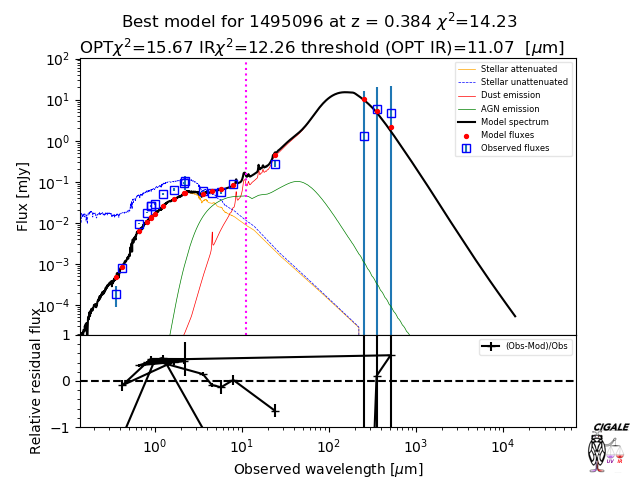

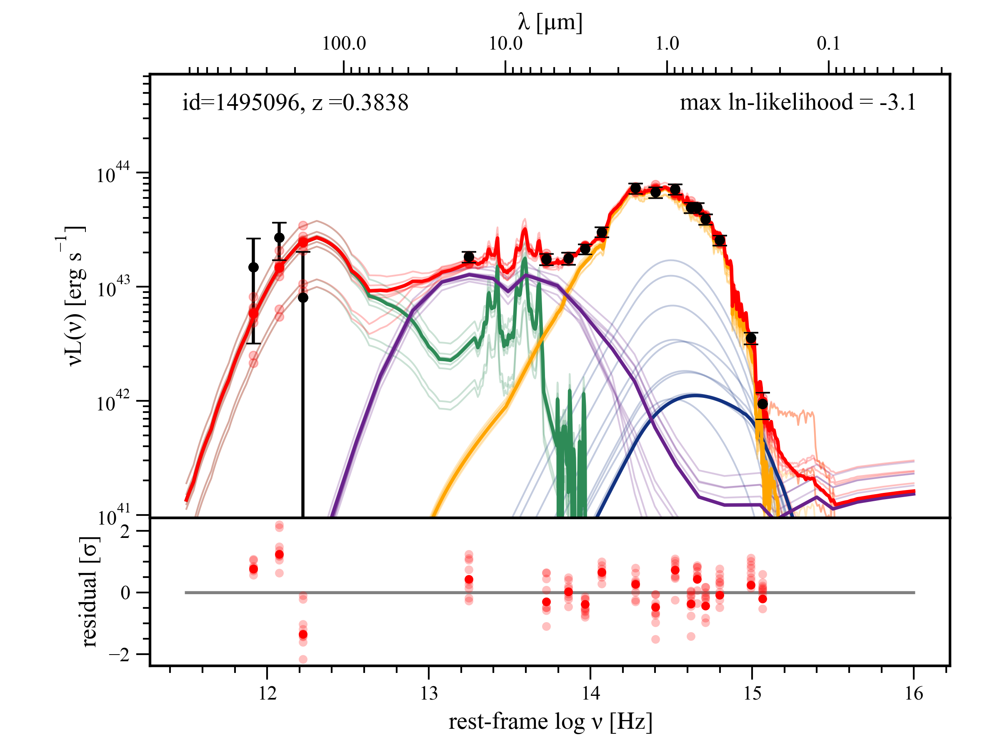

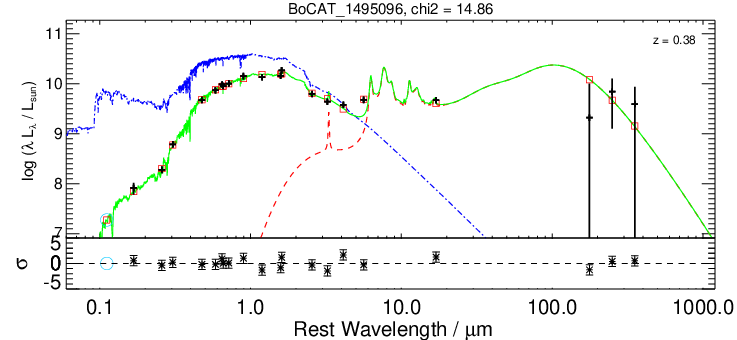

941
bigpipes reduced chi squared is: 2.093918684162381


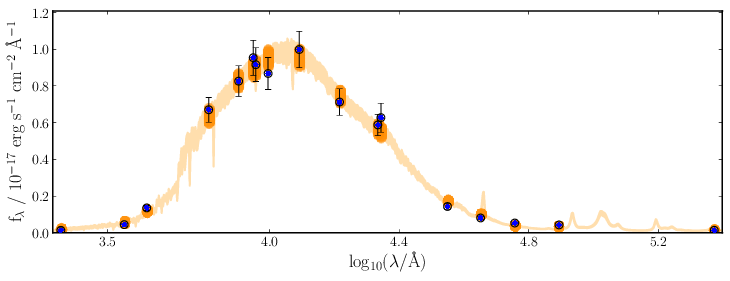

objects id is: 1495096
column ALPHA_J2000 has a value of: 217.8704962 deg
column DELTA_J2000 has a value of: 34.9144785 deg
column CLASS_STAR has a value of: 0.029999999329447746
column NUV has a value of: 2.3341741412878037e-05 uJy
column NUV_err has a value of: 2.2408831864595413e-05 uJy
column u has a value of: 0.0001878441721200943 uJy
column u_err has a value of: 3.2737378031015395e-05 uJy
column Bw has a value of: 0.0007901168465614318 uJy
column Bw_err has a value of: 3.21645587682724e-05 uJy
column R has a value of: 0.009434457778930663 uJy
column R_err has a value of: 8.921322971582412e-05 uJy
column I has a value of: 0.01779391670227051 uJy
column I_err has a value of: 0.0001625514030456543 uJy
column z has a value of: 0.025276525497436524 uJy
column z_err has a value of: 0.0005155043005943299 uJy
column z_Subaru has a value of: 0.025180761337280273 uJy
column z_Subaru_err has a value of: 0.00023047079145908355 uJy
column y has a value of: 0.028409984588623045 uJy
column y_er

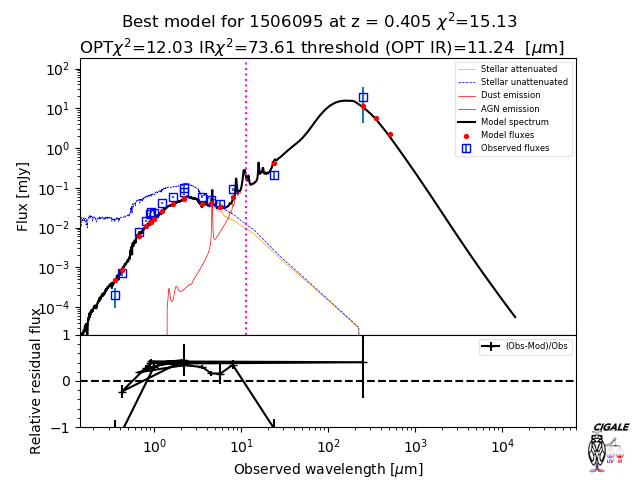

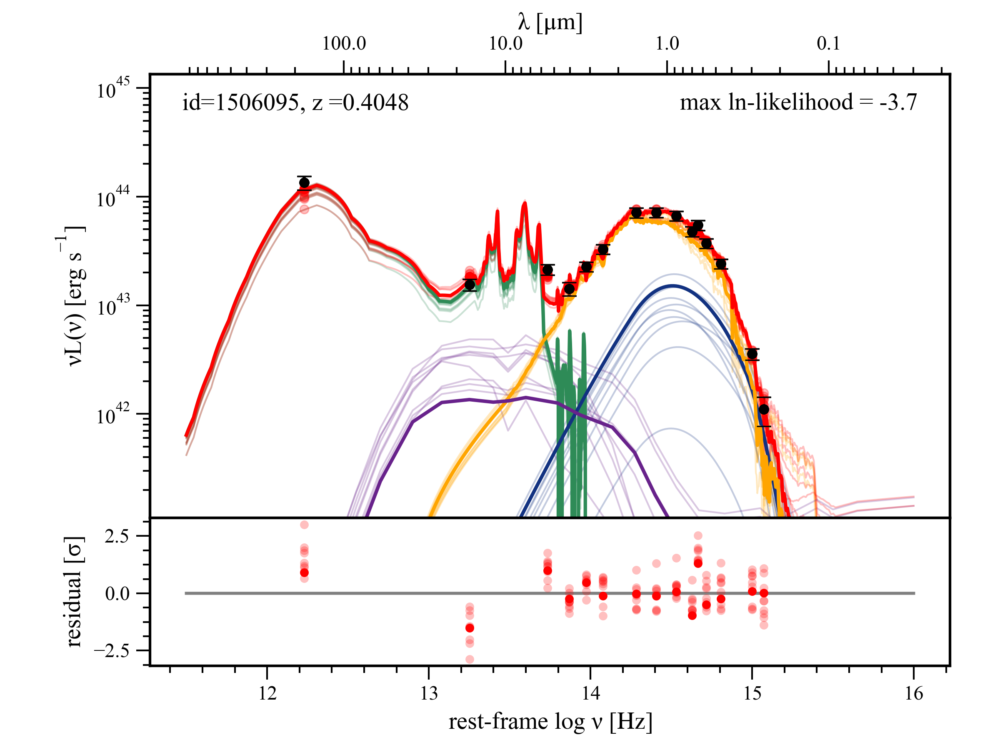

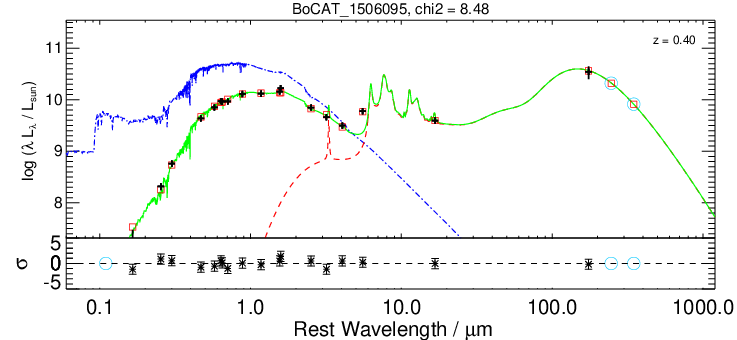

954
bigpipes reduced chi squared is: 2.4908229888323


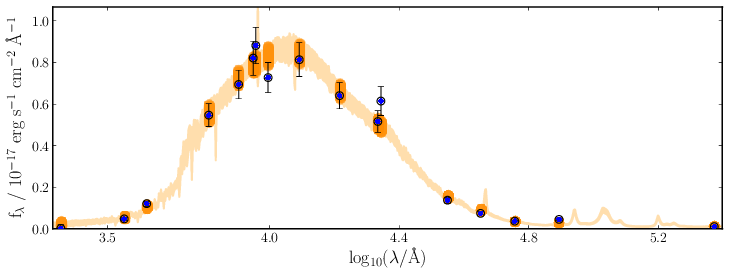

objects id is: 1506095
column ALPHA_J2000 has a value of: 217.7846925 deg
column DELTA_J2000 has a value of: 34.9347187 deg
column CLASS_STAR has a value of: 0.029999999329447746
column NUV has a value of: 2.939631463959813e-06 uJy
column NUV_err has a value of: 3.446617722511291e-05 uJy
column u has a value of: 0.00020096364617347716 uJy
column u_err has a value of: 3.597617894411087e-05 uJy
column Bw has a value of: 0.0007048418521881103 uJy
column Bw_err has a value of: 3.1669016927480696e-05 uJy
column R has a value of: 0.00769337272644043 uJy
column R_err has a value of: 0.00010079332441091538 uJy
column I has a value of: 0.014946921348571778 uJy
column I_err has a value of: 0.00030236318707466125 uJy
column z has a value of: 0.021754922866821288 uJy
column z_err has a value of: 0.0005601456761360168 uJy
column z_Subaru has a value of: 0.02423417282104492 uJy
column z_Subaru_err has a value of: 0.0004408920407295227 uJy
column y has a value of: 0.023805131912231447 uJy
column y_er

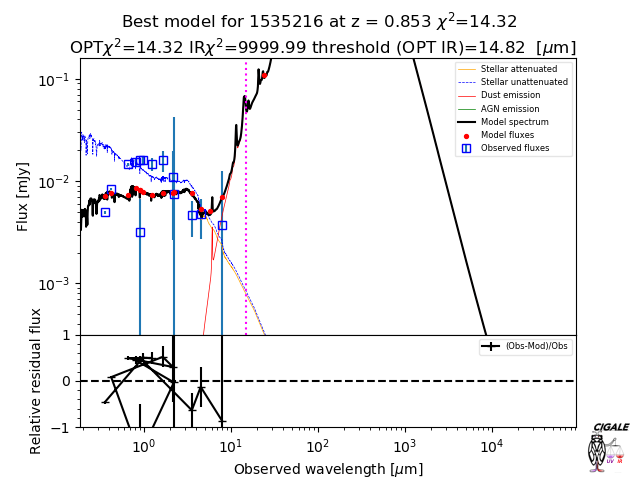

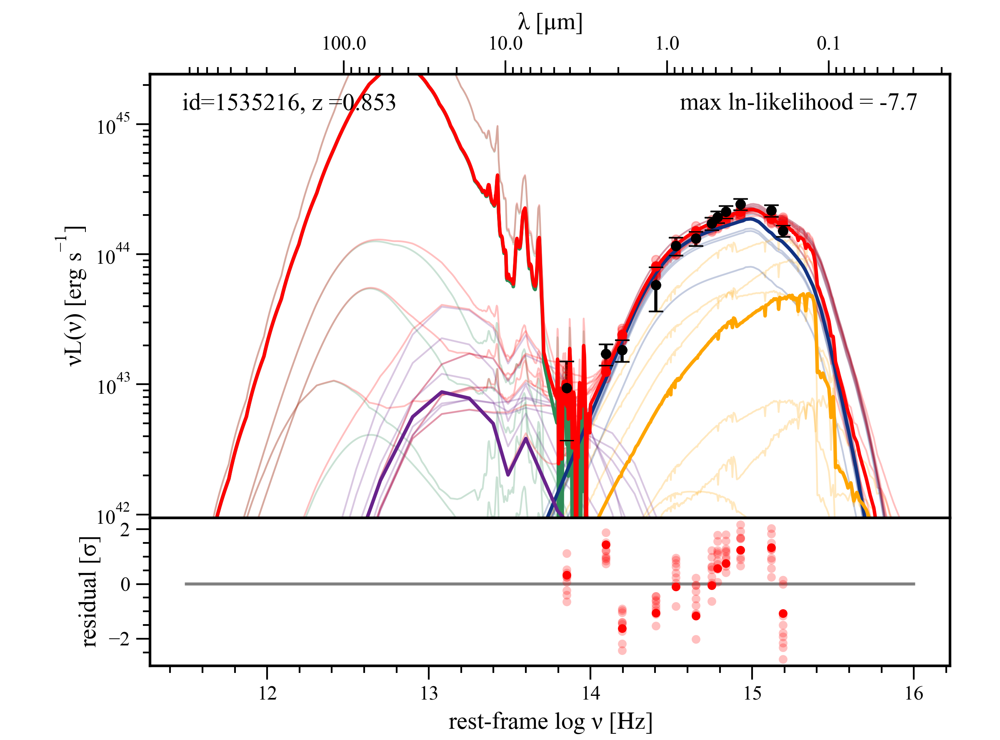

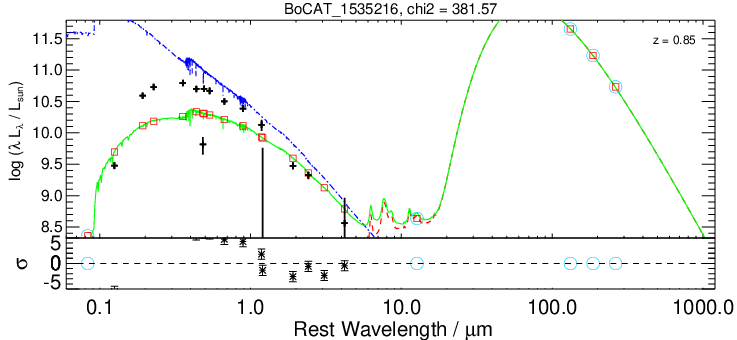

980
bigpipes reduced chi squared is: 26.942511812091954


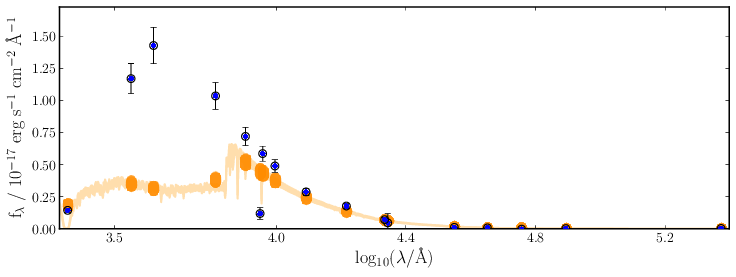

objects id is: 1535216
column ALPHA_J2000 has a value of: 217.5631567 deg
column DELTA_J2000 has a value of: 34.9896262 deg
column CLASS_STAR has a value of: 0.3199999928474426
column NUV has a value of: 0.0002468839883804321 uJy
column NUV_err has a value of: 3.128697723150253e-05 uJy
column u has a value of: 0.004951276302337646 uJy
column u_err has a value of: 5.053885653614998e-05 uJy
column Bw has a value of: 0.008321687698364258 uJy
column Bw_err has a value of: 5.837170034646988e-05 uJy
column R has a value of: 0.014558518409729004 uJy
column R_err has a value of: 0.00016988147795200348 uJy
column I has a value of: 0.01548787021636963 uJy
column I_err has a value of: 0.0004739152491092682 uJy
column z has a value of: 0.0031468632221221923 uJy
column z_err has a value of: 0.0011692721843719483 uJy
column z_Subaru has a value of: 0.01609563636779785 uJy
column z_Subaru_err has a value of: 0.00027329131960868836 uJy
column y has a value of: 0.016005531311035156 uJy
column y_err has

In [29]:
'''(cigale_bagpipes['best.reduced_chi_square']>10) & (cigale_bagpipes['best.reduced_chi_square']<20) &'''
mask = (cigale_bagpipes['bayes.agn.fracAGN']>0.5)
mask = (cigale_bagpipes['best.reduced_chi_square']>10) & (cigale_bagpipes['best.reduced_chi_square']<20)
ids = cigale_bagpipes['id'][mask]
mask = np.in1d(cigale_bagpipes['id'],ids)
for id in ids:
    maskbag = cigale_bagpipes['id']==id
    print('cigale agn fraction is: {}'.format(cigale_bagpipes['bayes.agn.fracAGN'][maskbag].quantity[0]))
    display_cigale_sed(id)
    display_agnfitter_sed(id)
    display_magphys_sed(id)
    
    
    bag_id = cigale_bagpipes[maskbag]['myid_figs'].quantity[0]
    print(bag_id)
    print('bigpipes reduced chi squared is: {}'.format(cigale_bagpipes['bagpipes_red_chisq'][maskbag].quantity[0]))
    display_bagpipes_sed(bag_id)
    
    maskid = cigale_input['id']==id
    print('objects id is: {}'.format(cigale_input['id'][maskid].quantity[0]))
    for colname in cigale_input.colnames:
        try:
            print('column {} has a value of: {}'.format(colname,cigale_input[colname][maskid].quantity[0]))
        except:()

In [30]:
photometry = Table.read('data/bootes_sed_sample_for_cigale.fits')
photometry.rename_column('ID','id')

In [34]:
results_photometry_photoz = join(fits_params_photoz,photometry,keys='id',join_type='inner')
#results_photometry_specz = join(fits_params_specz,photometry,keys='id',join_type='inner')

In [35]:

num = 0
flist = []
#print(folder_list)
for folder in folder_list:
    if '_z_' not in folder:
        continue
    fname = glob.glob(folder+'/*.fits')
    #print(fname)
    test = Table.read(fname[0])
    num = num + len(test)
    flist = flist + glob.glob(folder+'/out/*best_model.fits')
    print('number of sources cigale fits is: {}'.format(len(test)))
    print('number of cigale seds is: {}'.format(len(glob.glob(folder+'/out/*best_model.fits'))))
print(num)

number of sources cigale fits is: 9
number of cigale seds is: 9
number of sources cigale fits is: 106
number of cigale seds is: 106
number of sources cigale fits is: 51
number of cigale seds is: 51
number of sources cigale fits is: 86
number of cigale seds is: 86
number of sources cigale fits is: 65
number of cigale seds is: 65
number of sources cigale fits is: 62
number of cigale seds is: 62
number of sources cigale fits is: 54
number of cigale seds is: 54
number of sources cigale fits is: 50
number of cigale seds is: 50
number of sources cigale fits is: 57
number of cigale seds is: 57
number of sources cigale fits is: 69
number of cigale seds is: 69
number of sources cigale fits is: 54
number of cigale seds is: 54
number of sources cigale fits is: 59
number of cigale seds is: 59
number of sources cigale fits is: 29
number of cigale seds is: 29
number of sources cigale fits is: 27
number of cigale seds is: 27
number of sources cigale fits is: 25
number of cigale seds is: 25
number of 

In [38]:
add_chi = 0
for n,folder in enumerate(folder_list):
    if '_z_' not in folder:
        continue
    temp = Table.read(folder+'/out/additional_chi2',format='ascii')
    if add_chi == 0:
        add_chi = temp
    else:
        add_chi = vstack([add_chi,temp])
        
val,indx = np.unique(add_chi['col1'],return_index=True)
add_chi = add_chi[indx]
add_chi.rename_column('col1','id')
add_chi.rename_column('col2','opt_reduced_chi2')
add_chi.rename_column('col3','ir_reduced_chi2')

results_photometry_photoz = join(results_photometry_photoz,add_chi,keys='id',join_type='inner')
Table.write(results_photometry_photoz,'data/cigale_results/sample/best_fit_params_with_photometry_photoz.fits',format='fits',overwrite=True)

/its/home/im281/.conda/envs/herschelhelp/lib/python3.6/site-packages/astropy/table/table.py:2653: FutureWarning: elementwise == comparison failed and returning scalar instead; this will raise an error or perform elementwise comparison in the future.
  result = self.as_array() == other


In [39]:
results_photometry_photoz = Table.read('data/cigale_results/sample/best_fit_params_with_photometry_photoz.fits')

In [70]:
add_chi = 0
for n,folder in enumerate(folder_list):
    if '_zspec_' not in folder:
        continue
    temp = Table.read(folder+'/out/additional_chi2',format='ascii')
    if add_chi == 0:
        add_chi = temp
    else:
        add_chi = vstack([add_chi,temp])
        
val,indx = np.unique(add_chi['col1'],return_index=True)
add_chi = add_chi[indx]
add_chi.rename_column('col1','id')
add_chi.rename_column('col2','opt_reduced_chi2')
add_chi.rename_column('col3','ir_reduced_chi2')

results_photometry_specz = join(results_photometry_specz,add_chi,keys='id',join_type='inner')
Table.write(results_photometry_specz,'data/cigale_results/sample/best_fit_params_with_photometry_specz.fits',format='fits',overwrite=True)

/its/home/im281/.conda/envs/herschelhelp/lib/python3.6/site-packages/astropy/table/table.py:2653: FutureWarning: elementwise == comparison failed and returning scalar instead; this will raise an error or perform elementwise comparison in the future.
  result = self.as_array() == other


In [67]:
results_photometry_specz

id,bayes.stellar.m_star,bayes.stellar.m_star_err,bayes.sfh.sfr10Myrs,bayes.sfh.sfr10Myrs_err,bayes.dust.luminosity,bayes.dust.luminosity_err,bayes.dust.mass,bayes.dust.mass_err,bayes.dust.qpah,bayes.dust.qpah_err,bayes.dust.umin,bayes.dust.umin_err,bayes.agn.fracAGN,bayes.agn.fracAGN_err,bayes.attenuation.Av_BC,bayes.attenuation.Av_BC_err,bayes.attenuation.bessell_b,bayes.attenuation.bessell_b_err,bayes.attenuation.galex_fuv,bayes.attenuation.galex_fuv_err,bayes.attenuation.slope_BC,bayes.attenuation.slope_BC_err,bayes.attenuation.BC_to_ISM_factor,bayes.attenuation.BC_to_ISM_factor_err,bayes.attenuation.slope_ISM,bayes.attenuation.slope_ISM_err,bayes.sfh.tau_main,bayes.sfh.tau_main_err,bayes.sfh.age,bayes.sfh.age_err,bayes.sfh.burst_age,bayes.sfh.burst_age_err,bayes.sfh.f_burst,bayes.sfh.f_burst_err,best.chi_square,best.reduced_chi_square,best.agn.agn_luminosity,best.agn.beta,best.agn.fracAGN,best.agn.gamma,best.agn.luminosity,best.agn.opening_angle,best.agn.psy,best.agn.r_ratio,best.agn.scatt_luminosity,best.agn.tau,best.agn.therm_luminosity,best.attenuation.Av_BC,best.attenuation.BC_to_ISM_factor,best.attenuation.bessell_b,best.attenuation.galex_fuv,best.attenuation.slope_BC,best.attenuation.slope_ISM,best.attenuation.stellar.old,best.attenuation.stellar.young,best.dust.alpha,best.dust.gamma,best.dust.luminosity,best.dust.mass,best.dust.qpah,best.dust.umin,best.lyc_absorption_f_dust,best.lyc_absorption_f_esc,best.sfh.age,best.sfh.burst_age,best.sfh.f_burst,best.sfh.integrated,best.sfh.sfr,best.sfh.sfr100Myrs,best.sfh.sfr10Myrs,best.sfh.tau_burst,best.sfh.tau_main,best.stellar.age_m_star,best.stellar.imf,best.stellar.lum_ly,best.stellar.lum_ly_old,best.stellar.lum_ly_young,best.stellar.m_gas,best.stellar.m_gas_old,best.stellar.m_gas_young,best.stellar.m_star,best.stellar.m_star_old,best.stellar.m_star_young,best.stellar.metallicity,best.stellar.n_ly,best.stellar.n_ly_old,best.stellar.n_ly_young,best.stellar.old_young_separation_age,best.universe.age,best.universe.luminosity_distance,best.universe.redshift,best.u,best.y,best.I,best.K,best.z,best.Bw,best.H,best.Ks,best.R,best.J,best.F250,best.F350,best.F500,best.z_Subaru,best.ch1,best.ch2,best.ch3,best.ch4,best.F24,ALPHA_J2000,DELTA_J2000,CLASS_STAR,NUV,NUV_err,u,u_err,Bw,Bw_err,R,R_err,I,I_err,z,z_err,z_Subaru,z_Subaru_err,y,y_err,J,J_err,H,H_err,K,K_err,Ks,Ks_err,ch1,ch1_err,ch2,ch2_err,ch3,ch3_err,ch4,ch4_err,24,24_err,ID_OPTICAL,FUV,FUV_err,ID_SPITZER,z_spec,Sv_150,Sverr_150,VClass,radio,EBV,redshift,xID24_ID,F24,F250,F250_err,F350,F350_err,F500,F500_err,index_spitzer,gID,gSize,Source_id,Isl_id,RA,E_RA,DEC,E_DEC,Total_flux,E_Total_flux,Peak_flux,E_Peak_flux,RA_max,E_RA_max,DEC_max,E_DEC_max,Maj,E_Maj,Min,E_Min,PA,E_PA,Maj_img_plane,E_Maj_img_plane,Min_img_plane,E_Min_img_plane,PA_img_plane,E_PA_img_plane,DC_Maj,E_DC_Maj,DC_Min,E_DC_Min,DC_PA,E_DC_PA,DC_Maj_img_plane,E_DC_Maj_img_plane,DC_Min_img_plane,E_DC_Min_img_plane,DC_PA_img_plane,E_DC_PA_img_plane,Isl_Total_flux,E_Isl_Total_flux,Isl_rms,Isl_mean,Resid_Isl_rms,Resid_Isl_mean,S_Code,lr_i,lr_dist_i,lr_index_i,opt_reduced_chi2,ir_reduced_chi2
,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,mJy,mJy,mJy,mJy,mJy,mJy,mJy,mJy,mJy,mJy,mJy,mJy,mJy,mJy,mJy,mJy,mJy,mJy,mJy,deg,deg,,uJy,uJy,uJy,uJy,uJy,uJy,uJy,uJy,uJy,uJy,uJy,uJy,uJy,uJy,uJy,uJy,uJy,uJy,uJy,uJy,uJy,uJy,uJy,uJy,uJy,uJy,uJy,uJy,uJy,uJy,uJy,uJy,uJy,uJy,,uJy,uJy,,,,,,,,,,uJy,mJy,mJy,mJy,mJy,mJy,mJy,,,,,,deg,deg,deg,deg,Jy,Jy,Jy / beam,Jy / beam,deg,deg,deg,deg,deg,deg,deg,deg,deg,deg,deg,deg,deg,deg,deg,deg,deg,deg,deg,deg,deg,deg,deg,deg,deg,deg,deg,deg,Jy,Jy,Jy / beam,Jy / beam,Jy / beam,Jy / beam,,,,,,
int64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,

In [18]:
ids = []
for name in flist:
    ids.append(int(name[41:-16]))
    #ids.append(name[27:-27])
ids = np.array(ids)
len(np.unique(ids))

989

In [ ]:
table = Table.read(flist[0])

x = np.log10(table['wavelength'])
y = np.log10(table['L_lambda_total'])
plt.plot(x,y,c='black')

y = np.log10(table['dust.Umin_Umax'])
plt.plot(x,y,c='orange')

y = np.log10(table['stellar.old']+table['attenuation.stellar.old'])
plt.plot(x,y,c='red')

y = np.log10(table['stellar.young']+table['attenuation.stellar.young'])
plt.plot(x,y,c='blue')

y = np.log10(table['agn.fritz2006_agn'])
plt.plot(x,y,c='purple')

x = np.log10(table['wavelength'])
y = np.log10(table['L_lambda_total'])
plt.plot(x,y,c='black')

plt.xlim(2,6)
mask = (y>0) & (y<99)
print(min(y[mask]))
plt.ylim(np.nanmin(y[mask])+10,np.nanmax(y)+1)

In [ ]:
for file in flist[:1]:
    
    #mask = file[4:-16]
    #phot = sed_sample_phot[mask]
    
    table = Table.read(file)
    
    x = np.log10(table['wavelength'])
    y = np.log10(table['L_lambda_total'])
    plt.plot(x,y,c='black')

    y = np.log10(table['dust.Umin_Umax'])
    plt.plot(x,y,c='orange')

    y = np.log10(table['stellar.old']+table['attenuation.stellar.old'])
    plt.plot(x,y,c='red')

    y = np.log10(table['stellar.young']+table['attenuation.stellar.young'])
    plt.plot(x,y,c='blue')

    y = np.log10(table['agn.fritz2006_therm'])
    plt.plot(x,y,c='purple')
    y = np.log10(table['agn.fritz2006_scatt'])
    plt.plot(x,y,c='purple')
    y = np.log10(table['agn.fritz2006_agn'])
    plt.plot(x,y,c='purple')
    y = np.log10(table['agn.fritz2006_agn'] + table['agn.fritz2006_scatt'] + table['agn.fritz2006_therm'])
    plt.plot(x,y,c='cyan')
    
    x = np.log10(table['wavelength'])
    y = np.log10(table['L_lambda_total'])
    plt.plot(x,y,c='black')

    plt.xlim(2,6)
    plt.ylim(25,36)
    plt.show()

In [113]:
mask = (results_photometry_agn_frac['best.reduced_chi_square']>8) & (results_photometry_agn_frac['agn_frac_nir']>0)

for id in results_photometry_agn_frac['id'][mask]:
    print(id)
    for folder in folder_list:
        if '_z_' not in folder:
            continue
        file = folder+'/out/{}_best_model.fits'.format(id)
        try:
            display_sed(file[:-16],_)
        except:()



NameError: name 'results_photometry_agn_frac' is not defined

In [41]:
bins = np.arange(0,1.0,0.05)
plt.hist(results_photometry_photoz['bayes.agn.fracAGN'],log=True,bins=bins)
plt.hist(results_photometry_photz['best.agn.fracAGN'],log=True,bins=bins,alpha=0.4)
plt.xlabel('AGN fraction')
plt.legend(['bayes','best'])
plt.show()

NameError: name 'results_photometry_photz' is not defined

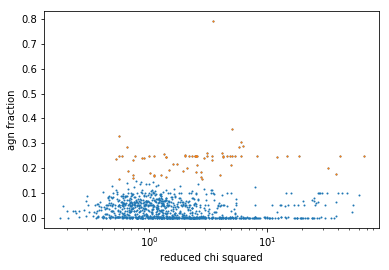

In [73]:
x = results_photometry_photoz['best.reduced_chi_square']
y = results_photometry_photoz['bayes.agn.fracAGN']
plt.scatter(x,y,s=1)

mask = results_photometry_photoz['bayes.agn.fracAGN']>0.15
x = results_photometry_photoz['best.reduced_chi_square'][mask]
y = results_photometry_photoz['bayes.agn.fracAGN'][mask]
plt.scatter(x,y,s=1)

plt.xscale('log')
plt.xlabel('reduced chi squared')
plt.ylabel('agn fraction')

plt.show()

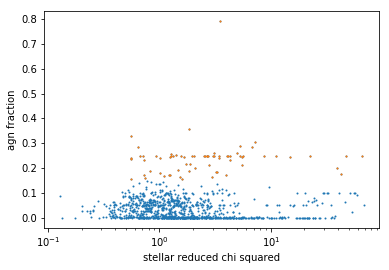

In [75]:
x = results_photometry_photoz['opt_reduced_chi2_1']
y = results_photometry_photoz['bayes.agn.fracAGN']
plt.scatter(x,y,s=1)

mask = results_photometry_photoz['bayes.agn.fracAGN']>0.15
x = results_photometry_photoz['opt_reduced_chi2_1'][mask]
y = results_photometry_photoz['bayes.agn.fracAGN'][mask]
plt.scatter(x,y,s=1)

plt.xscale('log')
plt.xlabel('stellar reduced chi squared')
plt.ylabel('agn fraction')

plt.show()

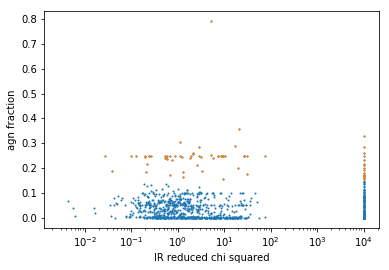

In [76]:
x = results_photometry_photoz['ir_reduced_chi2_1']
y = results_photometry_photoz['bayes.agn.fracAGN']
plt.scatter(x,y,s=1)

mask = results_photometry_photoz['bayes.agn.fracAGN']>0.15
x = results_photometry_photoz['ir_reduced_chi2_1'][mask]
y = results_photometry_photoz['bayes.agn.fracAGN'][mask]
plt.scatter(x,y,s=1)

plt.xscale('log')
plt.xlabel('IR reduced chi squared')
plt.ylabel('agn fraction')

plt.show()

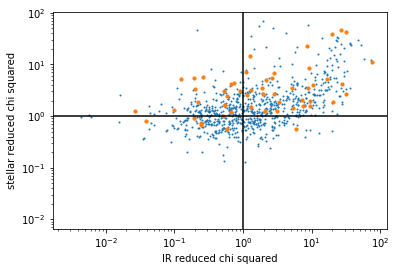

In [88]:
mask = (results_photometry_photoz['ir_reduced_chi2_1']<1000)
x = results_photometry_photoz['ir_reduced_chi2_1'][mask]
y = results_photometry_photoz['opt_reduced_chi2_1'][mask]
plt.scatter(x,y,s=1)

mask = (results_photometry_photoz['bayes.agn.fracAGN']>0.15) & (results_photometry_photoz['ir_reduced_chi2_1']<1000)
x = results_photometry_photoz['ir_reduced_chi2_1'][mask]
y = results_photometry_photoz['opt_reduced_chi2_1'][mask]
plt.scatter(x,y,s=10)

plt.axhline(1,color='black')
plt.axvline(1,color='black')

plt.xscale('log')
plt.yscale('log')
plt.xlabel('IR reduced chi squared')
plt.ylabel('stellar reduced chi squared')

plt.show()

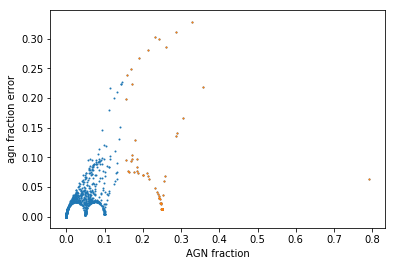

In [91]:
x = results_photometry_photoz['bayes.agn.fracAGN']
y = results_photometry_photoz['bayes.agn.fracAGN_err']
plt.scatter(x,y,s=1)

mask = results_photometry_photoz['bayes.agn.fracAGN']>0.15
x = results_photometry_photoz['bayes.agn.fracAGN'][mask]
y = results_photometry_photoz['bayes.agn.fracAGN_err'][mask]
plt.scatter(x,y,s=1)

#plt.xscale('log')
plt.xlabel('AGN fraction')
plt.ylabel('agn fraction error')

plt.show()

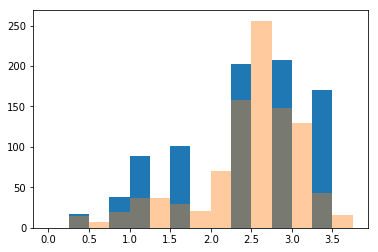

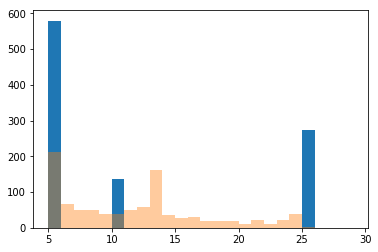

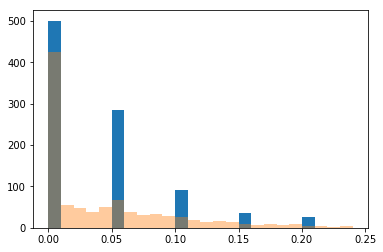

In [40]:
bins=np.arange(0,4,0.25)
y = results_photometry_photoz['best.attenuation.Av_BC']
plt.hist(y,bins=bins)

y = results_photometry_photoz['bayes.attenuation.Av_BC']
plt.hist(y,alpha=0.4,bins=bins)
plt.show()

bins=np.arange(5,30,1)
y = results_photometry_photoz['best.dust.umin']
plt.hist(y,bins=bins)

y = results_photometry_photoz['bayes.dust.umin']
plt.hist(y,alpha=0.4,bins=bins)
plt.show()

bins=np.arange(0,0.25,0.01)
y = results_photometry_photoz['best.agn.fracAGN']
plt.hist(y,bins=bins)

y = results_photometry_photoz['bayes.agn.fracAGN']
plt.hist(y,alpha=0.4,bins=bins)
plt.show()

In [99]:
temp_file

id,bayes.stellar.m_star,bayes.stellar.m_star_err,bayes.sfh.sfr10Myrs,bayes.sfh.sfr10Myrs_err,bayes.dust.luminosity,bayes.dust.luminosity_err,bayes.dust.mass,bayes.dust.mass_err,bayes.dust.qpah,bayes.dust.qpah_err,bayes.dust.umin,bayes.dust.umin_err,bayes.agn.fracAGN,bayes.agn.fracAGN_err,bayes.attenuation.Av_BC,bayes.attenuation.Av_BC_err,bayes.attenuation.bessell_b,bayes.attenuation.bessell_b_err,bayes.attenuation.galex_fuv,bayes.attenuation.galex_fuv_err,bayes.attenuation.slope_BC,bayes.attenuation.slope_BC_err,bayes.attenuation.BC_to_ISM_factor,bayes.attenuation.BC_to_ISM_factor_err,bayes.attenuation.slope_ISM,bayes.attenuation.slope_ISM_err,bayes.sfh.tau_main,bayes.sfh.tau_main_err,bayes.sfh.age,bayes.sfh.age_err,bayes.sfh.burst_age,bayes.sfh.burst_age_err,bayes.sfh.f_burst,bayes.sfh.f_burst_err,best.chi_square,best.reduced_chi_square,best.agn.agn_luminosity,best.agn.beta,best.agn.fracAGN,best.agn.gamma,best.agn.luminosity,best.agn.opening_angle,best.agn.psy,best.agn.r_ratio,best.agn.scatt_luminosity,best.agn.tau,best.agn.therm_luminosity,best.attenuation.Av_BC,best.attenuation.BC_to_ISM_factor,best.attenuation.bessell_b,best.attenuation.galex_fuv,best.attenuation.slope_BC,best.attenuation.slope_ISM,best.attenuation.stellar.old,best.attenuation.stellar.young,best.dust.alpha,best.dust.gamma,best.dust.luminosity,best.dust.mass,best.dust.qpah,best.dust.umin,best.lyc_absorption_f_dust,best.lyc_absorption_f_esc,best.sfh.age,best.sfh.burst_age,best.sfh.f_burst,best.sfh.integrated,best.sfh.sfr,best.sfh.sfr100Myrs,best.sfh.sfr10Myrs,best.sfh.tau_burst,best.sfh.tau_main,best.stellar.age_m_star,best.stellar.imf,best.stellar.lum_ly,best.stellar.lum_ly_old,best.stellar.lum_ly_young,best.stellar.m_gas,best.stellar.m_gas_old,best.stellar.m_gas_young,best.stellar.m_star,best.stellar.m_star_old,best.stellar.m_star_young,best.stellar.metallicity,best.stellar.n_ly,best.stellar.n_ly_old,best.stellar.n_ly_young,best.stellar.old_young_separation_age,best.universe.age,best.universe.luminosity_distance,best.universe.redshift,best.u,best.y,best.I,best.K,best.z,best.Bw,best.H,best.Ks,best.R,best.J,best.F250,best.F350,best.F500,best.z_Subaru,best.ch1,best.ch2,best.ch3,best.ch4,best.F24
,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,mJy,mJy,mJy,mJy,mJy,mJy,mJy,mJy,mJy,mJy,mJy,mJy,mJy,mJy,mJy,mJy,mJy,mJy,mJy
int64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64
325729,35282728013.1,3987246912.66,7.16143067125,1.26588549778,2.9993808391e+37,1.84607157844e+36,1.51056724205e+38,3.15321954079e+37,0.47,0.0235,5.81351841127,1.99126533596,0.0,0.0,2.00842846088,0.887390886643,1.2309671303,0.0725313506362,3.24230298091,0.162115149045,-0.7,0.0,0.557666085419,0.237891140203,-0.7,0.0,3000.0,150.0,7721.21924478,692.904097876,68.9964488972,30.996719442,0.00103413367805,0.000553207008664,15.4149870019,1.18576823092,0.0,-0.5,0.0,0.0,0.0,100.0,0.001,60.0,0.0,1.0,0.0,1.2,0.8,1.24760357746,3.25105437591,-0.7,-0.7,1.69135762648e+37,1.29859817439e+37,2.0,0.02,2.98995580087e+37,1.63250795429e+38,0.47,5.0,0.0,0.0,8000.0,50.0,0.001,66754252082.1,6.86013419585,6.25311745969,6.8659182987,10000.0,3000.0,3863.26972072

In [ ]:
y = temp_file['best.']